
# Práctica 4: Metaheurísticas basadas en poblaciones - Sistemas de Colonias de Hormigas

<center><h3>
    Pedro López-Chaves Pérez
</h3></center>


## Instrucciones

Esto es **Jupyter Notebook**, un documento que integra código Python en un archivo Markdown.
Esto nos permite ir ejecutando celdas de código poco a poco, así como generar automáticamente un informe bien formateado de la práctica.

Puedes añadir una celda con el botón **"Insert"** de la barra de herramentas, y cambiar su tipo con **"Cell > Cell Type"**

Para ejecutar una celda de código, la seleccionaremos y pulsaremos el botón **"▶ Run"** de la barra de herramentas.
Para pasar el documento a HTML, seleccionaremos **"File > Download as > HTML (.html)"**

Sigue este guión hasta el final. Ejecuta el código proporcionado paso a paso comprendiendo lo que estás haciendo y reflexionando sobre los resultados. Habrá preguntas intercaladas a lo largo del guión, responde a todas ellas en la sección reservada para ese fin: **"Respuestas a los cuestionarios"**. Por favor, no modifiques ninguna linea de código excepto cuando se te pida explícitamente.

No olvides insertar tu **nombre y apellidos** en la celda superior.

IMPORTANTE: Escribe el código de tu o tus soluciones/respuestas en las celdas que se indican para ello. Además, a lo largo de la práctica se plantearán varias preguntas que debéis responder en la parte inferior del documento, incluyendo las celdas que veáis necesarias (si hacéis referencia a partes concretas de vuestro código, etc) para reponder a ellas.

## Entrega de la práctica

La fecha límite de entrega será la indicada en el Campus Virtual. La entrega consistirá de un único archivo comprimido con nombre `APELIDOS_NOME_Colonias.zip` que contenga los seguientes ficheros:

 * `APELIDOS_NOME_Colonias.html`: Archivo HTML fruto de la exportación del presente Notebook, con las preguntas respondidas al final del documento.
 * `APELIDOS_NOME_Colonias.ipynb`: Archivo fuente Jupyter Notebook.
 * Archivo de datos de los problema utilizados en la resolución.

## El Problema del Viajante de Comercio (VC) con Sistemas de Colonias de Hormigas

El objetivo de esta práctica es modelar e implementar un agente inteligente que sea capaz de resolver
el problema del VC mediante la metaheurística (MH) de algoritmos para sistemas de colonias de
hormigas (ACS, *Ant Colony Systems*, del inglés).

Para ello, realizarás una implementación del algoritmo básico visto en la clase expositiva y valorarás algunos de los parámetros de diseño del algoritmo en relación a la calidad de las soluciones alcanzadas.

Recuerda que debes importar el módulo Python que acompaña esta práctica, que como ocurría en prácticas anteriores implementa la carga de datos y el cálculo de distancias utilizando una matriz de adyacencia de acuerdo a la definición del problema ya vista.

In [19]:
from helpers_mod_aco import *

g1=Localizaciones(filename='./data/grafo8cidades.txt')
g2=Localizaciones(filename='./data/US120.txt')
g3=Localizaciones(filename='./data/test.txt')

# distancia entre ciudad 0 y 1 son unos 55 km
print (g1.distancia(0,1))

55.88273580792048



## P4.1: Implementación de Sistemas de Colonias de Hormigas (SCH)


Implementa el algoritmo de sistemas de colonia de hormigas que materializa la MH vista en la sesión expositiva y revisa las notas particulares para el problema de VC. Para facilitar vuestra labor, se os proporciona aquí una descripción algorítmica de referencia.


&nbsp;&nbsp;&nbsp;&nbsp;1. Establecer parámetros: $G, m, q_{0}, \tau_{0}, \rho, \xi, iter_{min}, iter_{max}, iter_{sinmejoras}, ratio_{mejora}$

&nbsp;&nbsp;&nbsp;&nbsp;2. Inicializar pistas de feromonas: $\forall (i, j)  \tau_{ij} = \tau_{0}$

&nbsp;&nbsp;&nbsp;&nbsp;3. HACER
        
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.1. PARA cada hormiga $k$ en colonia m HACER
    
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.1.1.construir una solución para $k$ siguiendo la regla de decisión a cada paso:
$$ j=\begin{cases}argmax_{l\in N_i^k} \{ [\tau_{il}]^\alpha [\eta_{il}]^\beta \}, \text{if } q \leq q_0; \\ J, \text{en otro caso;}\end{cases}
$$,
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;donde $J$ es la exploración dirigida por: 

$$ p_{ij}^{k} = \frac{[\tau_{ij}]^\alpha [\eta_{ij}]^\beta}{\sum_{l\in N_i^k} [\tau_{il}]^\alpha [\eta_{il}]^\beta}, \text{if } j\in N_i^k 
$$    

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.1.2. (opcional) Aplicar actualización de feromona local/online con la regla:
$$ \tau_{ij} \leftarrow (1 - \xi) \tau_{ij} + \xi \tau_{0}$$
     
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.2. FIN PARA
   
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.3. Evalúa soluciones en la colonia m y registrar la mejor solución hasta el momento $T^{bs}$
    
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.4. Aplicar actualización de feromona global/offline con la regla: $$\tau_{ij} \leftarrow (1-\rho) \tau_{ij} + \rho \Delta\tau_{ij}^{bs}, \forall(i, j) \in T^{bs}$$
    

&nbsp;&nbsp;&nbsp;&nbsp;4. HASTA cumplir la condición de parada




La implementación debe permitir la inicialización de los parámetros y estructuras de información asociadas como sigue:
- G es la estructura de grafo que permite calcular distancias entre ciudades sobre una instancia del problema dada (e.g., fichero de localizaciones).
- Probabilidad de explotación $q_{0}=0.5$.
- Inicialización de la información heurística: $\eta_{ij}=1/d_{ij}, \forall (i, j)$, donde $d_{ij}$ es la distancia directa entre las ciudades *i* y *j*.
- Inicialización de las pistas de feromonas (depósito inicial): $\tau_{ij}= \tau_{0}= 1 /(n C^{NN}) \forall (i, j)$ donde n es el número de ciudades y $C^{NN}$ es el coste del tour generado siguiendo una estrategia voraz del vecino más próximo (NN, *Nearest Neighbour*).
- Parámetros de influencia de las pistas de feromonas ($\alpha$) e información heurística ($\beta$) en la regla de decisión establecidos a 1 y 3 respectivamente 
- Ratio de evaporación de feromona: deberás probar con diferentes magnitudes (p.ej., $\rho=0.01$, $\rho=0.1$ y $\rho=0.5$)
- Actualización de feromona global con depósito elitista basado en la mejor solución (bs, *best solution*):
    $\tau_{ij} \leftarrow (1-\rho) \tau_{ij} + \rho \Delta\tau_{ij}^{bs}, \forall (i, j) \in T^{bs}, donde \Delta\tau_{ij}^{bs}=1/C^{bs}$
- Actualización de feromona local siguiendo la regla:
    $\tau_{ij} \leftarrow (1- \xi) \tau_{ij} + \xi \tau_{0}, con  \xi=0.1$
- Condición de parada que de manera combinada tenga en cuenta $iter_{min}$, $iter_{max}$, $iter_{sinmejoras}$, $ratio_{mejora}$
- La implementación debe ser completamente parametrizable, de forma que todos los componentes susceptibles de ser ajustados mediante parámetros puedan ser establecidos en cada ejecución/problema, y que puedas modificar la inicialización heurística y de pistas de feromona, puedas fácilmente reemplazar las reglas de actualización de feromonas, activar/desactivar la actualización local de actualización de feromona, etc.

In [ ]:
def explotacion(por_visitar, ciudad_actual, alpha, beta, nij, tij):
    por_visitar_prob = []
    
    # Para cada ciudad por visitar almacenamos el valor de probabilidad de la explotacion
    for i in por_visitar:
        por_visitar_prob.append((i, (tij[ciudad_actual][i] ** alpha) * (nij[ciudad_actual][i] ** beta)))
    
    #reordenamos las ciudades de mayor a menor probabilidad de ser elegidas
    por_visitar_prob = sorted(por_visitar_prob, key=itemgetter(1), reverse=True)
    
    #devolvemos la primera de la lista ordenada
    return por_visitar_prob[len(por_visitar_prob) - 1][0]

Prueba tu implementación tomando instancias de problemas que has utilizado en prácticas anteriores. Lanza varias ejecuciones para verificar que puede resolver el problema con los problemas de las 8 ciudades gallegas (`data/grafo8cidades.txt`) y de las 120 ciudades estadounidenses (`data/US120.txt`).


In [2]:
from tqdm.notebook import trange, tqdm
from operator import itemgetter
import random
from random import randint

In [53]:
#funcion de coste utilizada
def coste(grafo, camino):
    costo_total = grafo.distancia(0, camino[0]) + grafo.distancia(camino[-1], 0)
    costo_total += sum(grafo.distancia(camino[i], camino[i+1]) for i in range(len(camino)-1))
    print("Aqui nada")
    return costo_total

In [54]:
#inicializa la matriz nij con el inverso de las distancias entre ciudaddes
def inicializar_matriz_nij(grafo):
    # Inicializar la matriz nij con valores predeterminados
    matriz_nij = []
    
    #inicializamos la matriz con todos los valores a 0
    for _ in range(grafo.nciudades):
        fila = [0.0] * grafo.nciudades
        matriz_nij.append(fila)
    
    # Llenar la matriz nij con el inverso de las distancias
    for ciudad1 in range(grafo.nciudades):
        for ciudad2 in range(ciudad1 + 1, grafo.nciudades):
            distancia_ciudad1_ciudad2 = grafo.distancia(ciudad1, ciudad2)
            matriz_nij[ciudad1][ciudad2] = 1 / distancia_ciudad1_ciudad2
            matriz_nij[ciudad2][ciudad1] = 1 / distancia_ciudad1_ciudad2
    
    return matriz_nij

In [62]:
#algoritmo voraz del vecino más cercano
def vecino_mas_cercano(grafo):
    sol = []
    for _ in range(0, grafo.nciudades-1):
        mejor_punto, mejor_coste = None, None
        for i in range(1, grafo.nciudades):
            if i in sol:
                continue
                
            #si sol esta vacia, es que partimos del 0
            if(not sol):
                c = grafo.distancia(0, i)
            else:
                c = grafo.distancia(sol[len(sol) - 1], i)
            #almacenamos el mejor resultado    
            if not mejor_punto or c < mejor_coste:
                mejor_punto, mejor_coste = i, c
                
        #añadimos la ciudad más cercana
        sol.append(mejor_punto)
    return sol

print(vecino_mas_cercano(g3))
print(coste(g3,vecino_mas_cercano(g3)))

#inicializa la matriz de feromonas dandoles a todas el mismo valor
def inicializar_tij(grafo):
    tij=[]
    #valor inicial
    t0 = 1 / (coste(grafo, vecino_mas_cercano(grafo)) * grafo.nciudades)
    print(t0)
    #relleamos la matriz
    for _ in range(grafo.nciudades):
        fila = []
        for _ in range(grafo.nciudades):
            fila.append(t0)
        tij.append(fila)
    return tij

a=inicializar_tij(g3)

[10, 22, 13, 2, 8, 4, 16, 18, 3, 28, 27, 7, 19, 20, 9, 25, 17, 23, 24, 21, 11, 14, 26, 12, 15, 5, 29, 6, 1]
Aqui nada
15991.93112533632
Aqui nada
2.0843844981624954e-06


In [57]:
#buscar siguiente punto a partir de las feromonas
def explotacion(por_visitar, ciudad_actual, alpha, beta, nij, tij):
    por_visitar_prob = []
    
    # Para cada ciudad por visitar almacenamos el valor de probabilidad de la explotacion
    for i in por_visitar:
        por_visitar_prob.append((i, (tij[ciudad_actual][i] ** alpha) * (nij[ciudad_actual][i] ** beta)))
    
    #reordenamos las ciudades de mayor a menor probabilidad de ser elegidas
    por_visitar_prob = sorted(por_visitar_prob, key=itemgetter(1), reverse=True)
    print("********************\n",por_visitar_prob,"\n\n\n ")
    print(por_visitar_prob[len(por_visitar_prob) - 1][0])
    #devolvemos la primera de la lista ordenada
    return por_visitar_prob[len(por_visitar_prob) - 1][0]

#buscar la solucion a partir de la aleatoriedad y feromonas
def exploracion_dirigida(por_visitar, ciudad_actual, alpha, beta, nij, tij):
    
    # calculamos el sumatorio, que es el divisor de la formula
    sumatorio=0
    for i in por_visitar:
        sumatorio+=(tij[ciudad_actual][i] ** alpha) * (nij[ciudad_actual][i] ** beta)
        
    por_visitar_prob = []
    #realizamos el calculo
    for i in por_visitar:
        por_visitar_prob.append((i, ((tij[ciudad_actual][i] ** alpha) * (nij[ciudad_actual][i] ** beta)) / sumatorio))
        
    #Reordenamos las ciudades por visitar para que nos muestre de mas probabilidad a menos
    por_visitar_prob = sorted(por_visitar_prob, key=itemgetter(1), reverse=True)
    print("********************\n",por_visitar_prob,"\n\n\n ")

    # generamos una probabilidad que nos dirá cuando aceptamos la ciudad
    prob = random.uniform(0, 1)
    solucion, sumatorio_prob = None, 0
    for i in por_visitar_prob:
        # Sumamos la probabilidad y almacenamos en j la ciudad
        sumatorio_prob += i[1]
        solucion = i[0]
        # si el sumatorio supera/iguala a la probabilidad calculada, nos quedamos con esa ciudad
        if sumatorio_prob >= prob:
            break
            
    return solucion

In [70]:
#calculamos las soluciones para cada hormiga
def obtener_soluciones(num_hormigas, num_ciudades, q0, alpha, beta, nij, tij):
    soluciones = []
    for k in range(num_hormigas):
        solucion=[]
        
        # Se almacenan las ciudades por visitar de cada hormiga
        por_visitar = list(range(1, num_ciudades))
        
        # Se itera mientras queden ciudades por visitar
        while len(por_visitar) > 0:
            
            #obtenemos la ciudad en la que nos encontramos, cogemos la 0 si esta vacía la lista
            if not solucion:
                ciudad_actual=0
            else:
                ciudad_actual = solucion[len(solucion) - 1]
            
            #seleccionamos la manera de encontrar la siguiente ciudad
            #if random.uniform(0, 1) < q0:
            #j = explotacion(por_visitar, ciudad_actual, alpha, beta, nij, tij)
            #if(k==0):
                #print(j)
            #else:
            j = exploracion_dirigida(por_visitar, ciudad_actual, alpha, beta, nij, tij)
            if(k==0):
                print(j)
            # Se inserta el elemento en la solución de la hormiga y se elimina de las que quedan por visitar
            solucion.append(j)
            por_visitar.remove(j)
            
        # Se guarda la solución en la lista de soluciones, una por hormiga
        soluciones.append(solucion)
        
    #finalment devolvemos todas las soluciones
    return soluciones

In [71]:
print(coste(g3,[10, 22, 13, 2, 8, 4, 16, 18, 3, 28, 27, 7, 19, 20, 9, 25, 17, 23, 24, 21, 11, 14, 26, 12, 15, 5, 29, 6, 1]))

Aqui nada
15991.93112533632


In [72]:
def obtener_mejor_solucion(soluciones, sol_act, cos_act, grafo):
    
    #Inicializamos la variables donde guardaremos la solucion top y el coste top
    Stop, Ctop = None, None
    
    for solucion in soluciones:
        
        # Si no hay solucion aun, o la mejora, la guardamos
        c=coste(grafo, solucion)
        if Stop is None or c < Ctop:
            Stop, Ctop = solucion, c

    #Si no existia una solución o la obtenida la mejora, devolvemos la obtenida
    if sol_act is None or Ctop < cos_act:
        return Stop, Ctop
    
    #Si no la que ya teniamos
    return sol_act, cos_act

In [73]:
#actualizacion de la matriz de feromonas segun la formula del enunciado
def actualizar_feromonas(mejor_solucion, mejor_solucion_coste, tij, p):
    #actualizamos los grafos por los que haya pasado
    for k in range(1, len(mejor_solucion)):
        i, j = mejor_solucion[k - 1], mejor_solucion[k]
        tij[i][j] = (1 - p) * tij[i][j] + p * (1 / mejor_solucion_coste)
    print("---",tij[21][11])

        
sol=[10, 22, 13, 2, 8, 4, 16, 18, 3, 28, 27, 7, 19, 20, 9, 25, 17, 23, 24, 21, 11, 14, 26, 12, 15, 5, 29, 6, 1]
print("hola")
actualizar_feromonas(sol, coste(g3,sol), inicializar_tij(g3), 0.1)

hola
Aqui nada
Aqui nada
2.0843844981624954e-06
--- 8.129099542833731e-06


In [74]:
def colonia_hormigas(grafo, max_iteraciones, min_iteraciones, sinmejoras_iteraciones, num_hormigas, q0=0.5, alpha=1, beta=3, p=0.01, min_ratio_mejora=1/1000):
    
    iteraciones_sinmejora = 0
    pbar = tqdm(total=max_iteraciones)

    nij = inicializar_matriz_nij(grafo)
    tij = inicializar_tij(grafo)
    
    mejor_solucion, mejor_solucion_coste = None, None

    for i in range(max_iteraciones):
        pbar.update()
        
        #ejecutamos las hormigas y obtenemos las soluciones de cada una
        soluciones = obtener_soluciones(num_hormigas, grafo.nciudades, q0, alpha, beta, nij, tij)
        
        #obtenemos la mejor solucion y su coste de las obtenidas
        sol_act, cos_act = obtener_mejor_solucion(soluciones, mejor_solucion, mejor_solucion_coste, grafo)
        
        #obtenemos el ratio de mejora
        ratio_mejora = 1 if mejor_solucion is None else 1 - (cos_act / mejor_solucion_coste)
        
        #actualizamos la solucion óptima
        mejor_solucion, mejor_solucion_coste = sol_act, cos_act
        
        #actualizamos la matriz de feromonas
        actualizar_feromonas(mejor_solucion, mejor_solucion_coste, tij, p)
        
        #si se cumple el ratio minmo de mejora, contador a 0, sino sumamos 1
        iteraciones_sinmejora = 0 if ratio_mejora > min_ratio_mejora else iteraciones_sinmejora + 1
        
        #sino hemos ejecutado el numero mínimo de iteraciones continuamos
        if i < min_iteraciones:
            continue
        #si las iteraciones sin mejora igualan el límite, salimos
        if iteraciones_sinmejora >= sinmejoras_iteraciones:
            break
        #si superamos el valor máximo de iteraciones, salimos
        if i >= max_iteraciones:
            break
    
    #autocompletamos la barra de progreso
    pbar.update(pbar.total - pbar.n)
    pbar.close()

    # Devolvemos la mejor solucion
    return [mejor_solucion, mejor_solucion_coste]

sol = colonia_hormigas(g3, 500, 300, 20, 32)
print(sol)


  0%|          | 0/500 [00:00<?, ?it/s]

Aqui nada
2.0843844981624954e-06
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
13
********************
 [(2, 0.3248650137040779), (8, 0.25165215054303225), (10, 0.23673952888268762), (22, 0.

 
********************
 [(7, 0.5919610147414389), (26, 0.3643734663815141), (6, 0.04366551887704703)] 


 
********************
 [(26, 0.8290782012104362), (6, 0.1709217987895638)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061

 
********************
 [(2, 0.39756955384622356), (4, 0.15367536134693618), (16, 0.1066022283136041), (18, 0.07463601550995702), (14, 0.05594883033778095), (3, 0.03563873110391237), (11, 0.02759186961780425), (28, 0.02275050821605852), (21, 0.020753190669219514), (7, 0.01411672447969151), (27, 0.013467535029574876), (1, 0.012987456627325512), (24, 0.009559687731095253), (12, 0.007252526601760003), (19, 0.007027568220899497), (9, 0.006116274237467784), (20, 0.006032107308372741), (23, 0.005639623026463661), (15, 0.005303252698133902), (26, 0.004858693957344236), (25, 0.004095667389781842), (17, 0.004011223965702645), (5, 0.002497921590908427), (29, 0.00129579422718097), (6, 0.0005716539468005793)] 


 
********************
 [(16, 0.8415600118341642), (18, 0.10999008736078411), (3, 0.016826415443776745), (28, 0.005904732850895563), (14, 0.005547127755436148), (2, 0.004125659905885549), (21, 0.003995197002029027), (11, 0.002449938721062098), (27, 0.002124581082260505), (7, 0.002054722669

********************
 [(17, 0.9926414475462844), (7, 0.004000754131574369), (15, 0.0009636508551488664), (5, 0.0009053623303295065), (12, 0.0008250819289047616), (1, 0.0003821032419049191), (29, 0.00020804271958825552), (6, 7.35572462649704e-05)] 


 
********************
 [(7, 0.5410750988905231), (15, 0.1282699720071772), (5, 0.11925104314770515), (12, 0.11299174960393682), (1, 0.05663142949191995), (29, 0.030437149445979708), (6, 0.011343557412757941)] 


 
********************
 [(12, 0.6123416705806619), (15, 0.23278604084724547), (7, 0.08542102899177703), (5, 0.043777521450264166), (29, 0.020207068325503983), (6, 0.005466669804547439)] 


 
********************
 [(15, 0.548855052032586), (12, 0.21274865311969338), (29, 0.16568005841254788), (7, 0.05510953133661117), (6, 0.01760670509856152)] 


 
********************
 [(12, 0.9782944384007269), (7, 0.015123997581086103), (29, 0.005656199957615988), (6, 0.0009253640605710508)] 


 
********************
 [(12, 0.924686730760078), (2

 [(8, 0.5085412292212681), (2, 0.19749686346458495), (4, 0.04523200130939983), (16, 0.03576735879435854), (14, 0.03524847910064704), (18, 0.028500086142169607), (11, 0.02114235154331501), (3, 0.01812928171882472), (21, 0.01348713338641902), (28, 0.013281460160181736), (1, 0.009625365799939247), (7, 0.00910223552102174), (27, 0.009032019508771404), (24, 0.00838409297491677), (12, 0.005651954549882916), (26, 0.005602755968759687), (19, 0.005333322707375401), (23, 0.004907934032026496), (9, 0.004871115249101584), (20, 0.004767026579334369), (15, 0.0043677807628591395), (25, 0.0035852310913445638), (17, 0.0035667462634561896), (5, 0.0023331385512214706), (29, 0.0013716166589432235), (6, 0.0006714189398774944)] 


 
********************
 [(2, 0.45935912227870196), (4, 0.13791331891206807), (16, 0.0956683425455585), (18, 0.06698081279348804), (14, 0.05021031877525114), (3, 0.03198336835050037), (11, 0.024761850439965174), (28, 0.020417053635094363), (21, 0.018624595238435654), (7, 0.01266881

********************
 [(20, 0.9831849032975426), (21, 0.009908871233078634), (11, 0.0022570882750171557), (14, 0.0019731581791741235), (26, 0.001032037436681205), (29, 0.0005776771362696368), (10, 0.00047520827881566204), (22, 0.0004077225655539836), (6, 0.00018333359786685478)] 


 
********************
 [(21, 0.5349589840235807), (11, 0.13669107585940576), (14, 0.12663648752470877), (26, 0.06071701775837314), (29, 0.05750123953676001), (10, 0.03594600868193023), (22, 0.03085556894256059), (6, 0.01669361767268083)] 


 
********************
 [(11, 0.9318315892759151), (21, 0.04889608141727931), (10, 0.006899936314740157), (26, 0.006568586389526173), (22, 0.0053780636003402755), (29, 0.0002962526127162126), (6, 0.00012949038948263504)] 


 
********************
 [(21, 0.805220488925075), (26, 0.12232335532593436), (10, 0.03770346406267268), (22, 0.030847818352557437), (29, 0.0027068474714013867), (6, 0.0011980258623590584)] 


 
********************
 [(26, 0.5232322900248896), (10, 0.2

 [(5, 0.484452036512677), (1, 0.17075770387410596), (20, 0.10468899783838281), (9, 0.06218554966938117), (27, 0.04960612494078832), (29, 0.042038289188180686), (25, 0.030983187569747887), (17, 0.023732077699983374), (21, 0.020729696453054475), (6, 0.006877536557075876), (26, 0.003948799696622437)] 


 
********************
 [(9, 0.9045168004745349), (25, 0.03650616715679981), (27, 0.029270757538190667), (17, 0.0188306863011178), (21, 0.004943277829044091), (5, 0.003250015441871869), (1, 0.0014356447668702457), (26, 0.0005610543923820003), (29, 0.0005313390578222159), (6, 0.0001542570413664915)] 


 
********************
 [(25, 0.5567157688254861), (17, 0.201354618901157), (27, 0.1914702137565082), (21, 0.030919949810774405), (5, 0.009150622822381611), (1, 0.004793742634966408), (26, 0.003220401698076027), (29, 0.001802601692982088), (6, 0.0005720798576681699)] 


 
********************
 [(17, 0.9909966520692925), (27, 0.005343560217805198), (21, 0.0020251957006135655), (5, 0.0007020449

********************
 [(21, 0.32864694480010503), (11, 0.32036502747879775), (26, 0.23071890843593185), (14, 0.11524474428359341), (1, 0.005024375001571902)] 


 
********************
 [(11, 0.5342257680913611), (14, 0.39939897395052104), (26, 0.04699586497613364), (1, 0.01937939298198429)] 


 
********************
 [(11, 0.9928386785564823), (26, 0.00573164946532494), (1, 0.0014296719781927106)] 


 
********************
 [(26, 0.9079701514890504), (1, 0.09202984851094963)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 

 [(25, 0.561717150246675), (17, 0.16638424665005555), (19, 0.09625761678684532), (23, 0.05672882985832684), (28, 0.0452919483629643), (21, 0.02554991081803123), (24, 0.01112348825734574), (15, 0.011027941104850744), (12, 0.009772943522113144), (5, 0.007561383458643973), (1, 0.0039611867922666015), (26, 0.002661096692835093), (29, 0.0014895338698148735), (6, 0.000472723579231698)] 


 
********************
 [(17, 0.9784000583707758), (23, 0.011741771604111053), (19, 0.0026631223149271425), (28, 0.0018676842790426747), (21, 0.0016374864936563598), (24, 0.0012467172981257039), (15, 0.000604189207362322), (5, 0.0005676435047141491), (12, 0.0005173093490971205), (26, 0.00033788935822449154), (1, 0.00023957085040042083), (29, 0.00013043849354143106), (6, 4.611887602146322e-05)] 


 
********************
 [(23, 0.8011003551274186), (19, 0.03974509657034187), (21, 0.03894963848735704), (28, 0.03832296320766111), (24, 0.035721400155278735), (15, 0.010298406405190334), (5, 0.009574304003974046),

 [(8, 0.5085412292212681), (2, 0.19749686346458495), (4, 0.04523200130939983), (16, 0.03576735879435854), (14, 0.03524847910064704), (18, 0.028500086142169607), (11, 0.02114235154331501), (3, 0.01812928171882472), (21, 0.01348713338641902), (28, 0.013281460160181736), (1, 0.009625365799939247), (7, 0.00910223552102174), (27, 0.009032019508771404), (24, 0.00838409297491677), (12, 0.005651954549882916), (26, 0.005602755968759687), (19, 0.005333322707375401), (23, 0.004907934032026496), (9, 0.004871115249101584), (20, 0.004767026579334369), (15, 0.0043677807628591395), (25, 0.0035852310913445638), (17, 0.0035667462634561896), (5, 0.0023331385512214706), (29, 0.0013716166589432235), (6, 0.0006714189398774944)] 


 
********************
 [(28, 0.6759064717724034), (18, 0.10564471091215212), (16, 0.05850215480867073), (21, 0.03875797297602266), (27, 0.03214822429991744), (4, 0.031506542943406664), (7, 0.02108872118783061), (14, 0.005999858479403247), (11, 0.004523120306431964), (9, 0.0034772

********************
 [(24, 0.1891993117035913), (7, 0.13604799397646417), (26, 0.0985578176742259), (23, 0.08162683207216301), (1, 0.07153164363493007), (9, 0.06863925422131656), (19, 0.0632204632048494), (20, 0.06296959811715387), (12, 0.05173752680043892), (17, 0.05019463546936839), (25, 0.049137070709375855), (15, 0.040541387728054046), (5, 0.02129977834272713), (29, 0.010509575724650177), (6, 0.004787110620691514)] 


 
********************
 [(12, 0.5014639368256109), (15, 0.1906350818336643), (19, 0.07435778121340789), (7, 0.06995369994220989), (5, 0.035850652185894824), (20, 0.03261261156053739), (9, 0.024936923935539583), (29, 0.01654814055787263), (25, 0.013715436264712843), (17, 0.011697439419547607), (23, 0.01072720946345169), (24, 0.009018559012191426), (6, 0.0044768107303795575), (26, 0.004005717054979455)] 


 
********************
 [(15, 0.9274299047471091), (19, 0.028824316789365353), (5, 0.011834314270650405), (7, 0.011220355169798335), (20, 0.00709106202942772), (9, 0

 [(11, 0.9509437692950938), (24, 0.016463825178177655), (8, 0.009633522408931887), (26, 0.004655431946944569), (23, 0.004123456030068865), (9, 0.0025491722149354403), (20, 0.002115662987038015), (17, 0.0019712493528332847), (25, 0.0018449806878716888), (19, 0.0017779406213849192), (1, 0.0011612260381929087), (12, 0.0010797674859070068), (15, 0.0008889918901758269), (5, 0.0004892619873908743), (29, 0.0002099666192719954), (6, 9.177525578121227e-05)] 


 
********************
 [(24, 0.5639998044874198), (26, 0.11172132386071151), (23, 0.07811094779923554), (8, 0.058546301538655296), (9, 0.03593437160053708), (17, 0.031600043168344104), (25, 0.028315816704383018), (20, 0.028141810196697384), (19, 0.02124562920313958), (12, 0.011626861509899732), (1, 0.011323826552538399), (15, 0.009968890805576303), (5, 0.00589794311060852), (29, 0.002472239109107126), (6, 0.001094190353146301)] 


 
********************
 [(26, 0.37468775093718387), (23, 0.34138681777062896), (17, 0.0705102315024015), (25

********************
 [(3, 0.6659067932869618), (7, 0.10647678420827168), (27, 0.04781684655728581), (14, 0.0329778900083196), (8, 0.023904298328252475), (11, 0.019408321600341994), (19, 0.01274523563321343), (9, 0.010657464687563645), (20, 0.010561499442425947), (1, 0.009965594093759142), (24, 0.009117417776840756), (12, 0.008454027391284154), (10, 0.007609180591235459), (23, 0.0069738224717760654), (15, 0.005855571646991389), (22, 0.0057326211776936135), (25, 0.005219342789421828), (17, 0.004859711744801996), (26, 0.0024700373303463605), (5, 0.002200268577713389), (29, 0.0007976316447318094), (6, 0.0002896390107674593)] 


 
********************
 [(27, 0.36180117113680643), (7, 0.237335784158825), (14, 0.06752335072232181), (11, 0.05090390712696247), (9, 0.03913339109071783), (20, 0.03483308911435765), (19, 0.0329345244174892), (24, 0.03127783494327212), (23, 0.02608431479383088), (8, 0.020379666790737862), (25, 0.017202157939905337), (17, 0.01614926878188315), (12, 0.014127451665835

********************
 [(9, 0.6543050808862191), (20, 0.24122409566065608), (21, 0.027269001871848008), (24, 0.020761536945775632), (5, 0.009452946239592561), (16, 0.008713747818257732), (11, 0.008397813160453236), (4, 0.0074706427462062535), (14, 0.006743000252382318), (26, 0.005626858955842353), (1, 0.003989564490038639), (2, 0.003105507642959617), (29, 0.002172187397161377), (6, 0.0007680159326069702)] 


 
********************
 [(20, 0.9685006539608314), (21, 0.009760878383164157), (24, 0.00424952622534722), (16, 0.0034622138853838812), (5, 0.0028886889223975827), (4, 0.0027863769924230683), (11, 0.0022233777828257503), (14, 0.00194368829351316), (1, 0.0015132993147288713), (26, 0.00101662355573753), (2, 0.0009050279411269114), (29, 0.0005690493033191408), (6, 0.0001805954392012324)] 


 
********************
 [(21, 0.2432083927612326), (5, 0.1599001835224978), (16, 0.11978397291591866), (24, 0.10119135069414374), (4, 0.09459888105877139), (1, 0.07063346799467797), (11, 0.0621438612

********************
 [(21, 0.24247034488973704), (26, 0.2309303329797986), (23, 0.1828880207288133), (28, 0.05892516530452537), (27, 0.058236500374086696), (3, 0.04863796000746563), (17, 0.03777379795979365), (25, 0.02933712577825887), (9, 0.028782763191840692), (7, 0.02416421164184001), (20, 0.01920402958222385), (19, 0.011048020391174156), (10, 0.005461262175969356), (12, 0.004709885354545806), (22, 0.004682190902657442), (15, 0.00439372759383673), (1, 0.003706901764224533), (5, 0.0030022740462073753), (29, 0.00114363434629475), (6, 0.0005018509867060985)] 


 
********************
 [(17, 0.358929168696366), (25, 0.18404061158579982), (9, 0.09777453772229795), (27, 0.08183400913296725), (21, 0.07632498700017308), (20, 0.046496146443309044), (28, 0.043802041611226666), (7, 0.02924430794139165), (3, 0.02701771165986137), (19, 0.01660768134592801), (26, 0.015761382632507214), (15, 0.004955641286716125), (12, 0.004829801299278576), (5, 0.0038481760482689488), (1, 0.0029369134517743143),

 
********************
 [(6, 0.7816634551516081), (1, 0.07370244642201472), (9, 0.04176386120449691), (25, 0.033259378452323296), (17, 0.028000769065276047), (3, 0.024528163464986326), (2, 0.010170103269632174), (26, 0.00691182296966267)] 


 
********************
 [(1, 0.44805908033959807), (9, 0.13965349135203417), (25, 0.12390286262595149), (17, 0.10995361893514417), (3, 0.09298661055958896), (2, 0.048809899544002916), (26, 0.036634436643680185)] 


 
********************
 [(25, 0.7930240589511196), (17, 0.17314586385650182), (3, 0.024473415520280796), (1, 0.004122163743581413), (26, 0.0027692398467007062), (2, 0.002465258081815685)] 


 
********************
 [(17, 0.9985700865724821), (3, 0.0008551953694816445), (26, 0.00025419548568230023), (1, 0.0001802300877211899), (2, 0.0001402924846325812)] 


 
********************
 [(3, 0.567473403321543), (26, 0.22258326211707846), (1, 0.1086472432531153), (2, 0.10129609130826342)] 


 
********************
 [(2, 0.5684098107598659), (1, 

 
********************
 [(2, 0.38057277116193744), (22, 0.3337870369160777), (26, 0.28564019192198487)] 


 
********************
 [(2, 0.9724137544698922), (26, 0.02758624553010774)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7

 [(1, 0.6388791057996883), (27, 0.1565345149013516), (8, 0.08275289015761636), (2, 0.06959712757346675), (26, 0.05223636156787708)] 


 
********************
 [(8, 0.5239758971024355), (27, 0.305100079495565), (2, 0.13589820387397836), (26, 0.035025819528021127)] 


 
********************
 [(2, 0.9788439837969374), (27, 0.015547082245036224), (26, 0.0056089339580263076)] 


 
********************
 [(27, 0.6188078480913553), (26, 0.38119215190864464)] 


 
********************
 [(27, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (2

 
********************
 [(29, 0.8498871731247115), (1, 0.09974428573763355), (6, 0.03749276182191884), (2, 0.012875779315736084)] 


 
********************
 [(6, 0.9132430463340304), (1, 0.07623709727212633), (2, 0.010519856393843209)] 


 
********************
 [(1, 0.9120364573109746), (2, 0.08796354268902531)] 


 
********************
 [(2, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.00016799767552300

 
********************
 [(26, 0.23774458923779485), (21, 0.22100707284915425), (23, 0.16669892616695536), (28, 0.05370915897788584), (27, 0.05308145409084355), (3, 0.04433256848581813), (17, 0.03443009297192906), (25, 0.026740227952448847), (9, 0.02623493707831295), (4, 0.023914933717362134), (16, 0.02352070789828285), (18, 0.023073068625337763), (7, 0.022025215846907305), (20, 0.01750410495273521), (19, 0.010070058870669413), (12, 0.0042929702439967465), (15, 0.0040047985037180295), (1, 0.0033787699218359385), (5, 0.0027365152598146166), (29, 0.0010424007909061908), (6, 0.00045742755729081825)] 


 
********************
 [(28, 0.30100137516721076), (3, 0.21120084708947154), (27, 0.1432737434119512), (4, 0.08694037717293372), (18, 0.04879061927355601), (16, 0.04555391769042821), (7, 0.03696677011560052), (23, 0.035679538713355094), (9, 0.020585614056861275), (17, 0.01651179522372706), (20, 0.014371777499748795), (25, 0.01199803868328521), (19, 0.009125206347091106), (26, 0.006557181306

********************
 [(14, 0.9657374775425469), (26, 0.017068002094444732), (7, 0.00804099455021774), (17, 0.0048276334753629925), (25, 0.00432589233742763)] 


 
********************
 [(26, 0.35613170698917734), (7, 0.35193393887390406), (17, 0.15079683366149904), (25, 0.1411375204754195)] 


 
********************
 [(25, 0.5327305880592065), (17, 0.41459847014054213), (26, 0.05267094180025136)] 


 
********************
 [(17, 0.9997455053003331), (26, 0.00025449469966680054)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875),

 [(15, 0.9663908506039997), (19, 0.019470577990909572), (5, 0.010292210244643307), (29, 0.0015995654170104562), (17, 0.0011457707622051785), (24, 0.0005625409367836748), (6, 0.0003103467390717381), (26, 0.00022813730537629906)] 


 
********************
 [(5, 0.6325171394008646), (19, 0.30775176092224105), (29, 0.029139433236019707), (17, 0.016450224475003803), (24, 0.006637014251337815), (6, 0.004767261494303224), (26, 0.002737166220229909)] 


 
********************
 [(29, 0.6412415557300181), (19, 0.26732834179425896), (17, 0.04615845929271492), (6, 0.02525296087889314), (24, 0.013687755638586485), (26, 0.006330926665528308)] 


 
********************
 [(17, 0.6371766683761003), (24, 0.1674937459988507), (29, 0.1141367823712829), (26, 0.053358160779674785), (6, 0.027834642474091308)] 


 
********************
 [(24, 0.7381872016712024), (26, 0.19249275147590325), (29, 0.05049949568343914), (6, 0.01882055116945512)] 


 
********************
 [(26, 0.9943998910938616), (29, 0.0038921

********************
 [(4, 0.4751839689566751), (3, 0.31776400708720587), (28, 0.06090237896482153), (7, 0.04483955580989833), (21, 0.02065859675486061), (27, 0.017503074190235578), (14, 0.015541824351944927), (2, 0.007497098036843846), (11, 0.007104301461447525), (19, 0.004665318207316583), (9, 0.0039011019867812593), (20, 0.003865974475741464), (1, 0.0036478468433477703), (24, 0.003337376913390391), (12, 0.003094546781930855), (23, 0.0025527265158900333), (15, 0.0021433974078726406), (25, 0.0019105095932680605), (17, 0.001778868774010946), (26, 0.0009041425723026136), (5, 0.000805395314139418), (29, 0.0002919683513109725), (6, 0.00010602064876394145)] 


 
********************
 [(3, 0.45221179482724394), (27, 0.3684229983676789), (21, 0.07480070695654235), (7, 0.04705402186594129), (4, 0.011628815830095573), (9, 0.007043474305515817), (19, 0.005901796017807898), (20, 0.0057992007776124736), (14, 0.0042797333470150165), (23, 0.003952194766805007), (11, 0.003928012289958562), (24, 0.00

 [(18, 0.9579053230658792), (3, 0.02057904264408758), (28, 0.0059704274564066255), (21, 0.00294065744601794), (14, 0.0025457534115911483), (7, 0.0020265071197386776), (27, 0.0019133547808454715), (11, 0.0013160889175076512), (19, 0.0011254064040397626), (24, 0.0005186859739208393), (9, 0.00047135435348365565), (1, 0.00046367900243779106), (20, 0.0004569296548798563), (12, 0.00036917246219496337), (23, 0.0003509533417251588), (15, 0.0002603569855522389), (25, 0.0002474940185304692), (17, 0.00023483777884349312), (26, 0.00014606609238071552), (5, 0.00010347735876713964), (29, 3.956580010437459e-05), (6, 1.4865931065460552e-05)] 


 
********************
 [(3, 0.6142516478963368), (28, 0.11772694768946045), (7, 0.08667681182535908), (21, 0.03993396614115761), (27, 0.03383420376384385), (14, 0.030043022515377774), (11, 0.01373292375007376), (19, 0.009018263028192962), (9, 0.007540999831785362), (20, 0.007473096824958131), (1, 0.007051446623358104), (24, 0.006451294743833738), (12, 0.005981

 [(8, 0.7511131275993582), (4, 0.04200622249568705), (16, 0.032385117004136536), (14, 0.030136524862377816), (18, 0.02520951324006302), (11, 0.017220419546418363), (3, 0.015364463542050876), (21, 0.011044082031228938), (28, 0.010978548850545772), (1, 0.007494409467066939), (7, 0.007338844531577537), (27, 0.007268232367163124), (24, 0.006516788624464142), (12, 0.004365652090316495), (19, 0.004158734599312786), (26, 0.004127893982738656), (9, 0.0037833915929535032), (23, 0.0037754336815619587), (20, 0.0037008231258556473), (15, 0.0033399956179476927), (25, 0.002737500070146768), (17, 0.002718346468230393), (5, 0.0017421687837709456), (29, 0.0009965442475347178), (6, 0.000477221577491718)] 


 
********************
 [(28, 0.23188139886082212), (27, 0.1770657829478727), (3, 0.16270207349216168), (4, 0.06697596070831324), (24, 0.05816195766287195), (11, 0.05742219753018086), (14, 0.04293010211296329), (18, 0.037586662327217156), (16, 0.03509321560999275), (7, 0.028477964132257075), (23, 0.0

 
********************
 [(6, 0.9887166604625239), (8, 0.011283339537476128)] 


 
********************
 [(8, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(

 [(24, 0.1993227051439597), (11, 0.1967875258492681), (14, 0.14712269719085885), (7, 0.09759480381895126), (23, 0.09419642479425201), (9, 0.0543474303838131), (17, 0.04359226977415257), (20, 0.03794247647904947), (25, 0.031675643499437134), (2, 0.025804619290687954), (19, 0.02409116946021667), (26, 0.017311407547488465), (12, 0.009074974586185853), (15, 0.00781965386676729), (1, 0.007138597621395844), (5, 0.0042035023744260765), (29, 0.0014203642083036561), (6, 0.0005537341107859882)] 


 
********************
 [(11, 0.932634786690018), (2, 0.03413876338104725), (24, 0.012426030856837475), (26, 0.003513675612962462), (7, 0.0034722594875065066), (23, 0.003112168120830333), (9, 0.001923981350589552), (20, 0.0015967913455767894), (17, 0.0014877955165179043), (25, 0.001392494557592262), (19, 0.001341896235161506), (1, 0.000876432446663369), (12, 0.0008149518081541859), (15, 0.0006709644046418274), (5, 0.0003692692607338271), (29, 0.00015847178050930032), (6, 6.926714465743157e-05)] 


 
**

 [(14, 0.9815208254293121), (26, 0.010813157197397128), (23, 0.007560114114328363), (6, 0.00010590325896242989)] 


 
********************
 [(26, 0.524812161703258), (23, 0.46484190886928706), (6, 0.01034592942745489)] 


 
********************
 [(23, 0.9866210206711327), (6, 0.013378979328867368)] 


 
********************
 [(23, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00

 [(8, 0.24199171869438135), (14, 0.15989665883530693), (4, 0.11914445013527242), (10, 0.11617912354612739), (22, 0.07549654993249862), (16, 0.05779967298491317), (11, 0.055787217324741664), (18, 0.0389241932231683), (3, 0.02563965268669529), (21, 0.021486871437510473), (28, 0.016743331632346443), (24, 0.011565777306890752), (27, 0.009780435980699127), (7, 0.008316630685454716), (26, 0.006024851574825265), (23, 0.004989858332532639), (1, 0.004372738215737212), (9, 0.004195926093423201), (19, 0.0038646747288980216), (20, 0.003849339315083696), (12, 0.0031627214073623416), (17, 0.0030684042696137092), (25, 0.003003755205134809), (15, 0.0024783000421776187), (5, 0.0013020580824525296), (29, 0.0006424516628878502), (6, 0.0002926366638643467)] 


 
********************
 [(16, 0.9449287999578956), (18, 0.03778019665321828), (3, 0.00577965978288048), (28, 0.0020282006646636258), (14, 0.0019053678607734584), (8, 0.001432410950234738), (21, 0.001372299377396628), (11, 0.000841522803472754), (27,

 
********************
 [(21, 0.5451544349189554), (24, 0.3249379317107963), (26, 0.04999329969448345), (23, 0.03495325590319643), (17, 0.01414045567919732), (25, 0.012670822916144287), (20, 0.012592958107646634), (1, 0.005067210403227996), (6, 0.000489630666352071)] 


 
********************
 [(26, 0.40691918973517843), (21, 0.2787546156457198), (23, 0.2102561447159662), (17, 0.04342642617409432), (25, 0.03372725528223897), (20, 0.022077800431538157), (1, 0.004261617959890101), (6, 0.0005769500553739878)] 


 
********************
 [(23, 0.4053018386787502), (17, 0.18756579275949622), (20, 0.16325625430661117), (25, 0.1362917603263205), (26, 0.07448632285609225), (1, 0.03071546237406709), (6, 0.0023825686986625283)] 


 
********************
 [(25, 0.9124792154630251), (23, 0.07825618217022041), (20, 0.0085086503342091), (26, 0.00047667298446639754), (1, 0.00023267340591076472), (6, 4.6605642168140365e-05)] 


 
********************
 [(23, 0.5001413233675475), (20, 0.4792284061827898)

 
********************
 [(19, 0.9527770313527727), (5, 0.03637817312661109), (29, 0.00832031534885971), (6, 0.0025244801717563495)] 


 
********************
 [(5, 0.8622868308161367), (29, 0.1107133920640538), (6, 0.026999777119809457)] 


 
********************
 [(6, 0.6796207450369625), (5, 0.3203792549630375)] 


 
********************
 [(5, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230

********************
 [(8, 0.9735645837440926), (1, 0.009713971657681683), (27, 0.009420809408175964), (19, 0.005390395361644812), (29, 0.00129168316979704), (6, 0.0006185566586079472)] 


 
********************
 [(27, 0.7401857439749706), (1, 0.17196413616140266), (29, 0.04235932502297808), (8, 0.03516058714631409), (6, 0.010330207694334634)] 


 
********************
 [(8, 0.5172938794920192), (27, 0.30120928200773667), (29, 0.14285099418944835), (6, 0.038645844310795735)] 


 
********************
 [(27, 0.8782230049297701), (29, 0.08449922702754932), (6, 0.03727776804268059)] 


 
********************
 [(29, 0.7465328572035898), (6, 0.2534671427964103)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771

 [(26, 0.47341842004306617), (23, 0.22525646902096008), (27, 0.07172776210343598), (17, 0.04652460186307728), (25, 0.03613346209172055), (9, 0.03545067402131408), (7, 0.029762173429538956), (20, 0.02365289906592712), (19, 0.013607441608642119), (8, 0.01047006149250713), (10, 0.006726436369392953), (12, 0.0058009930898190055), (22, 0.005766882848924146), (15, 0.005411593168779342), (1, 0.004565654978873278), (5, 0.0036977908557758177), (29, 0.0014085724897172757), (6, 0.0006181114585286268)] 


 
********************
 [(23, 0.2513422271768249), (27, 0.1335912314374119), (17, 0.10462612256761579), (25, 0.08445506491815402), (9, 0.07313979652244412), (7, 0.06198830353777252), (20, 0.05564409540007749), (8, 0.045891755053504776), (19, 0.03738422065941258), (10, 0.03674426247394622), (22, 0.03323505077778969), (12, 0.02028869531040964), (15, 0.019247004939985497), (1, 0.017488630570224022), (5, 0.014749828820155946), (29, 0.006775407769530066), (6, 0.003408302064740931)] 


 
**************

 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.9726729676172874), (13, 0.014645186289141578), (8, 0.00792120019992076), (2, 0.002135897808473384

********************
 [(12, 0.4516775167145125), (15, 0.17170842016350507), (19, 0.06697538048195255), (7, 0.06300854588847035), (8, 0.053974924191467), (5, 0.03229132219243104), (27, 0.031428456447423744), (20, 0.02937476121709859), (9, 0.02246113239768264), (29, 0.01490520550837123), (14, 0.013141684017624517), (25, 0.012353738200831028), (17, 0.010536092430465428), (11, 0.010399278956025102), (24, 0.008123177041914589), (6, 0.004032343315252036), (26, 0.0036080208349724063)] 


 
********************
 [(15, 0.9593125428462009), (19, 0.014270173488737027), (5, 0.0075432596732458584), (7, 0.005554907547274256), (20, 0.0035106013481181015), (27, 0.0022310048246425664), (9, 0.002213660818681476), (29, 0.0011723368468044575), (25, 0.0010655997504203246), (17, 0.0008397463887627789), (8, 0.0005645430298053736), (14, 0.00048813940197057934), (11, 0.0004265322589203487), (24, 0.0004122916518537659), (6, 0.000227456103783112), (26, 0.00016720402077908126)] 


 
********************
 [(5, 0.5

 [(4, 0.4289622607641408), (5, 0.33626201265740235), (29, 0.15521366308413087), (6, 0.0419903487021072), (26, 0.03757171479221875)] 


 
********************
 [(29, 0.9464673004395957), (6, 0.026274886621223695), (4, 0.020670689110739923), (26, 0.006587123828440711)] 


 
********************
 [(29, 0.9712971311902875), (4, 0.019488467576562814), (26, 0.009214401233149701)] 


 
********************
 [(26, 0.816231918998096), (29, 0.18376808100190392)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), 

 
********************
 [(5, 0.6424117075502211), (29, 0.2575385468613201), (6, 0.10004974558845862)] 


 
********************
 [(29, 0.9729888484629063), (6, 0.027011151537093655)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.0

 [(24, 0.33561129629413405), (8, 0.19637714252612629), (26, 0.0948999113884014), (23, 0.08405570446031997), (9, 0.051964290331839455), (20, 0.043127304251413395), (17, 0.040183465474369164), (25, 0.037609507729405946), (19, 0.03624291136593799), (1, 0.023671326180320938), (12, 0.022010812294207076), (15, 0.018121895575782962), (5, 0.009973493282310883), (29, 0.0042801213271976175), (6, 0.001870817518232883)] 


 
********************
 [(1, 0.16812360955611538), (24, 0.12375088161599619), (12, 0.09388450607982758), (19, 0.09097240280391804), (9, 0.07917563317783455), (20, 0.07808608590689776), (23, 0.07300534715549661), (15, 0.06865100778258273), (26, 0.06289616121747268), (25, 0.0530187245178269), (17, 0.05192559799838181), (5, 0.032335784157160305), (29, 0.01677415439888972), (6, 0.007400103631599534)] 


 
********************
 [(15, 0.9540966019740824), (1, 0.016531592968473147), (19, 0.013074832082568169), (5, 0.006911398355509871), (20, 0.0032165357465141803), (9, 0.00202823346996

 [(4, 0.3693050954307425), (18, 0.1400957147310985), (14, 0.11664233898752259), (16, 0.09166276558966052), (11, 0.05538723994264332), (3, 0.03962873424256256), (21, 0.029470435465231953), (28, 0.026819272094774443), (27, 0.01659457439851378), (24, 0.016411681480994908), (7, 0.015618246765394915), (1, 0.01158415644995965), (26, 0.009519099252711364), (23, 0.008380780197483007), (19, 0.007972543905757185), (9, 0.007820434052072044), (12, 0.007441958502761725), (20, 0.007438457331268431), (15, 0.005728933063557977), (17, 0.005619857839362363), (25, 0.005593492623407547), (5, 0.002968125162782533), (29, 0.0015679188177106784), (6, 0.0007281436720254917)] 


 
********************
 [(16, 0.7453403629579853), (3, 0.1275308459640221), (4, 0.08953028196812442), (28, 0.011474728773409404), (7, 0.00844830284110799), (21, 0.003892324054175079), (27, 0.003297786267919464), (14, 0.0029282635935379345), (11, 0.0013385344510389975), (19, 0.0008790011487322735), (9, 0.0007350137708344722), (20, 0.0007

 [(12, 0.9036918830024975), (19, 0.042859713920931346), (1, 0.016484094465054062), (7, 0.010851047554632115), (20, 0.010106152113008308), (9, 0.0060030818631008455), (29, 0.004058166128997202), (25, 0.002990961925236224), (17, 0.0022909760542748282), (6, 0.0006639229722676838)] 


 
********************
 [(1, 0.3847323096716232), (19, 0.3042846720995508), (7, 0.11844797983008007), (20, 0.07485698621165816), (9, 0.04720216309099204), (29, 0.024997883403566616), (25, 0.022721915112099228), (17, 0.01790601598173554), (6, 0.004850074598694395)] 


 
********************
 [(25, 0.9640727728857738), (9, 0.022012660845197915), (20, 0.008989747911193738), (7, 0.002348732770954505), (19, 0.002148892004731574), (1, 0.00024582926581987185), (29, 0.00013212348989040572), (6, 4.924082643828932e-05)] 


 
********************
 [(9, 0.6618635946482356), (20, 0.24401070958135426), (19, 0.04486119415283006), (7, 0.042254681316195565), (1, 0.004035651826028093), (29, 0.0021972804444488677), (6, 0.000776

 
********************
 [(8, 0.8277025139708923), (4, 0.026511462607113904), (16, 0.0209640291780502), (14, 0.020659902471311616), (18, 0.01670452215654307), (11, 0.01239199341486069), (3, 0.010625967467032526), (21, 0.00790510307084066), (28, 0.007784553506620049), (1, 0.005641636852178193), (7, 0.005335018784732913), (27, 0.0052938636483403825), (24, 0.004914099773712214), (12, 0.003312733847025006), (26, 0.003283897485466525), (19, 0.003125976773857025), (23, 0.002876647192288001), (9, 0.0028550669004924574), (20, 0.0027940582606694776), (15, 0.002560051578937045), (25, 0.002101382146809651), (17, 0.002090547785977164), (5, 0.0013675033973141848), (29, 0.0008039344426997734), (6, 0.00039353328623491847)] 


 
********************
 [(4, 0.25509228879130885), (16, 0.17695358691481672), (18, 0.12389150645766901), (14, 0.0928718505098586), (3, 0.059158250270131975), (11, 0.04580092157354402), (28, 0.03776453922823685), (21, 0.03444910661756636), (7, 0.023432953247665166), (27, 0.0223553

 
********************
 [(7, 0.6620990446829986), (20, 0.09235010472555305), (21, 0.07290125383863175), (9, 0.06486264548752588), (19, 0.02084272628770216), (23, 0.019465013527567274), (25, 0.016108027365130097), (17, 0.013915531312725828), (24, 0.009226704511895861), (11, 0.0064826105111155975), (14, 0.006060131057330948), (12, 0.004037919417026023), (15, 0.003606476368326356), (1, 0.0022722680076498426), (8, 0.001897374114576248), (5, 0.0017234460305696412), (26, 0.0015476828092527426), (29, 0.0004486960670030267), (6, 0.00015234387741922017)] 


 
********************
 [(19, 0.2692541195398902), (20, 0.20020458420392045), (9, 0.15399736025993252), (12, 0.10449025581822903), (21, 0.07039819012129883), (25, 0.035000772757362006), (15, 0.030585547843688374), (17, 0.02723940987095395), (23, 0.026034175456756684), (1, 0.01704973198541845), (24, 0.014328659809950317), (14, 0.014088438028363756), (11, 0.013079503922783231), (5, 0.010280446162485945), (8, 0.007443554858779353), (26, 0.00346

********************
 [(24, 0.6099852564721623), (26, 0.39001474352783777)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(

 [(23, 0.3563475915286401), (25, 0.23834768688362576), (17, 0.23011375960555017), (26, 0.17519096198218412)] 


 
********************
 [(17, 0.6424004825934152), (25, 0.3293902753262139), (26, 0.02820924208037099)] 


 
********************
 [(25, 0.9994778795005343), (26, 0.0005221204994657453)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.000

 [(29, 0.32218570261546997), (15, 0.243904054091418), (12, 0.0945427372968797), (19, 0.08282704009136568), (20, 0.04286541021349523), (9, 0.027637693445458585), (7, 0.02448995971213084), (1, 0.02081517348450239), (25, 0.018868366302064562), (27, 0.01536580767743684), (17, 0.014301396300642725), (28, 0.011714692948227357), (3, 0.009823408541147364), (18, 0.008629203385266787), (23, 0.008160814737130765), (6, 0.007824190989638982), (16, 0.007271980832252076), (21, 0.007223076311858608), (4, 0.006155361270302891), (24, 0.004240913168535454), (14, 0.0035691922170181115), (11, 0.003491441788829785), (8, 0.0031376273672822494), (2, 0.0026869868105546335), (13, 0.002403379636578145), (10, 0.0020623324139186984), (26, 0.00196152758522243), (22, 0.0018405287653713617)] 


 
********************
 [(6, 0.6194138261532891), (15, 0.08072838143793382), (12, 0.056045787666259936), (19, 0.03150621729221229), (1, 0.02846478409190624), (20, 0.020761992018452295), (7, 0.016594443421450052), (9, 0.0161297

Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
--- 2.0843844981624954e-06
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05)

 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.9789841270992552), (13, 0.011262890508924777), (8, 0.006091804418843614), (2, 0.0016426136670534743), (4, 0.0003406859531746161), (16, 

********************
 [(21, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.9789841270992552), (13, 0.011262890508924777), (8, 0.006091804418843614), (

 [(24, 0.8032627422579763), (21, 0.1146154247906925), (11, 0.03274265383812422), (26, 0.023668494902060855), (14, 0.021300390857963532), (1, 0.004410293353182605)] 


 
********************
 [(24, 0.35111625422077974), (11, 0.3466504174909035), (14, 0.2591635022773913), (26, 0.03049485290184806), (1, 0.0125749731090775)] 


 
********************
 [(11, 0.9822885644081903), (24, 0.0130875967590427), (26, 0.003700744839147984), (1, 0.0009230939936190275)] 


 
********************
 [(24, 0.8551033266461181), (26, 0.1315618544553836), (1, 0.0133348188984983)] 


 
********************
 [(26, 0.9926849795297599), (1, 0.007315020470240107)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.000744

********************
 [(18, 0.9812104823450645), (3, 0.008602792298801657), (28, 0.0024958569857128623), (21, 0.0012293023377005848), (14, 0.0010642180116273037), (7, 0.0008471540753701365), (27, 0.0007998522602926729), (8, 0.000796518239854134), (11, 0.0005501732903656666), (19, 0.0004704610274218416), (10, 0.00022804512381160972), (24, 0.00021682970287369618), (9, 0.000197043354848231), (1, 0.00019383477746152085), (20, 0.00019101330339212246), (22, 0.0001678401391475562), (12, 0.00015432758800433926), (23, 0.00014671132946504297), (15, 0.00010883873992513034), (25, 0.00010346154937509219), (17, 9.817077840999159e-05), (26, 6.106096752804431e-05), (5, 4.325731961870638e-05), (29, 1.6539951168798935e-05), (6, 6.2145027587667245e-06)] 


 
********************
 [(3, 0.8058029830666649), (28, 0.05547697228968254), (7, 0.04084508417289037), (21, 0.01881825339491459), (27, 0.015943836322007004), (14, 0.01415730179279194), (8, 0.007970542755919383), (11, 0.006471424302520765), (19, 0.00424

 
********************
 [(8, 0.23537159993961115), (14, 0.15552239811394084), (4, 0.1432418381672469), (10, 0.11300083464082883), (22, 0.07343120600740427), (16, 0.05621845896150993), (11, 0.05426105764588759), (18, 0.03785935190148476), (3, 0.024938233867353988), (21, 0.02089905941918085), (28, 0.016285287677972035), (24, 0.011249374664370817), (27, 0.009512874561593594), (7, 0.008089114293264414), (26, 0.005860030922612865), (23, 0.004853351782188392), (1, 0.004253114096251283), (9, 0.004081138987589296), (19, 0.0037589495999890616), (20, 0.003744033714004664), (12, 0.0030761994742236486), (17, 0.0029844625514339196), (25, 0.0029215820784032898), (15, 0.0024105016866070783), (5, 0.0012664379414908868), (29, 0.0006248762420202935), (6, 0.0002846310615353331)] 


 
********************
 [(14, 0.8704446715781505), (21, 0.04622415602678853), (24, 0.027551792102094387), (4, 0.007268520264091621), (3, 0.007166709118740298), (16, 0.005928073314896324), (28, 0.005917365329083655), (18, 0.004

 [(23, 0.7974749091558186), (9, 0.13661268240888422), (20, 0.055791236914266754), (5, 0.003212600503543779), (26, 0.0031255456931956974), (1, 0.0015256399784847265), (8, 0.0011318210207498425), (29, 0.0008199710380350947), (6, 0.0003055932870211142)] 


 
********************
 [(9, 0.6296385316618344), (20, 0.2325609309740939), (26, 0.07883409914247351), (5, 0.019247517757816694), (8, 0.016707591481483416), (1, 0.014689632986418422), (29, 0.005935374764153262), (6, 0.0023863212317265883)] 


 
********************
 [(20, 0.9981538771045327), (5, 0.0007649818516158853), (1, 0.00040075153224512224), (26, 0.000269221986498615), (8, 0.00021264679871821105), (29, 0.000150695488994537), (6, 4.782523739485172e-05)] 


 
********************
 [(5, 0.49948104947169636), (1, 0.22063813777201424), (8, 0.08828840127669735), (26, 0.08622606314641462), (29, 0.08165923977071547), (6, 0.02370710856246192)] 


 
********************
 [(29, 0.9147370274463654), (1, 0.052603480996459895), (6, 0.019773060

 
********************
 [(20, 0.9612937657771945), (27, 0.014388198035274746), (19, 0.008753660140941437), (23, 0.005158915349761164), (21, 0.0023235068911759455), (18, 0.001039927240985036), (24, 0.0010115691519994542), (15, 0.0010028801014256381), (12, 0.0008887507194223917), (16, 0.0008241551124425275), (5, 0.0006876316202475443), (4, 0.0006632770012252106), (11, 0.0005292590889149534), (14, 0.00046268101773150517), (1, 0.0003602300170289125), (26, 0.00024199992508483828), (8, 0.00019114527022332368), (29, 0.00013545809360369102), (6, 4.298944531700892e-05)] 


 
********************
 [(19, 0.6038526494972264), (27, 0.16654285999947221), (23, 0.042536920303690565), (15, 0.029273660505088166), (21, 0.02812594195236787), (12, 0.024438067212275334), (5, 0.018491727316096215), (18, 0.017868622976530822), (16, 0.013852470430017813), (24, 0.011702318424920964), (4, 0.010939929363498795), (1, 0.00816843858946555), (11, 0.007186654266673448), (14, 0.006658025388007534), (8, 0.00326860256922

********************
 [(22, 0.981124075527824), (13, 0.010116042840043927), (8, 0.005471504355419147), (2, 0.001475353969958901), (4, 0.0003059954897532453), (16, 0.0002359102806593566), (14, 0.00021953034900176936), (18, 0.0001836393965471671), (11, 0.00012544262254011705), (3, 0.00011192285968652519), (21, 8.045092105980003e-05), (28, 7.99735427923233e-05), (1, 5.4593233074503766e-05), (7, 5.346001599866698e-05), (27, 5.2945639733704245e-05), (24, 4.747172700344636e-05), (12, 3.180171341533588e-05), (19, 3.029441722833184e-05), (26, 3.0069757903779107e-05), (9, 2.7560220715704296e-05), (23, 2.7502251090039465e-05), (20, 2.6958748433106707e-05), (15, 2.43302904704781e-05), (25, 1.9941394986185914e-05), (17, 1.980187004319582e-05), (5, 1.2690876697554543e-05), (29, 7.259354137746486e-06), (6, 3.4763337822244743e-06)] 


 
********************
 [(13, 0.47632261330527836), (8, 0.41988750976285677), (2, 0.0417088398299181), (4, 0.009552426629492792), (16, 0.007553613829217214), (14, 0.007

 
********************
 [(6, 0.7536245739473532), (19, 0.032358772010916435), (1, 0.0292350379681292), (20, 0.021323809202053214), (7, 0.017043487205793), (9, 0.016566181005959735), (25, 0.013192766849047424), (27, 0.012172546849453859), (17, 0.011106870755319298), (28, 0.010606626736450124), (3, 0.009729416389808796), (18, 0.009518507820108704), (16, 0.008460554550004024), (23, 0.007657348667451734), (4, 0.007508511120557528), (21, 0.007426464562455237), (8, 0.004952563928863891), (24, 0.00491550028183376), (14, 0.0046606898642906625), (11, 0.0044531383268320785), (13, 0.0038630935537662192), (10, 0.0035895211232534648), (22, 0.0032923524271394797), (26, 0.002741664853159049)] 


 
********************
 [(1, 0.3532743386663601), (19, 0.06799670863202967), (20, 0.05334256327268919), (9, 0.0453017648707747), (7, 0.044558080425924275), (25, 0.04019246704937459), (17, 0.035667514957678205), (27, 0.035611480880381345), (28, 0.032120730178781906), (3, 0.030163639497434135), (18, 0.029782379

 [(24, 0.6587076382250662), (27, 0.08507003172233858), (21, 0.07934316226352496), (28, 0.04553413805396846), (7, 0.030400737182871285), (11, 0.022666283365968768), (19, 0.01726441114032413), (26, 0.016384646612592126), (14, 0.01474531347945714), (4, 0.010928288346478798), (15, 0.005151605865728473), (12, 0.005020789694839709), (5, 0.0040003473124171135), (1, 0.003053049986861186), (29, 0.001233590782184173), (6, 0.0004959659653788103)] 


 
********************
 [(26, 0.43705696171621855), (21, 0.17961885719847345), (11, 0.1750924541747963), (14, 0.06298591723997289), (28, 0.04365099103992727), (27, 0.043140837075101954), (4, 0.019436360153150933), (7, 0.01790053163896441), (19, 0.00818422887083594), (12, 0.0034890214112742513), (15, 0.0032548158811141945), (1, 0.0027460242981045806), (5, 0.0022240453092176506), (29, 0.0008471893518681629), (6, 0.0003717646409793642)] 


 
********************
 [(11, 0.6206034781915973), (14, 0.1623155510418436), (21, 0.06666154842732197), (27, 0.03981

 [(19, 0.4183547963144944), (15, 0.12483478325047159), (2, 0.12231523525375686), (12, 0.12166481862891636), (5, 0.09693724688730251), (1, 0.07398214135482534), (29, 0.029892628032398002), (6, 0.01201835027783509)] 


 
********************
 [(12, 0.7807521503057672), (5, 0.16323952901651073), (19, 0.037029007822973546), (1, 0.014241571094645746), (29, 0.0035060865225275467), (2, 0.00065805344034199), (6, 0.0005736017972333141)] 


 
********************
 [(1, 0.43309359254614554), (19, 0.3425335966942845), (5, 0.1810643625822195), (29, 0.028140145387167782), (2, 0.009708568374172121), (6, 0.005459734416010474)] 


 
********************
 [(19, 0.40580906323514343), (2, 0.28379120468388824), (5, 0.1956556441372621), (29, 0.0903118047430776), (6, 0.024432283200628655)] 


 
********************
 [(29, 0.8112527060251573), (19, 0.16749173102227002), (6, 0.015821974215882828), (2, 0.005433588736689859)] 


 
********************
 [(6, 0.9560758465926631), (19, 0.03905521658040188), (2, 0.0

********************
 [(19, 0.6307615837855738), (27, 0.1739643574122112), (23, 0.04443245424600862), (15, 0.03057815591065884), (21, 0.029379292623966796), (12, 0.025527078488945), (5, 0.019315757277115965), (24, 0.012223798156407945), (1, 0.008532441260357761), (11, 0.007506906579180484), (14, 0.006954720894444765), (8, 0.0034142583212097163), (26, 0.0033345042989299588), (29, 0.0031578976950442537), (6, 0.0009167930499447319)] 


 
********************
 [(12, 0.3725471385408329), (15, 0.28106920313518324), (27, 0.14096451152830175), (5, 0.06283038227909947), (1, 0.03274967216228661), (21, 0.03140265363741311), (23, 0.02671684374581211), (24, 0.011838347285881862), (14, 0.00983882588810667), (11, 0.009540505459835124), (29, 0.008067112355428705), (8, 0.006696150300749445), (26, 0.0037713195443729907), (6, 0.001967334136696136)] 


 
********************
 [(27, 0.6411285953068443), (24, 0.1009769369273906), (11, 0.09969261440349744), (14, 0.07453239862513043), (23, 0.04771993455720526

 [(10, 0.9875516703140799), (2, 0.005002466563872154), (4, 0.001145697051578083), (16, 0.0009059638381491664), (14, 0.0008928209543943088), (18, 0.0007218885682164026), (11, 0.0005355219562564329), (3, 0.00045920286547589676), (21, 0.0003416202800615285), (28, 0.00033641071156870927), (1, 0.0002438042292649826), (7, 0.00023055368096296761), (27, 0.0002287751552316274), (24, 0.00021236359929805885), (12, 0.00014316031738592348), (26, 0.0001419141494582843), (19, 0.00013508958091767244), (23, 0.0001243147635977794), (9, 0.00012338216787310163), (20, 0.00012074566984951761), (15, 0.00011063303407066478), (25, 9.08115619842345e-05), (17, 9.034335336649558e-05), (5, 5.909687570030419e-05), (29, 3.4742154150938745e-05), (6, 1.7006603234941724e-05)] 


 
********************
 [(2, 0.44865714782993027), (4, 0.09305364439785126), (16, 0.0717406370400276), (14, 0.06675947755641772), (18, 0.05584499012556066), (11, 0.03814727203853545), (3, 0.0340358937762744), (21, 0.024465234457590034), (28, 0.

 [(26, 0.7945163279984201), (27, 0.0748225950840671), (9, 0.03698026189537254), (7, 0.031046319946924698), (20, 0.024673449128693733), (19, 0.014194560986655176), (10, 0.0070166614720260775), (22, 0.006015706159632616), (1, 0.00476264899057022), (5, 0.0038573391918779276), (29, 0.0014693480732423875), (6, 0.0006447810725171659)] 


 
********************
 [(27, 0.28174939692069395), (9, 0.1542548364842001), (7, 0.13073587951831137), (20, 0.11735568384601998), (19, 0.07884485764377727), (10, 0.07749515953208584), (22, 0.07009408785679128), (1, 0.03688424055315297), (5, 0.031107995113507127), (29, 0.01428961341561733), (6, 0.0071882491158427)] 


 
********************
 [(20, 0.969941060164667), (27, 0.012832687042026824), (7, 0.008140566421492969), (19, 0.0078073001765450655), (5, 0.0006132916270129772), (1, 0.00032128547719059497), (29, 0.00012081369176766054), (10, 9.938365726747129e-05), (22, 8.5269894321327e-05), (6, 3.8341847708170415e-05)] 


 
********************
 [(19, 0.597749

 
********************
 [(14, 0.9867104067727409), (2, 0.006802724605348786), (26, 0.003907988826849469), (7, 0.0018411127843273628), (12, 0.0004067052134887308), (5, 0.00020630883148492176), (29, 8.64784132681455e-05), (6, 3.827455249163914e-05)] 


 
********************
 [(2, 0.8025727596974579), (26, 0.08260347048606051), (7, 0.08162981324686433), (12, 0.019158811184527273), (5, 0.008681200497822377), (29, 0.0037255343082558193), (6, 0.0016284105790117967)] 


 
********************
 [(7, 0.4212797327984465), (26, 0.30518944000143644), (12, 0.16020795918469774), (5, 0.06595587826486107), (29, 0.032543451202019215), (6, 0.014823538548539059)] 


 
********************
 [(6, 0.7336864997424826), (5, 0.19796467133392692), (12, 0.050865504892139896), (7, 0.015060627715011182), (26, 0.0024226963164395467)] 


 
********************
 [(5, 0.5733128200977823), (12, 0.26894572729424154), (7, 0.12452924623867255), (26, 0.03321220636930361)] 


 
********************
 [(5, 0.5686429377687797

 [(8, 0.4523901314120611), (13, 0.44963514502323376), (2, 0.03937197126867592), (4, 0.00901722196868077), (16, 0.007130398924337505), (14, 0.007026957704895699), (18, 0.005681632371571844), (11, 0.004214831784733195), (3, 0.0036141614931686963), (21, 0.002688726387202148), (28, 0.002647724417793139), (1, 0.0019188640218261517), (7, 0.0018145754273138249), (27, 0.0018005775198614011), (24, 0.0016714101780230233), (12, 0.0011267449429127568), (26, 0.0011169369637455803), (19, 0.0010632241176782805), (23, 0.0009784207926530175), (9, 0.0009710807871560329), (20, 0.0009503301987994519), (15, 0.0008707385812939895), (25, 0.0007147334547178472), (17, 0.0007110484133467573), (5, 0.00046512264748449657), (29, 0.0002734385282895072), (6, 0.00013385066854412037)] 


 
********************
 [(2, 0.6816287158749688), (8, 0.21246954553596833), (4, 0.04380788580862457), (18, 0.013792853918210005), (14, 0.011483796955683056), (16, 0.009024481140940043), (11, 0.005453044091520269), (3, 0.00390157074697

********************
 [(13, 0.5359230407472385), (8, 0.2898668281643275), (2, 0.07816062053721501), (4, 0.016210887588806178), (16, 0.012497945783110963), (14, 0.01163017733649889), (18, 0.009728763050406217), (11, 0.006645641262499408), (3, 0.005929397516476773), (21, 0.0042620917019660295), (28, 0.004236801376812397), (1, 0.0028922150623656045), (7, 0.0028321800120290137), (27, 0.0028049296240694236), (24, 0.0025149352061363253), (12, 0.0016847764708008146), (19, 0.0016049236302564563), (26, 0.001593021732424438), (9, 0.0014600726314797957), (23, 0.001457001543451748), (20, 0.0014282081109640362), (15, 0.0012889588802043432), (25, 0.0010564460043045929), (17, 0.0010490543163798104), (5, 0.0006723313984574002), (29, 0.00038458270737663775), (6, 0.00018416760394166136)] 


 
********************
 [(13, 0.8195394523655294), (2, 0.10550263084515155), (4, 0.019121186556815814), (16, 0.013264072243532328), (18, 0.009286649231957309), (14, 0.006961480442588037), (3, 0.00443437920115025), (1

 [(16, 0.9991685276004674), (21, 0.0007944294222443416), (5, 2.6442397427898847e-05), (29, 1.060057986035101e-05)] 


 
********************
 [(21, 0.953613149524079), (5, 0.03355622741165857), (29, 0.012830623064262414)] 


 
********************
 [(5, 0.7474399174643587), (29, 0.2525600825356413)] 


 
********************
 [(29, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.0

 [(11, 0.8391186667696647), (21, 0.11141658374747744), (4, 0.023901381297928136), (24, 0.011180061686133306), (26, 0.0031613562327802267), (23, 0.0028001082541457734), (9, 0.0017310620286062758), (20, 0.001436679656529989), (17, 0.0013386129362353868), (25, 0.0012528678892600642), (1, 0.0007885517853863608), (12, 0.0007332358652059995), (15, 0.0006036862067638959), (5, 0.0003322423033840554), (29, 0.0001425816740693555), (6, 6.232166642868757e-05)] 


 
********************
 [(21, 0.4888347761535724), (24, 0.2913687405574638), (4, 0.07686685451229834), (26, 0.04482851445382515), (23, 0.03134225080241286), (9, 0.014418773793731354), (17, 0.012679611581399951), (25, 0.011361805916181826), (20, 0.011291985285927118), (12, 0.004665312862735031), (1, 0.004543719182167626), (15, 0.004000047172046963), (5, 0.0023665672661683465), (29, 0.000991993316997334), (6, 0.00043904714307189203)] 


 
********************
 [(4, 0.3053160412260267), (24, 0.2651366023836622), (23, 0.12529892170888482), (9

 [(19, 0.5026647526132323), (20, 0.1337017008500468), (9, 0.10284334434719299), (12, 0.08407684690845169), (21, 0.04701369748055101), (25, 0.023374404074378054), (15, 0.02042580485552907), (17, 0.018191169020328454), (23, 0.017386282899753653), (1, 0.011386243599527193), (24, 0.00956904256268549), (14, 0.009408616362121383), (11, 0.008734824568101637), (5, 0.006865542779088829), (26, 0.0023110215636431546), (29, 0.0015702679946101852), (6, 0.00047643752075818806)] 


 
********************
 [(9, 0.4273955887234892), (20, 0.26393353805808745), (12, 0.11922394846293419), (15, 0.08994883257017473), (25, 0.021489661213713852), (5, 0.02010721727212722), (17, 0.01441234381519669), (1, 0.010480674315061186), (21, 0.010049596337071205), (23, 0.008550025680827626), (24, 0.0037885528049589313), (14, 0.003148658382436733), (11, 0.00305318874735916), (29, 0.002581667897048992), (26, 0.001206911986377531), (6, 0.0006295937331353925)] 


 
********************
 [(9, 0.8650306609458975), (25, 0.10546

 
********************
 [(3, 0.8627387655684949), (18, 0.05296618458658594), (16, 0.03405772559880613), (4, 0.022185688938327536), (14, 0.00816496143400374), (11, 0.00749394092091594), (12, 0.0027101630180179867), (8, 0.002319618110592215), (15, 0.0021918454156626323), (1, 0.0019324492724966107), (10, 0.0010549119311872256), (5, 0.0009508975656084616), (22, 0.0008504538062860574), (29, 0.00028294930037746536), (6, 9.944453263732681e-05)] 


 
********************
 [(18, 0.4955939091096333), (16, 0.27444167665975416), (4, 0.14780153824110978), (14, 0.028146163610449144), (11, 0.021218581173474804), (8, 0.008494978843354727), (12, 0.005888830482073158), (1, 0.005065457208742445), (15, 0.004494213575820222), (10, 0.0034514639960593315), (22, 0.0027139396349431908), (5, 0.0018641450944135779), (29, 0.0006067821684245984), (6, 0.00021832020174750898)] 


 
********************
 [(11, 0.9253352407430192), (4, 0.0263571665048896), (16, 0.018364725303245334), (18, 0.013276346708181421), (8, 0.

 [(25, 0.9506019545746988), (9, 0.021705081829247314), (20, 0.008864135753916888), (27, 0.004427985482038534), (7, 0.0023159143434367474), (19, 0.002118865916888421), (21, 0.002076458949342953), (28, 0.0020430500258357682), (24, 0.001904357111287849), (3, 0.001266045370604114), (15, 0.0005490222496152185), (5, 0.0005104193518826929), (26, 0.0004965880461143214), (12, 0.0004836282692261113), (1, 0.00024239433697576394), (29, 0.00013027735173881032), (10, 0.00011484760405870241), (22, 0.00010042064000981799), (6, 4.8552793081168506e-05)] 


 
********************
 [(9, 0.5473568041542723), (20, 0.20179523886164297), (27, 0.060189838954610705), (19, 0.03709991010321065), (7, 0.03494434127032206), (28, 0.026018676823546003), (21, 0.022811795526385563), (24, 0.017367996740264884), (3, 0.015836301616895566), (15, 0.008416949215149166), (5, 0.00790783167469441), (12, 0.007206627438581859), (26, 0.004707130703196081), (1, 0.0033374573009232952), (29, 0.001817136358048844), (10, 0.0013581436155

 
********************
 [(27, 0.8011001079806948), (21, 0.08371230706722835), (7, 0.05265993982487668), (19, 0.01695149002103051), (9, 0.007882619133881087), (20, 0.006490105454779318), (14, 0.004789611845772036), (23, 0.004423051002719654), (11, 0.004395987476052829), (24, 0.003963317503635715), (25, 0.002956045377056756), (17, 0.0027257079299929502), (12, 0.0015897967185752044), (8, 0.0013607009010343763), (15, 0.0012857487266551698), (1, 0.0011335855045630924), (26, 0.0006800632201625575), (10, 0.0006188172133696176), (5, 0.0005578018072916709), (22, 0.0004988809387274995), (29, 0.0001659796352738287), (6, 5.8334716626266704e-05)] 


 
********************
 [(7, 0.7793340078536968), (20, 0.0599959355018235), (21, 0.0473608442167191), (9, 0.04213850224330582), (19, 0.013540632853155122), (23, 0.012645591465354501), (25, 0.010464700324184345), (17, 0.009040328883145229), (24, 0.00599419752078438), (11, 0.004211476351479636), (14, 0.003937009417896441), (12, 0.0026232645174079764), (15

********************
 [(7, 0.7793340078536968), (20, 0.0599959355018235), (21, 0.0473608442167191), (9, 0.04213850224330582), (19, 0.013540632853155122), (23, 0.012645591465354501), (25, 0.010464700324184345), (17, 0.009040328883145229), (24, 0.00599419752078438), (11, 0.004211476351479636), (14, 0.003937009417896441), (12, 0.0026232645174079764), (15, 0.002342974317419356), (1, 0.0014761958877572948), (8, 0.0012326432692116725), (5, 0.0011196495899838373), (26, 0.001005463700091678), (10, 0.0006269371070184642), (22, 0.0005191748891763141), (29, 0.00029149875223029157), (6, 9.897133815823619e-05)] 


 
********************
 [(20, 0.9062641329798667), (25, 0.05912597247396142), (17, 0.011321368332712895), (7, 0.0068292901879302955), (19, 0.006549706215667382), (23, 0.0038600287637850406), (21, 0.0017385056401840603), (24, 0.0007568811966368678), (15, 0.0007503798329061244), (12, 0.0006649853909628314), (5, 0.0005145030792502759), (11, 0.00039600481267849545), (14, 0.0003461894440628162

 
********************
 [(5, 0.560732671331648), (1, 0.2937513834366004), (29, 0.11045998532258645), (6, 0.03505595990916519)] 


 
********************
 [(29, 0.9434216283371356), (1, 0.0411213252548434), (6, 0.015457046408020904)] 


 
********************
 [(6, 0.9699285583450433), (1, 0.03007144165495671)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011)

 
********************
 [(9, 0.36609991550032234), (20, 0.36576358272750886), (12, 0.10212524089979254), (15, 0.07704866608859269), (25, 0.018407684501304294), (5, 0.017223506134582227), (17, 0.012345372746274954), (1, 0.008977570387636111), (21, 0.008608316199057473), (23, 0.007323809046849317), (24, 0.0032452109903766692), (14, 0.0026970881266985738), (11, 0.00261531043348668), (29, 0.002211413556659357), (8, 0.0018355957993495707), (26, 0.0010338206286799158), (10, 0.0010237150024905387), (22, 0.000874881764967386), (6, 0.0005392994653707618)] 


 
********************
 [(9, 0.8907872774777226), (25, 0.08490304052717801), (17, 0.00875202571477311), (23, 0.003474692876205803), (15, 0.0023912633752348053), (21, 0.0022975102438243856), (12, 0.001996260600073682), (5, 0.0015105248032825985), (24, 0.0009559216364480645), (1, 0.0006672513001388581), (11, 0.0005870527580718557), (14, 0.0005438709060303071), (8, 0.00026700076031248006), (26, 0.0002607638612312386), (29, 0.000246952926885479

********************
 [(1, 0.9908180947012127), (26, 0.009181905298787246)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(

********************
 [(12, 0.6736865099479853), (15, 0.16366680830673175), (1, 0.09123509020664725), (5, 0.05501185788733476), (29, 0.012582160295852116), (6, 0.0038175733554488187)] 


 
********************
 [(15, 0.9859983562667042), (1, 0.009361557450934109), (5, 0.003913806303771644), (29, 0.0006082648006193741), (6, 0.0001180151779707486)] 


 
********************
 [(5, 0.9176635259207822), (1, 0.06400219126637019), (29, 0.015756493347536284), (6, 0.0025777894653113372)] 


 
********************
 [(29, 0.9454497632968477), (1, 0.03964727086112565), (6, 0.014902965842026529)] 


 
********************
 [(6, 0.9710356852093902), (1, 0.028964314790609815)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.00094616

 [(13, 0.4804493816623295), (8, 0.43545236005783716), (2, 0.033795596336156336), (4, 0.0077400847330574805), (16, 0.006120498313844718), (14, 0.00603170779652672), (18, 0.004876925080783187), (11, 0.0036178720300695465), (3, 0.0031022765429574834), (21, 0.002307913693733416), (28, 0.0022727189609709052), (1, 0.0016470893332486925), (7, 0.001557571457230944), (27, 0.0015455561170137943), (24, 0.001434683148149847), (12, 0.0009671605468934307), (26, 0.0009587417023670698), (19, 0.0009126363740011321), (23, 0.000839844008057347), (9, 0.0008335435904026533), (20, 0.000815731972512068), (15, 0.0007474131637178438), (25, 0.0006135035291669093), (17, 0.000610340411683928), (5, 0.000399245878087298), (29, 0.00023471057778041567), (6, 0.00011489298142002526)] 


 
********************
 [(13, 0.8275818252430812), (2, 0.10080081924177514), (4, 0.018269035135538788), (16, 0.01267294794375825), (18, 0.008872782063285562), (14, 0.006651236335313792), (3, 0.004236757441249868), (11, 0.003280140883253

 [(6, 0.972054262320239), (1, 0.027945737679761083)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.6391657816223446), 

 [(2, 0.6391657816223446), (8, 0.1260843298172347), (10, 0.1186127151149355), (22, 0.053292638701461885), (4, 0.025996610050428713), (18, 0.008184997704765775), (14, 0.0068147500351733135), (16, 0.0053553352963287455), (11, 0.0032359621611125077), (3, 0.0023152820872553476), (21, 0.0017217903281650225), (28, 0.00156689789520371), (27, 0.00096952682402961), (24, 0.0009588414285984707), (7, 0.0009124855401365531), (1, 0.0006767965325460454), (26, 0.0005561469577026597), (23, 0.0004896414341595685), (19, 0.00046579050397807455), (9, 0.00045690358830278186), (12, 0.0004347914094373474), (20, 0.0004345868558527384), (15, 0.00033470905277854194), (17, 0.00032833640632464064), (25, 0.00032679603635336755), (5, 0.0001734107120368598), (29, 9.160460010396168e-05), (6, 4.254130324905222e-05)] 


 
********************
 [(10, 0.4682006603637569), (2, 0.2547972747366405), (22, 0.09597271269428712), (4, 0.04617919179246187), (16, 0.032033793209596234), (18, 0.022427999157772462), (14, 0.01681253093

 
********************
 [(6, 0.9146646067543795), (12, 0.0517752287741676), (19, 0.02910551668622455), (8, 0.004454647785228466)] 


 
********************
 [(12, 0.9772737591367194), (8, 0.017565487153622668), (6, 0.005160753709657864)] 


 
********************
 [(8, 0.7128076355935816), (6, 0.2871923644064184)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230

 [(24, 0.9167732422554812), (7, 0.04941157132073263), (1, 0.013940383385326972), (5, 0.011757253822434938), (29, 0.005400753450643811), (6, 0.0027167957653805863)] 


 
********************
 [(7, 0.7430826954365884), (1, 0.11399232035814368), (5, 0.09232405028402624), (29, 0.03516832683120191), (6, 0.015432607090039668)] 


 
********************
 [(7, 0.5515578660285231), (5, 0.2826685254921241), (29, 0.1304756874958792), (6, 0.03529792098347354)] 


 
********************
 [(29, 0.8337983081153467), (5, 0.13654315965737815), (7, 0.029658532227275058)] 


 
********************
 [(5, 0.9293012248674214), (7, 0.07069877513257859)] 


 
********************
 [(7, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.000744329992

 [(18, 0.9878308058290582), (3, 0.005571673090229688), (28, 0.0016164634366791833), (21, 0.0007961683273088995), (14, 0.0006892500308705061), (7, 0.0005486666888000648), (27, 0.0005180312577641631), (8, 0.0005158719504933982), (11, 0.0003563245060932725), (19, 0.000304698167228008), (10, 0.00014769540348849678), (24, 0.00014043163878688054), (9, 0.00012761683877563764), (1, 0.0001255387757860264), (20, 0.00012371142361928425), (22, 0.0001087031226918159), (12, 9.995160167747017e-05), (23, 9.501886573805427e-05), (15, 7.049035445152244e-05), (25, 6.700777032673097e-05), (17, 6.358115659610239e-05), (26, 3.95466655270503e-05), (5, 2.8015978452552418e-05), (29, 1.0712242913704549e-05), (6, 4.024876643250111e-06)] 


 
********************
 [(3, 0.8492264338027193), (28, 0.04240297668712811), (7, 0.031219316420571134), (21, 0.014383444644931236), (27, 0.012186427844966988), (14, 0.010820917456305345), (8, 0.006092162652608623), (11, 0.0049463343529173795), (1, 0.004881836630791388), (19, 0

********************
 [(1, 0.39116966570424455), (19, 0.30937597511812526), (7, 0.12042985605503706), (20, 0.07610949622877829), (9, 0.04799195152749202), (29, 0.025416148965063296), (21, 0.020950713235630795), (6, 0.004931226236318012), (26, 0.0036249669293108066)] 


 
********************
 [(20, 0.4548410495458236), (9, 0.3831868093899509), (7, 0.13960430430878132), (1, 0.00939657838546799), (21, 0.00901009008436594), (29, 0.002314626333250919), (26, 0.0010820718918877251), (6, 0.0005644700604716381)] 


 
********************
 [(9, 0.9815749801617648), (7, 0.015216170732555618), (21, 0.002080136464351318), (1, 0.0006041208147103943), (26, 0.00023609227327284451), (29, 0.00022358802950871054), (6, 6.491152383628783e-05)] 


 
********************
 [(7, 0.7462140818612568), (21, 0.18996079451907544), (1, 0.029450990872594115), (26, 0.01978496307338541), (29, 0.011074521527230506), (6, 0.003514648146457757)] 


 
********************
 [(21, 0.7491307255293808), (1, 0.1814319099725509)

 
********************
 [(2, 0.5846298940577921), (4, 0.10595771102028628), (16, 0.07350123014366114), (18, 0.051460828162661724), (14, 0.03857619038532887), (3, 0.024572568682060373), (11, 0.01902433364625374), (28, 0.015686260660091413), (21, 0.014309129065352958), (7, 0.009733348273021487), (27, 0.009285738275231504), (1, 0.008954728748611427), (24, 0.006591314451304927), (12, 0.0050005486312236745), (19, 0.004845441951129415), (9, 0.004217113351771232), (20, 0.004159081048659323), (23, 0.0038884668411635556), (15, 0.003656542674969467), (26, 0.0033500236196357287), (25, 0.0028239240039396635), (17, 0.002765701060146173), (5, 0.0017222933576403505), (29, 0.0008934378879085925), (6, 0.0003941500001549175)] 


 
********************
 [(4, 0.3515556803808786), (14, 0.19811382229053293), (11, 0.1328601215652288), (18, 0.07886140375761426), (16, 0.07161446790441327), (3, 0.03176782825208923), (21, 0.026622483925289625), (28, 0.02074518286825949), (24, 0.014330132766497057), (27, 0.012118

********************
 [(19, 0.5485957533167009), (20, 0.12015282806552395), (9, 0.09242155180127934), (12, 0.07555678698667084), (21, 0.04224949027717043), (25, 0.02100572196185226), (15, 0.018355923696579287), (17, 0.01634773820911827), (23, 0.015624416493366763), (1, 0.010232400641339219), (24, 0.008599348538396907), (14, 0.008455179379956634), (11, 0.007849667340363256), (5, 0.0061698121704341115), (8, 0.004467251190573375), (26, 0.0020768305476050876), (29, 0.0014111424101088887), (6, 0.0004281569729604755)] 


 
********************
 [(20, 0.39342024046117796), (9, 0.3314420429780452), (15, 0.10385860612961235), (12, 0.09245726931456354), (25, 0.016665069559684782), (5, 0.015592994750324657), (17, 0.011176663503893236), (1, 0.008127683575645878), (21, 0.007793385867673321), (23, 0.006630480177935714), (24, 0.002937994014763168), (14, 0.0024417607351346605), (11, 0.002367724755991808), (29, 0.00200206390675301), (8, 0.0016618239886422588), (26, 0.0009359511071567473), (6, 0.0004882

 
********************
 [(12, 0.8195439476644552), (5, 0.14960898692412813), (1, 0.01004032021295963), (20, 0.0061555703621205375), (9, 0.0036564255499700023), (29, 0.002471794098177362), (25, 0.0018217691931944056), (17, 0.0013954138174775753), (4, 0.0013297390333260849), (21, 0.001218877892967979), (23, 0.0009533233131148551), (8, 0.000604263898886867), (24, 0.0005629942258347347), (6, 0.0004043897741813626), (26, 0.00023218403920538595)] 


 
********************
 [(1, 0.4264357154001051), (5, 0.26544478005711764), (20, 0.08297117675172656), (9, 0.052318684134742596), (4, 0.02983454408554586), (29, 0.027707551522737617), (25, 0.025184877595434144), (21, 0.022839532740081093), (17, 0.019846954734980254), (23, 0.015001640083883442), (8, 0.013342671202199147), (24, 0.00974429168312087), (6, 0.005375802809499963), (26, 0.003951777198825881)] 


 
********************
 [(8, 0.19262686658895364), (20, 0.17142282960573008), (4, 0.14701170838681707), (5, 0.11524196291369115), (9, 0.08015977

 [(23, 0.3348828807542161), (17, 0.1394015550874275), (25, 0.11252607948833977), (9, 0.09744986360760512), (7, 0.0825918584989371), (20, 0.07413897447256548), (19, 0.04980991713886474), (12, 0.027032213443046186), (15, 0.025644287999638127), (1, 0.023301468486163247), (5, 0.01965234899605771), (29, 0.009027404975402149), (6, 0.004541147051736746)] 


 
25
********************
 [(17, 0.9840251655005687), (9, 0.008240240559876329), (23, 0.0031705198063644562), (20, 0.003037947641167846), (19, 0.0005585244975123705), (7, 0.0005260732598707397), (15, 0.0001267138469581223), (5, 0.00011904928341427106), (12, 0.00010849293051371739), (1, 5.024410185311634e-05), (29, 2.7356270364732186e-05), (6, 9.672301535435769e-06)] 


 
17
********************
 [(23, 0.8470966838522068), (9, 0.08977366255802853), (20, 0.036662655239032844), (7, 0.009578775810042572), (19, 0.008763770407542627), (15, 0.002270792552709557), (5, 0.0021111283993069155), (12, 0.0020003186989382524), (1, 0.0010025591050441067),

 [(23, 0.9808292805581955), (24, 0.009120031722975246), (11, 0.0031973380031422565), (14, 0.0024579139433368057), (26, 0.0023781772373303307), (1, 0.0011608348190500566), (29, 0.0006239027195060395), (6, 0.00023252099646366113)] 


 
********************
 [(24, 0.9421889413967618), (11, 0.022369196931705575), (26, 0.016169893441099273), (14, 0.014552047008153686), (1, 0.0030130337336634655), (29, 0.001217422137289824), (6, 0.0004894653513261546)] 


 
********************
 [(26, 0.7201381429769009), (11, 0.20245009596697078), (14, 0.07282726745648475), (1, 0.0031750819034377883), (29, 0.0009795600067189754), (6, 0.0004298516894866425)] 


 
********************
 [(11, 0.8352171467243569), (14, 0.15681549608811457), (1, 0.00503528665942092), (29, 0.0019507599647131534), (6, 0.0009813105633946129)] 


 
********************
 [(14, 0.9996438990800505), (1, 0.000270809652211601), (29, 5.912367256906983e-05), (6, 2.616759516882699e-05)] 


 
********************
 [(1, 0.7937467579971146), (

********************
 [(2, 0.925377738622942), (4, 0.0308686481330827), (18, 0.009718952341416438), (14, 0.00809190585013252), (16, 0.006358981443210286), (11, 0.003842415496850697), (3, 0.0027491902960300003), (21, 0.002044471940609602), (28, 0.0018605510369885158), (27, 0.0011512263456081525), (24, 0.001138538394714292), (7, 0.0010834949253137973), (1, 0.000803635319386952), (26, 0.0006603747455651326), (23, 0.0005814053875920813), (19, 0.0005530845422975957), (9, 0.0005425321251771772), (12, 0.0005162758914786751), (20, 0.0005160330024013913), (15, 0.0003974370487973616), (17, 0.0003898701013884331), (25, 0.00038804104988726586), (5, 0.00020590970291854948), (29, 0.00010877226540290055), (6, 5.051399080766319e-05)] 


 
********************
 [(4, 0.34633039685500566), (14, 0.19516919374480474), (11, 0.13088537945977308), (18, 0.09255257872818044), (16, 0.07055003936510004), (3, 0.03129565294990506), (21, 0.02622678550698525), (28, 0.02043684063875748), (24, 0.014117139460323697), (2

********************
 [(11, 0.6863991382930793), (23, 0.05947181369736767), (27, 0.0316099404261993), (28, 0.025411983495231757), (17, 0.02475630672613428), (3, 0.02398774489463812), (25, 0.019983493991552675), (4, 0.019501324968743), (16, 0.01826396582289146), (9, 0.017306110483321313), (18, 0.017236012871596665), (7, 0.014667479001929544), (20, 0.013166332264032285), (19, 0.008845737667127943), (12, 0.004800647790927965), (15, 0.004554166265176932), (1, 0.0041381052072986205), (5, 0.0034900584812724267), (29, 0.0016031758495945374), (6, 0.0008064618018842639)] 


 
********************
 [(4, 0.15483568225676658), (3, 0.1526668779363476), (16, 0.1262811745486432), (28, 0.12605307058405896), (18, 0.10392714061815359), (27, 0.07891392125686694), (23, 0.0631338281922001), (7, 0.042541555949427864), (9, 0.029044257005484523), (17, 0.025540999724956204), (25, 0.022886496160962513), (20, 0.0227458539428091), (19, 0.017171957859143154), (12, 0.00939750825796148), (1, 0.009152577713994014), (

 [(11, 0.6740796785037245), (14, 0.12094511036851832), (23, 0.055812720781272446), (21, 0.04967107760241881), (27, 0.02966509122956521), (17, 0.023233137666060905), (25, 0.01875397942393897), (7, 0.013765040263705704), (8, 0.01019066210932335), (1, 0.0038835020514719916)] 


 
********************
 [(27, 0.7293234892999221), (11, 0.08411113574041258), (14, 0.06288334131196137), (7, 0.041714075910799286), (23, 0.04026153709661249), (17, 0.018632254785371442), (25, 0.013538837578997813), (8, 0.006484141210390554), (1, 0.003051187065532413)] 


 
********************
 [(7, 0.9588944984348857), (23, 0.012086217384507165), (25, 0.010001797332163692), (17, 0.008640432549832424), (11, 0.004025182913203266), (14, 0.003762856945040053), (1, 0.0014108967896386206), (8, 0.0011781176507289783)] 


 
********************
 [(25, 0.2501205986099309), (17, 0.19465677372140874), (23, 0.18604399379125985), (1, 0.12183985764813617), (14, 0.10067802152716945), (11, 0.09346803207364528), (8, 0.053192722628

 [(22, 0.9806460885665368), (13, 0.016918084297322358), (2, 0.0010928512555077674), (4, 0.00022666259214110086), (16, 0.00017474779046614125), (14, 0.0001626145470265182), (18, 0.00013602874236536672), (11, 9.292016040121737e-05), (3, 8.290555366306168e-05), (21, 5.95930819838496e-05), (28, 5.92394695968652e-05), (1, 4.043930102371408e-05), (7, 3.959988368434462e-05), (27, 3.9218865461996546e-05), (24, 3.5164128414744805e-05), (12, 2.3556748509794022e-05), (19, 2.244023642935049e-05), (26, 2.2273822653471452e-05), (9, 2.0414912234294293e-05), (23, 2.0371971909816843e-05), (20, 1.9969378652134205e-05), (15, 1.8022379055428553e-05), (25, 1.4771355885419594e-05), (17, 1.4668004410298259e-05), (5, 9.40061898013743e-06), (29, 5.37728195751746e-06), (6, 2.5750537266483345e-06)] 


 
********************
 [(13, 0.8623796500762997), (2, 0.05530390151703362), (4, 0.012666055055005739), (16, 0.01001572609097318), (14, 0.009870427218997143), (18, 0.007980713868482068), (11, 0.005920370111597582),

 
********************
 [(29, 0.5452835595102877), (15, 0.22533733024623873), (12, 0.08734585448368722), (20, 0.03960236386148178), (9, 0.025533827546914648), (1, 0.01923065870750979), (25, 0.017432048452223438), (17, 0.01321273019911504), (23, 0.0075395885170894), (6, 0.007228589600569335), (24, 0.00391808186528016), (14, 0.003297494370540741), (11, 0.0032256625431497424), (26, 0.0018122100959121628)] 


 
********************
 [(6, 0.8197078137996303), (15, 0.058317971715404114), (12, 0.04048733049852345), (1, 0.020562885617038326), (20, 0.014998408759358577), (9, 0.01165206234751819), (25, 0.009279322844901272), (17, 0.0078121777421270725), (23, 0.005385906628554545), (24, 0.003457388020362997), (14, 0.003278163438008066), (11, 0.0031321790705838154), (26, 0.0019283895179894421)] 


 
********************
 [(1, 0.5086915066138273), (15, 0.11984705800341), (12, 0.09867370053464697), (20, 0.05469599585802191), (9, 0.04645118254003355), (25, 0.04121224921303724), (17, 0.036572487910229

 [(21, 0.4666804452804131), (2, 0.1048909337921174), (4, 0.0816209028542622), (16, 0.05687050843053726), (8, 0.05043739627091316), (3, 0.047148196787551944), (18, 0.04111319798837073), (24, 0.03817882813608127), (28, 0.03197530516522352), (27, 0.017175251584453658), (26, 0.010795725433066852), (7, 0.010668474893126723), (23, 0.009562098564272571), (9, 0.0059114092156599555), (20, 0.0049061219189241514), (17, 0.004571233564538722), (25, 0.0042784225314787365), (19, 0.004122959803410997), (1, 0.0026928279946797193), (12, 0.0025039294832900545), (15, 0.002061529943501851), (5, 0.001134575296321346), (29, 0.0004869026113156789), (6, 0.00021282245648842818)] 


 
********************
 [(18, 0.7467043648381191), (4, 0.2451021482192542), (3, 0.00403040830595202), (28, 0.0011693090308697476), (21, 0.0005759281614976142), (7, 0.00039689169553338096), (27, 0.0003747307945429697), (8, 0.00037316880592334765), (2, 0.0003324122696904434), (19, 0.0002204109975794533), (24, 0.00010158471866872656), (

 [(5, 0.704132752663961), (19, 0.12286511766860621), (1, 0.04725463659990004), (7, 0.031106489350047103), (20, 0.02897111191251313), (9, 0.022759247552790744), (29, 0.011633466800031283), (25, 0.008574133032348623), (17, 0.006567496997383582), (23, 0.004486803783937875), (8, 0.0028439601871941265), (24, 0.0026497250073083314), (6, 0.0019032552167998033), (10, 0.0016880020324552137), (22, 0.001471030031629181), (26, 0.0010927711630935382)] 


 
********************
 [(29, 0.6999020030524513), (19, 0.09522256283833547), (20, 0.049280454947358186), (9, 0.031773826493302126), (7, 0.02815501706959805), (1, 0.02393027884290537), (25, 0.02169212124293176), (17, 0.01644167902670052), (23, 0.009382125610926625), (6, 0.008995124265556157), (24, 0.0048755891824376445), (8, 0.003607190584315722), (10, 0.002370971818638984), (26, 0.00225508099211241), (22, 0.0021159740324296398)] 


 
********************
 [(20, 0.43812691084864586), (9, 0.36910576396657074), (7, 0.13447423588758245), (25, 0.018558

********************
 [(4, 0.2643564361398553), (8, 0.22546112049105055), (14, 0.14897402298841794), (11, 0.09990573386281192), (18, 0.08187785855862217), (16, 0.05385134295299089), (3, 0.02388819276515975), (21, 0.020019090472539965), (28, 0.015599584692191897), (24, 0.01077571218151813), (27, 0.009112328582964069), (7, 0.007748516697883225), (26, 0.0056132903810973), (23, 0.004648998142639891), (1, 0.004074033867990539), (9, 0.003909299886892354), (19, 0.003600676500055065), (20, 0.0035863886574775327), (12, 0.0029466740273269613), (17, 0.0028587997493432116), (25, 0.0027985669009021486), (15, 0.0023090058925861797), (5, 0.0012131137205770508), (29, 0.0005985654077649084), (6, 0.00027264647934066035)] 


 
********************
 [(18, 0.7463879485378627), (4, 0.24499828607705118), (3, 0.004028700418674612), (28, 0.001168813535657952), (21, 0.0005756841116880031), (14, 0.0004983748764457799), (7, 0.00039672351250430443), (27, 0.0003745720022053528), (8, 0.0003730106754790895), (11, 0.0

 
********************
 [(17, 0.9854676366292574), (9, 0.00749617594365172), (23, 0.0028842330668192584), (20, 0.002763631699866014), (19, 0.0005080917082177068), (7, 0.0004785707027102452), (15, 0.00011527203415883017), (5, 0.00010829955363007363), (12, 9.86964021090923e-05), (1, 4.570723692893866e-05), (29, 2.4886095779128025e-05), (6, 8.798926871470774e-06)] 


 
********************
 [(23, 0.8591333405243323), (9, 0.08270661665193599), (20, 0.033776545212653865), (7, 0.00882472783600583), (19, 0.008073880232453404), (15, 0.002092034164603932), (5, 0.0019449388857409086), (12, 0.0018428522029815526), (1, 0.0009236369466177641), (29, 0.0004964182615599408), (6, 0.00018500908111454136)] 


 
********************
 [(20, 0.9808484099728704), (7, 0.006682614481388895), (19, 0.006409035258600794), (23, 0.003777125207102251), (15, 0.0007342635910805183), (12, 0.0006507032035941406), (5, 0.0005034528675020428), (1, 0.0002637441759415126), (29, 9.917630842308827e-05), (6, 3.147493349619229e-

 
********************
 [(1, 0.384283805034228), (19, 0.3039299499119565), (7, 0.1183098981901751), (28, 0.04406786306479082), (18, 0.04376108300159282), (3, 0.04095820814452689), (16, 0.034242549390015836), (4, 0.026885487562639927), (26, 0.003561155700074221)] 


 
********************
 [(7, 0.6521614747768231), (28, 0.10818763224792836), (3, 0.07355560784330678), (18, 0.0508229129732845), (1, 0.04389611371987875), (16, 0.03770455966738909), (4, 0.028616800182681347), (26, 0.005054898588708179)] 


 
********************
 [(18, 0.7563295553189587), (4, 0.23811731040550382), (3, 0.0039155510982743285), (28, 0.001135986459059921), (7, 0.00038558121072912216), (1, 8.822367777947402e-05), (26, 2.779182969457849e-05)] 


 
********************
 [(3, 0.6973453678924699), (4, 0.24423648421041455), (28, 0.0313027877415084), (7, 0.023046769630321293), (1, 0.0036038766091808843), (26, 0.00046471391610495297)] 


 
********************
 [(28, 0.9757600201335113), (4, 0.017628248076210214), (7, 

 [(29, 0.9846371579987572), (6, 0.012283391254491799), (26, 0.003079450746750924)] 


 
********************
 [(6, 0.997791048451781), (26, 0.0022089515482190047)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05

********************
 [(23, 0.36423420224459174), (24, 0.2551977612766214), (2, 0.217398700241359), (26, 0.1631693362374278)] 


 
23
********************
 [(24, 0.9805873341748392), (26, 0.014840684675214462), (2, 0.004571981149946194)] 


 
24
********************
 [(26, 0.9825095822334537), (2, 0.017490417766546192)] 


 
26
********************
 [(2, 1.0)] 


 
2
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.00016

********************
 [(14, 0.9953131177976429), (26, 0.002296755491619482), (7, 0.001082036332612469), (19, 0.0004367654612297512), (12, 0.00023902382374607967), (1, 0.0002327940622428947), (15, 0.00020493943243644373), (5, 0.00012124930819328672), (29, 5.082403747307408e-05), (6, 2.2494252803511508e-05)] 


 
********************
 [(26, 0.3112976904983388), (7, 0.30762838643501966), (19, 0.11888667165321935), (1, 0.07764843046910773), (12, 0.0722014903168449), (15, 0.059444778795470776), (5, 0.03271578845081547), (29, 0.014039969739867923), (6, 0.006136793641315333)] 


 
********************
 [(19, 0.8728292959772499), (12, 0.08411556671007905), (15, 0.020435211525036395), (1, 0.011391487291574002), (5, 0.0068687045586303475), (26, 0.0023120858554165876), (29, 0.001570991148099984), (6, 0.00047665693391377037)] 


 
********************
 [(15, 0.5050448195783986), (12, 0.340135028937455), (5, 0.11231509995976371), (1, 0.029900405978800986), (29, 0.00736526256838958), (26, 0.00344320

 [(24, 0.9683883874039169), (26, 0.014656059893629525), (15, 0.004608109402766355), (12, 0.004491094389813464), (5, 0.0035783090836421574), (1, 0.002730952001814545), (29, 0.0011034464651819707), (6, 0.00044364135923488537)] 


 
********************
 [(26, 0.981938736266043), (12, 0.004872559629765075), (15, 0.00454548212670417), (1, 0.003834934086120064), (5, 0.0031059692994272925), (29, 0.0011831342224902083), (6, 0.0005191843694500532)] 


 
********************
 [(12, 0.24755030164110092), (15, 0.2348402302703302), (1, 0.21338561729632105), (5, 0.17996842663957802), (29, 0.082669398471772), (6, 0.041586025680897726)] 


 
********************
 [(15, 0.984686023032637), (1, 0.008058343647140361), (5, 0.0066304581095602486), (29, 0.0005235888170895263), (6, 0.00010158639357298696)] 


 
********************
 [(5, 0.9205262878758654), (1, 0.061776895123338255), (29, 0.015208654856693794), (6, 0.002488162144102418)] 


 
********************
 [(29, 0.9575107295496548), (1, 0.030881325

 [(3, 0.8849716395098599), (28, 0.03784270957405682), (7, 0.027861806333112707), (21, 0.012836563866467572), (27, 0.010875827258190515), (8, 0.005436975419005616), (1, 0.004356815021977243), (19, 0.0028988733279535564), (20, 0.002402187760033251), (24, 0.0020737348428629624), (12, 0.001922848288070723), (23, 0.0015861792232881383), (15, 0.0013318357506980555), (25, 0.0011871270204116978), (17, 0.0011053298004030114), (26, 0.0005618040766018662), (5, 0.0005004458197419377), (29, 0.00018141940776828078), (6, 6.587769949585054e-05)] 


 
********************
 [(7, 0.6802971451316211), (28, 0.18085144188208083), (20, 0.03667543842683637), (3, 0.03539956306568152), (21, 0.028951623328891632), (19, 0.00827737149712741), (23, 0.0077302338446650345), (25, 0.00639705788708391), (17, 0.005526341451948291), (24, 0.0036642452568331233), (12, 0.001603598235126723), (15, 0.0014322571953488555), (1, 0.0009023966529490353), (8, 0.0007535132495909319), (5, 0.0006844403583945572), (26, 0.000614638670348

 [(7, 0.8221333587994288), (20, 0.04432195783132813), (21, 0.03498779246747015), (9, 0.031129790774682756), (18, 0.010094847886483736), (19, 0.010003133600755288), (23, 0.009341922365101053), (25, 0.007730790471162623), (16, 0.007238135939328578), (17, 0.006678537007359813), (4, 0.005293793414145807), (24, 0.004428209469969547), (12, 0.0019379349342330341), (15, 0.0017308707336247682), (1, 0.0010905387396779609), (5, 0.0008271403970627175), (26, 0.0007427856461216452), (29, 0.00021534451119348028), (6, 7.311501086979696e-05)] 


 
********************
 [(18, 0.7663103097262208), (4, 0.23187945911908342), (21, 0.0005448581807616491), (7, 0.0003754803144638728), (19, 0.0002085203384545707), (24, 9.610446008248474e-05), (9, 8.733464548241063e-05), (1, 8.591252206806334e-05), (20, 8.466197272688653e-05), (12, 6.840192706268013e-05), (23, 6.502620683124096e-05), (15, 4.8240108241330455e-05), (25, 4.5856800107236503e-05), (17, 4.351179533952134e-05), (26, 2.7063779724935055e-05), (5, 1.91727

 [(15, 0.9929245796613311), (5, 0.00646577301974726), (29, 0.0005105840940458597), (6, 9.906322487590662e-05)] 


 
********************
 [(5, 0.9811379437270172), (29, 0.016210062167135733), (6, 0.0026519941058470416)] 


 
********************
 [(29, 0.9883438671025914), (6, 0.011656132897408593)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00

 [(4, 0.9923782597351031), (14, 0.002018693275378332), (11, 0.0010436124078145106), (19, 0.0008924078544130577), (10, 0.00043257410877437245), (24, 0.0004112998072867631), (9, 0.00037376749034897193), (1, 0.0003676812058439967), (20, 0.0003623292096662215), (22, 0.0003183725106453014), (12, 0.00029274083007986226), (23, 0.00027829370577935324), (15, 0.0002064539690054188), (25, 0.00019625408675836715), (17, 0.00018621813204596386), (26, 0.0001158252944323643), (5, 8.205392059813675e-05), (29, 3.137429345748893e-05), (6, 1.1788162568080913e-05)] 


 
********************
 [(14, 0.36341904502278316), (11, 0.160507280457023), (10, 0.07038040191861591), (24, 0.052456627044499), (22, 0.05050304426481975), (19, 0.039835848270187796), (9, 0.037732064583755526), (1, 0.037582960422675254), (20, 0.0358933253687468), (23, 0.03155423386374057), (12, 0.028830899275490932), (25, 0.021105456670956837), (15, 0.020747908647981265), (17, 0.020376350390667725), (26, 0.015512989891374718), (5, 0.008712107

 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.6129264837141734), (8, 0.21269191256896264), (10, 0.08811026752683752), (22, 0.03958790293811963),

 [(9, 0.8793110390180225), (25, 0.06950916376224268), (19, 0.031631540947718036), (17, 0.005612386584368811), (23, 0.0022282063968689886), (3, 0.0017290182477775885), (15, 0.0015334386488612167), (21, 0.0014733178455045453), (12, 0.0012801363451030506), (5, 0.0009686499351789633), (18, 0.0009360099352583302), (16, 0.0007256322978776206), (24, 0.0006130011431585563), (4, 0.0005730650083505918), (1, 0.00042788633938549355), (11, 0.0003764576489026697), (14, 0.0003487665457244531), (2, 0.0001795069392175487), (8, 0.00017121881653805028), (26, 0.00016721929804114547), (29, 0.00015836279953830202), (6, 4.597549636086976e-05)] 


 
9
********************
 [(25, 0.7654883952767055), (17, 0.08488329440073439), (19, 0.04910719487293561), (23, 0.028941020936923658), (21, 0.013034651089540087), (3, 0.011997884837267445), (18, 0.005833892206744296), (24, 0.005674806043971562), (15, 0.005626061302581214), (12, 0.004985806402057012), (16, 0.004623431234547414), (5, 0.003857547520991256), (4, 0.00372

 [(7, 0.7365143065734887), (28, 0.18401490221062308), (3, 0.036018773574818794), (21, 0.029458046229891028), (19, 0.008422159595487403), (12, 0.0016316484367007388), (15, 0.0014573102929111607), (1, 0.0009181814096670653), (5, 0.000696412615283978), (26, 0.0006253899534443262), (29, 0.00018130976888549935), (6, 6.155933879806734e-05)] 


 
********************
 [(19, 0.5023651595657417), (3, 0.24792785697005665), (28, 0.15990218783273524), (12, 0.043362335363510356), (21, 0.02424714760117087), (15, 0.010534536353147127), (1, 0.005872414721153032), (5, 0.0035408793191725927), (26, 0.0011919011685121246), (29, 0.0008098601445771992), (6, 0.0002457209602231078)] 


 
********************
 [(15, 0.4250533402949716), (12, 0.2862627723255945), (5, 0.12459218085710073), (28, 0.06202148230057344), (3, 0.04216773891036818), (1, 0.02516463281036036), (21, 0.02412959263043973), (29, 0.0061987161049526255), (26, 0.002897857147222679), (6, 0.0015116866184161806)] 


 
********************
 [(15, 0.

********************
 [(8, 0.930866163976927), (6, 0.06913383602307299)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0

 
********************
 [(12, 0.977427773884717), (1, 0.009059054210193887), (7, 0.005963338067686921), (27, 0.0026317089349454405), (29, 0.0022302193811431646), (21, 0.0010997538598172816), (14, 0.0005307907189186415), (11, 0.0004830011052472266), (6, 0.0003648677341613545), (26, 0.00020949210316902384)] 


 
********************
 [(1, 0.616286448004854), (7, 0.1897368194138304), (27, 0.07620356521186432), (29, 0.040043054308521085), (21, 0.03300777584557749), (14, 0.01667318794637974), (11, 0.014568896691116747), (6, 0.007769129786731815), (26, 0.00571112279112439)] 


 
********************
 [(7, 0.39490635452240197), (27, 0.19697799701467603), (21, 0.11926809075872162), (29, 0.09341844487471641), (14, 0.08236556572614155), (11, 0.065177529242694), (6, 0.025272730490045223), (26, 0.02261328737060331)] 


 
********************
 [(27, 0.8865122890574868), (21, 0.0767530350870854), (14, 0.015360201397934481), (11, 0.014260190805719693), (26, 0.0037728987224349485), (29, 0.002563568511

 [(28, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(10, 0.9601229792887532), (13, 0.02008025493306849), (8, 0.01659231665858056), (2, 0.001287734979781926

 
********************
 [(3, 0.31733929243947473), (4, 0.13063204128528896), (24, 0.11344092976491572), (11, 0.11199807810332067), (14, 0.08373223485402286), (18, 0.07331022015927277), (16, 0.06844692247660591), (23, 0.05361019960808378), (2, 0.0146862345784997), (12, 0.014438151153800557), (26, 0.009852475995186355), (15, 0.004450415242183369), (1, 0.004062804339344483)] 


 
********************
 [(16, 0.8061847701190926), (3, 0.1464836362956693), (4, 0.04289179310293541), (14, 0.0014028602774824748), (2, 0.0006767147018338239), (11, 0.0006412594875503288), (1, 0.0006328977850677051), (24, 0.0003012434960504848), (12, 0.00027932478574426513), (23, 0.00023041816374473544), (15, 0.00019347066433594997), (26, 8.161112049277764e-05)] 


 
********************
 [(4, 0.977927230802558), (3, 0.01608083022641441), (14, 0.0019892970299021226), (2, 0.0013262838075673458), (11, 0.0010284153063547141), (24, 0.0004053104525656734), (1, 0.00036232702593176955), (12, 0.0002884779331817071), (23, 0.

 [(4, 0.34130815525678315), (14, 0.19233898636936875), (11, 0.12898737107445304), (18, 0.10571174762786861), (16, 0.06952697195411567), (3, 0.030841825242271442), (21, 0.02584646297579263), (28, 0.020140479845352496), (24, 0.013912422560827207), (27, 0.011764843346200005), (7, 0.010004038406433147), (26, 0.007247267412393909), (23, 0.00600227860167241), (1, 0.005259947532360726), (9, 0.005047261009506475), (19, 0.004648800202693326), (20, 0.004630353300987642), (12, 0.0038044236451953532), (17, 0.0036909699757818036), (25, 0.0036132039009796582), (15, 0.0029811362007418772), (5, 0.001566239930197118), (29, 0.0007728022744892982), (6, 0.0003520113535340095)] 


 
********************
 [(11, 0.541177619556513), (24, 0.1626792230736545), (14, 0.0770388257608934), (23, 0.03555122202467355), (21, 0.03163915830172008), (27, 0.018895875884953138), (28, 0.015190844387621416), (17, 0.014798892151000175), (3, 0.01433945917573816), (25, 0.011945787215059567), (4, 0.011657554909407092), (16, 0.010

********************
 [(27, 0.6925083586280579), (21, 0.2147256393421736), (18, 0.023684737437080168), (16, 0.01522949585302273), (19, 0.012922054897095824), (4, 0.009920711137990834), (9, 0.006008889900211682), (20, 0.00494738213989174), (14, 0.003651102477131046), (23, 0.0033716745724942207), (11, 0.003351044151400626), (24, 0.0030212215146316725), (25, 0.002253381891104791), (17, 0.0020777965512837632), (12, 0.0012118958538255222), (26, 0.0005184095470978607), (5, 0.00042521014769674234), (29, 0.00012652563026303046), (6, 4.446832754618946e-05)] 


 
********************
 [(20, 0.24478489691450422), (21, 0.1932334127704554), (9, 0.171926128686596), (18, 0.0557526431631117), (19, 0.05524611608091326), (23, 0.05159432513850298), (25, 0.04269623548113167), (16, 0.03997536314854215), (17, 0.036884764863224125), (4, 0.029236990840969174), (24, 0.024456473758389597), (11, 0.017182927408865588), (14, 0.016063095548896334), (12, 0.010702983945531964), (5, 0.0045681979482798535), (26, 0.0041

 [(22, 0.975894776565179), (13, 0.01622538326772679), (8, 0.003887007287477619), (2, 0.00270484435800646), (4, 0.00021738202537079632), (16, 0.00016759284477322936), (14, 0.0001559563898632799), (18, 0.00013045912536647323), (11, 8.911559898345118e-05), (3, 7.951103443899784e-05), (21, 5.7153078226833255e-05), (28, 5.6813944291441664e-05), (1, 3.8783537583660446e-05), (7, 3.7978489694461746e-05), (27, 3.761307203954653e-05), (24, 3.372435382031394e-05), (12, 2.2592231271323896e-05), (19, 2.1521434122552708e-05), (26, 2.1361834061031898e-05), (9, 1.9579035637672948e-05), (23, 1.9537853479572612e-05), (20, 1.915174416647873e-05), (15, 1.7284463325251418e-05), (25, 1.4166551390387485e-05), (17, 1.4067431580741306e-05), (5, 9.015716154738489e-06), (29, 5.157112304562867e-06), (6, 2.46961966352598e-06)] 


 
********************
 [(13, 0.5253779727256938), (8, 0.3977962389368339), (2, 0.030873092784167763), (4, 0.007070754181820766), (16, 0.00559122290517218), (14, 0.005510110624973116), (1

 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.9767109789610087), (13, 0.015675992106421763), (8, 0.0037553932964592344), (2, 0.0026132583807463

********************
 [(22, 0.9767109789610087), (13, 0.015675992106421763), (8, 0.0037553932964592344), (2, 0.002613258380746355), (4, 0.0002100214742272773), (16, 0.00016191815431463674), (14, 0.00015067570954121), (18, 0.00012604178192346892), (11, 8.60981465382264e-05), (3, 7.681879236211004e-05), (21, 5.521787611166029e-05), (28, 5.489022524471327e-05), (1, 3.7470327756747705e-05), (7, 3.669253877339148e-05), (27, 3.633949415315179e-05), (24, 3.2582447857053466e-05), (12, 2.1827258760670632e-05), (19, 2.0792718782493107e-05), (26, 2.0638522775945696e-05), (9, 1.8916089872465105e-05), (23, 1.8876302141435643e-05), (20, 1.850326648216005e-05), (15, 1.6699211733834035e-05), (25, 1.3686872236334272e-05), (17, 1.3591108621511433e-05), (5, 8.710444181403943e-06), (29, 4.98249258241308e-06), (6, 2.3859983898377953e-06)] 


 
********************
 [(13, 0.5451719864684742), (8, 0.38120622884909866), (2, 0.02958553681808368), (4, 0.006775869837218077), (16, 0.005358042107265461), (14, 0.00

 [(6, 0.8551726985237802), (15, 0.05011452747214318), (12, 0.03479207827123473), (1, 0.017670355567071427), (25, 0.007974023546344597), (27, 0.007357378198761714), (17, 0.006713258101390396), (28, 0.006410898662235382), (23, 0.004628284519500875), (4, 0.004538323549440963), (24, 0.002971045834273653), (26, 0.0016571277538232395)] 


 
********************
 [(1, 0.5841524333375087), (15, 0.11075834028837717), (12, 0.0911906848895606), (25, 0.038086878380085946), (17, 0.03379897786926529), (27, 0.033745879285281284), (28, 0.030438000789948006), (23, 0.025137711277024504), (4, 0.023817387788613538), (24, 0.017612535017254786), (26, 0.011261171077080242)] 


 
********************
 [(27, 0.9662084496209523), (4, 0.013841673978875016), (23, 0.004704261574214068), (24, 0.004215298948011082), (25, 0.0031439860563151276), (17, 0.002899004119489492), (12, 0.0016908734738546674), (15, 0.001367494592574101), (1, 0.0012056570740249777), (26, 0.0007233005616891766)] 


 
********************
 [(23,

Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
--- 2.0843844981624954e-06
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
13
********************
 [(2, 0.63193

********************
 [(11, 0.8372945037093407), (14, 0.11178157103359976), (9, 0.0150107840402226), (20, 0.011420068675031021), (19, 0.00767251878610665), (12, 0.004163933155993677), (15, 0.003950142717262856), (1, 0.003589264246425814), (5, 0.0030271685946196207), (29, 0.001390545060945754), (6, 0.0006994999804514255)] 


 
********************
 [(14, 0.997739135681802), (9, 0.000636171281510496), (20, 0.0004982141236773578), (19, 0.00037612621439179735), (12, 0.00020583845096618919), (1, 0.00020047361143844976), (15, 0.00017648623745313775), (5, 0.00010441540674933476), (29, 4.3767775869984616e-05), (6, 1.9371216141347534e-05)] 


 
********************
 [(9, 0.24596970216125466), (20, 0.2041403839828492), (19, 0.17155354296591535), (1, 0.11204673465477781), (12, 0.10418679654355148), (15, 0.08577885368794388), (5, 0.0472089035853565), (29, 0.020259685282756085), (6, 0.008855397135595034)] 


 
********************
 [(20, 0.9931069625629957), (19, 0.005082659991996177), (15, 0.00058

 [(14, 0.5784167713523756), (11, 0.255462954437848), (24, 0.08348982604698843), (23, 0.05022163346672822), (26, 0.024690432848472426), (29, 0.005558853259793598), (6, 0.002159528587793914)] 


 
********************
 [(11, 0.979746484020382), (24, 0.013053727156717898), (26, 0.0036911676220075717), (23, 0.0032693781291232133), (29, 0.00016647692321393275), (6, 7.276614855543229e-05)] 


 
********************
 [(24, 0.7896802156703105), (26, 0.1214961869085426), (23, 0.08494512941192153), (29, 0.0026885433729479553), (6, 0.001189924636277404)] 


 
********************
 [(26, 0.8539923628579317), (23, 0.1447056869946359), (29, 0.0009048727909666243), (6, 0.00039707735646570295)] 


 
********************
 [(23, 0.96106042119318), (29, 0.025907211525419763), (6, 0.013032367281400182)] 


 
********************
 [(29, 0.7132409988410923), (6, 0.2867590011589078)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.

 [(14, 0.9631363018808089), (21, 0.020819896716066662), (24, 0.01240964714587131), (26, 0.0019092852767294273), (8, 0.0010005394464720056), (12, 0.00019869971754989425), (1, 0.00019352093732754683), (15, 0.00017036547529762665), (5, 0.00010079415061454223), (29, 4.224985498254416e-05), (6, 1.869939827965354e-05)] 


 
********************
 [(24, 0.4685186228558349), (14, 0.34581972700457325), (12, 0.05963052937930975), (26, 0.04069138444607944), (8, 0.035658791286426704), (15, 0.01838051243696026), (1, 0.016779653498494942), (5, 0.00988055596684249), (29, 0.0033386416381792398), (6, 0.0013015814872990822)] 


 
********************
 [(26, 0.9067600772559814), (14, 0.07143135738753761), (8, 0.007141607265834157), (12, 0.003956845375641134), (15, 0.003691236495750383), (1, 0.003114223807925844), (5, 0.002522255486468978), (29, 0.0009607843787945311), (6, 0.000421612546065988)] 


 
********************
 [(29, 0.6613806118693375), (15, 0.2197994725082478), (12, 0.08519925535781074), (1, 0

 [(28, 0.9214592739887963), (18, 0.023761496728378857), (4, 0.013621073770813279), (16, 0.013158242831912963), (21, 0.008717402320634525), (27, 0.007230744633878391), (7, 0.004743252882077699), (14, 0.0013494818282727425), (11, 0.0010173354390899687), (9, 0.0007820968537652315), (20, 0.0006961535569485792), (19, 0.0006582099636461639), (24, 0.0006251003457638923), (23, 0.0005213057178097674), (25, 0.0003437921740946109), (17, 0.00032274975290643034), (12, 0.00028234290951062685), (1, 0.00024286586796338233), (15, 0.00021547730756082509), (26, 0.00012266381751042726), (5, 8.93773647091635e-05), (29, 2.9092473181849008e-05), (6, 1.0467470774373184e-05)] 


 
********************
 [(27, 0.6384536484240209), (21, 0.2373119454406324), (7, 0.03700909074091795), (18, 0.02183599207181635), (16, 0.014040736216215405), (19, 0.011913405797051774), (4, 0.009146336130237203), (9, 0.005539857580013565), (20, 0.004561207295200643), (14, 0.00336611055773017), (23, 0.0031084937896953472), (11, 0.003089

 [(7, 0.7388728599643881), (28, 0.16525173724005682), (3, 0.03234610259815926), (21, 0.026454342864120337), (18, 0.007632735543360532), (23, 0.0070634469861495285), (16, 0.005472769681429268), (4, 0.004002648242521757), (24, 0.003348178416847383), (11, 0.0023524039997337457), (14, 0.0021990950271856937), (12, 0.0014652766460251077), (15, 0.001308714972039274), (1, 0.0008245586157763231), (5, 0.0006254025795141554), (26, 0.0005616217763758212), (29, 0.0001628224340908423), (6, 5.5282412225973466e-05)] 


 
********************
 [(3, 0.5145659631897723), (21, 0.34332632465775254), (7, 0.0535421640044803), (18, 0.03159078608265002), (16, 0.02031315512437269), (4, 0.013232279402742153), (14, 0.004869853323360278), (23, 0.0044971514015274775), (11, 0.00446963447332449), (24, 0.004029715880557177), (12, 0.0016164309515508937), (15, 0.0013072891731372963), (1, 0.0011525767253107715), (26, 0.0006914564769433616), (5, 0.0005671467902797989), (29, 0.00016876033058125457), (6, 5.931201165716049e-

********************
 [(19, 0.48656781848301833), (27, 0.27125248627057086), (20, 0.06678778630829223), (12, 0.05682667407446588), (9, 0.051373163256868436), (25, 0.011676176850989478), (15, 0.010203268030194815), (17, 0.009087004140585676), (23, 0.008684940727168439), (1, 0.005687751162060973), (24, 0.004780007776927005), (14, 0.0046998703461134375), (11, 0.004363292261697424), (5, 0.0034295330658096336), (2, 0.002403419148612533), (26, 0.0011544207243822835), (29, 0.0007843933368386833), (6, 0.0002379940354037708)] 


 
********************
 [(15, 0.9774736455099554), (1, 0.0066681482649597525), (5, 0.005486596213210909), (19, 0.005273836528172724), (20, 0.0012974150342440057), (27, 0.0008245137838034013), (9, 0.0008181039491749268), (29, 0.0004332612277545181), (25, 0.000393814335376789), (17, 0.00031034557379093464), (23, 0.0002345796955656998), (14, 0.00018040196995395272), (11, 0.00015763378134916062), (24, 0.00015237087170125939), (2, 0.00014947848334325378), (6, 8.4061087949210

21
********************
 [(27, 0.9605706836730746), (7, 0.03412486171919389), (8, 0.005304454607731579)] 


 
27
********************
 [(7, 0.9990921974939007), (8, 0.0009078025060994189)] 


 
7
********************
 [(8, 1.0)] 


 
8
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688

********************
 [(1, 0.6767947901821851), (29, 0.25048501861525474), (6, 0.07272019120256022)] 


 
********************
 [(6, 0.9810893556214138), (1, 0.018910644378586194)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061

 [(18, 0.9919995318058756), (3, 0.003911230305846491), (28, 0.0011347329032852067), (21, 0.0005588981334504864), (14, 0.00048384310518390805), (7, 0.0003851557236562121), (27, 0.00036365011405567655), (11, 0.00025013441822200255), (19, 0.00021389350855632094), (24, 9.858088811529534e-05), (9, 8.958509217471388e-05), (1, 8.812632336132494e-05), (20, 8.684354975665147e-05), (12, 7.016451383056688e-05), (23, 6.67018077484722e-05), (15, 4.948316351943218e-05), (25, 4.7038442095371975e-05), (17, 4.46330110421456e-05), (26, 2.7761161539755277e-05), (5, 1.9666793474246724e-05), (29, 7.519832633601864e-06), (6, 2.825402576468206e-06)] 


 
********************
 [(3, 0.9025311118643505), (28, 0.02925351815880416), (7, 0.021537988866990678), (21, 0.00992303823883144), (27, 0.008407331657022954), (14, 0.007465275554558922), (11, 0.0034124416047543655), (1, 0.003367945075670195), (19, 0.0022409136262668368), (9, 0.0018738341547474063), (20, 0.0018569611967522873), (24, 0.001603057512663548), (12, 

 [(4, 0.8215431966078556), (7, 0.07752288465333074), (27, 0.030260977768847338), (8, 0.015127878402113574), (1, 0.012122432564726926), (19, 0.008065845406458036), (9, 0.006744595790027044), (20, 0.006683864011192261), (12, 0.005350146514542501), (23, 0.0044133961558815585), (15, 0.0037057091002689747), (25, 0.003303070517824059), (17, 0.0030754773612324754), (5, 0.0013924439462127836), (29, 0.0005047826280229823), (6, 0.00018329857146318955)] 


 
********************
 [(8, 0.3274968369699165), (27, 0.16684894110104773), (7, 0.16136277618314837), (19, 0.0477512450327391), (9, 0.04522943880370275), (1, 0.04505070759449505), (20, 0.04302534147378855), (23, 0.03782407099324778), (12, 0.03455960888495716), (25, 0.025299118175850177), (15, 0.024870525237643427), (17, 0.02442513822671352), (5, 0.010443206170613291), (29, 0.004186611343073417), (6, 0.0016264338090631694)] 


 
********************
 [(12, 0.7011179004287297), (19, 0.07769992438455138), (15, 0.07708572327680609), (20, 0.0297736

********************
 [(17, 0.9937876479103812), (23, 0.0023074413256399693), (20, 0.002210957937650983), (19, 0.0004064830329573398), (7, 0.0003828656669178183), (28, 0.0002850721373542239), (24, 0.00019029145816623158), (15, 9.221982036354445e-05), (5, 8.664170328994214e-05), (12, 7.895899937436317e-05), (26, 5.157340703626596e-05), (1, 3.656665911779435e-05), (2, 2.8463768326429404e-05), (29, 1.990935007825873e-05), (10, 1.4880422473353515e-05), (22, 1.2987091976440364e-05), (6, 7.039308895694027e-06)] 


 
********************
 [(23, 0.9337992538861201), (20, 0.029124418471179126), (7, 0.007609276341673039), (19, 0.006961844827399924), (28, 0.006712740594445566), (24, 0.006257044676149619), (15, 0.0018038931478137773), (5, 0.0016770576639071365), (26, 0.0016316128796231317), (12, 0.0015890316313363418), (1, 0.0007964221556519664), (2, 0.0007425356500845443), (29, 0.0004280453520447835), (10, 0.00037734865235337884), (22, 0.0003299467454001038), (6, 0.00015952732481738804)] 


 
***

 [(3, 0.8912502684502632), (8, 0.1087497315497367)] 


 
********************
 [(8, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.9794282520806792), 

 [(19, 0.7955861056702469), (20, 0.10920458114351295), (9, 0.08400016059204342), (5, 0.005607622930348106), (2, 0.0039298260347332865), (29, 0.0012825600388344596), (6, 0.00038914359028091204)] 


 
********************
 [(9, 0.5020250897692966), (20, 0.4476457182967782), (5, 0.045787266066732335), (29, 0.0022780102380191144), (2, 0.0017083751696458803), (6, 0.0005555404595279287)] 


 
********************
 [(20, 0.9994274216948388), (5, 0.00036404775818935363), (2, 0.00011405637710291035), (29, 7.171458358368512e-05), (6, 2.275958628520733e-05)] 


 
********************
 [(5, 0.7161947461647469), (2, 0.13272279499401443), (29, 0.11708936417398119), (6, 0.03399309466725752)] 


 
********************
 [(29, 0.9867866388448088), (6, 0.00983561150410652), (2, 0.0033777496510847657)] 


 
********************
 [(6, 0.9974041084925882), (2, 0.0025958915074118165)] 


 
********************
 [(2, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0

 [(25, 0.7471833195887951), (7, 0.09005526099870796), (17, 0.0468971739169272), (28, 0.025737224475171044), (23, 0.01861892108569473), (3, 0.01444769854190034), (15, 0.012813432917623945), (12, 0.01069683563510781), (5, 0.00809405121899973), (18, 0.007821310963153905), (16, 0.0060633927406362805), (4, 0.0047885385224841065), (1, 0.0035754237120313405), (2, 0.0014999622747347546), (29, 0.0013232815737610974), (6, 0.0003841718342706159)] 


 
********************
 [(17, 0.9963296191382957), (23, 0.002263870104484004), (7, 0.0003756360466189465), (28, 0.00027968914407762576), (3, 0.0001702331626862874), (18, 9.221983695413374e-05), (15, 9.047844122493994e-05), (5, 8.500565526851366e-05), (16, 7.835841063320232e-05), (12, 7.746802320705372e-05), (4, 6.717978351113553e-05), (1, 3.587617395847428e-05), (2, 2.7926289374786272e-05), (29, 1.9533403489415024e-05), (6, 6.906386215809904e-06)] 


 
********************
 [(23, 0.9680070801787166), (7, 0.007719332691522977), (28, 0.00680982994882584

 [(23, 0.9911951938131386), (24, 0.006499595240336421), (26, 0.0016948613691209844), (29, 0.00044463827202691957), (6, 0.00016571130537695782)] 


 
********************
 [(24, 0.9867960786622401), (26, 0.01194320173613236), (29, 0.0008991969079233048), (6, 0.0003615226937041431)] 


 
********************
 [(26, 0.9986062565509122), (29, 0.0009686703651094138), (6, 0.000425073083978387)] 


 
********************
 [(29, 0.6653182268340901), (6, 0.33468177316590986)] 


 
********************
 [(29, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285

 
********************
 [(18, 0.9924257602911638), (3, 0.0037028577795862735), (28, 0.0010742795054541738), (21, 0.0005291225879360441), (14, 0.00045806614953134664), (7, 0.000364636381948857), (27, 0.0003442764932215032), (11, 0.0002368083963429948), (19, 0.00020249823718559144), (24, 9.332894765378518e-05), (9, 8.481240672487062e-05), (1, 8.343135446589196e-05), (20, 8.221692119296171e-05), (12, 6.64264682905636e-05), (23, 6.314823940812248e-05), (15, 4.6846926074023054e-05), (25, 4.4532448266241956e-05), (17, 4.225516761739252e-05), (26, 2.6282173367335485e-05), (5, 1.861903634433774e-05), (29, 7.1192102206042426e-06), (6, 2.674878003246126e-06)] 


 
********************
 [(3, 0.9080205920799399), (28, 0.02760595028108662), (7, 0.020324962166569274), (21, 0.009364169423022319), (27, 0.007933827940299568), (14, 0.0070448287510246396), (11, 0.003220251757979026), (1, 0.0031782612882204735), (19, 0.0021147046251021135), (9, 0.0017682991915757141), (20, 0.0017523765241898794), (24, 0.0

 
********************
 [(15, 0.9794342376743914), (1, 0.006188927007496873), (5, 0.00509228981329137), (19, 0.004894820574678497), (20, 0.0012041734266107643), (9, 0.0007593090952393685), (29, 0.0004021239491391806), (25, 0.00036551199513071286), (21, 0.00033147364516846964), (17, 0.0002880419011354155), (23, 0.0002177211057117544), (8, 0.00019364423563341318), (11, 0.00014630508019928762), (24, 0.00014142040122040644), (10, 0.00010985257544470882), (22, 9.477491880122232e-05), (6, 7.801985151144236e-05), (26, 5.735274919568289e-05)] 


 
********************
 [(5, 0.7516907302548811), (19, 0.10353509248978408), (1, 0.039820196844949536), (9, 0.03742398397353363), (20, 0.024413167938228852), (29, 0.009803206019521284), (25, 0.007225188673308483), (17, 0.005534251071036328), (21, 0.004834104550300503), (23, 0.003780907498957437), (8, 0.0023965278885143136), (24, 0.00223285118599825), (11, 0.0021230912897761667), (6, 0.0016038213989631148), (10, 0.0014224333958201194), (22, 0.0012395969

 [(13, 0.6731065286160516), (8, 0.16125165974867686), (2, 0.11220988535203444), (4, 0.009018046481028556), (16, 0.006952553052511148), (14, 0.006469817227995205), (18, 0.0054120687044957455), (11, 0.0036969414211991606), (3, 0.0032984981306640863), (21, 0.002370983134894854), (28, 0.0023569142366617144), (1, 0.0016089266995814565), (7, 0.0015755294613697681), (27, 0.0015603701886958068), (24, 0.0013990475513119464), (12, 0.0009372338461168667), (19, 0.0008928120571354641), (26, 0.0008861910829738946), (9, 0.0008122320745382538), (23, 0.0008105236415833927), (20, 0.000794505979928528), (15, 0.0007170422365918894), (25, 0.0005876963318217245), (17, 0.0005835843678768894), (5, 0.0003740150419728049), (29, 0.00021394169270022866), (6, 0.000102451639587729)] 


 
********************
 [(2, 0.7525032525573122), (8, 0.2074333684021193), (4, 0.016572834001595173), (18, 0.005217934492281378), (14, 0.004344401861481539), (16, 0.003414025240859285), (11, 0.002062925267084058), (3, 0.0014759918937

 [(22, 0.9805302867786007), (13, 0.013105191079606102), (8, 0.003139523571781389), (2, 0.0021846942884102007), (4, 0.00017557877880287475), (16, 0.0001353642140889561), (14, 0.00012596548602393498), (18, 0.000105371425611042), (11, 7.197838926705988e-05), (3, 6.422081266535132e-05), (21, 4.616236168917701e-05), (28, 4.5888444275236735e-05), (1, 3.1325341435103365e-05), (7, 3.067510678473503e-05), (27, 3.0379960093128014e-05), (24, 2.723905460714447e-05), (12, 1.8247674205284442e-05), (19, 1.738279471303502e-05), (26, 1.7253886244862967e-05), (9, 1.5813925560481992e-05), (23, 1.578066286079286e-05), (20, 1.5468803581895238e-05), (15, 1.3960606714074808e-05), (25, 1.1442279041837276e-05), (17, 1.1362220283054603e-05), (5, 7.2819656077001195e-06), (29, 4.165383402974181e-06), (6, 1.994704041835239e-06)] 


 
********************
 [(13, 0.6336803968361026), (8, 0.30702443631680243), (2, 0.023828264276074734), (4, 0.005457302268141632), (16, 0.004315380319758802), (14, 0.0042527767813919076

 [(2, 0.41195981608472226), (4, 0.37001254865075606), (16, 0.051792687236397586), (18, 0.03626190436194487), (14, 0.0271827363908599), (3, 0.017315075704955524), (11, 0.01340550845877606), (28, 0.011053333266515237), (21, 0.010082936637367099), (7, 0.006858609874722053), (27, 0.006543201213205651), (1, 0.006309955145745374), (24, 0.004644573800818556), (12, 0.00352363968278019), (19, 0.0034143436648129207), (9, 0.0029715915290372897), (20, 0.00293069903079191), (23, 0.0027400105622702353), (15, 0.002576585055257974), (26, 0.002360596213522031), (25, 0.001989879794250167), (17, 0.0019488529609307155), (5, 0.0012136150786489206), (29, 0.0006295615597610251), (6, 0.0002777380411504616)] 


 
********************
 [(16, 0.979537659569923), (18, 0.012531247323286082), (3, 0.004328207375946727), (28, 0.0006727303296868381), (14, 0.0006319881318870482), (2, 0.000470039308931852), (21, 0.00045517557935431685), (11, 0.00027912322625784557), (27, 0.00024205500367366378), (7, 0.000234095986010182

 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.6858410318458741), (8, 0.18249660861216788), (10, 0.06652539875302642), (22, 0.029889831261179018)

********************
 [(21, 0.36345528427029605), (24, 0.21663660932650533), (4, 0.057151548581629505), (3, 0.0563510191191964), (16, 0.04661176659649857), (28, 0.046527570921292505), (18, 0.038360647490405436), (26, 0.033330608334443526), (27, 0.02912799387546613), (23, 0.02330338844690363), (8, 0.017466529920895268), (7, 0.015702554903009664), (9, 0.010720553822429653), (17, 0.009427463135942806), (25, 0.00844765675548515), (20, 0.008395744170180082), (19, 0.00633835799038258), (12, 0.003468723371273669), (1, 0.0033783168210608557), (15, 0.002974089309787945), (5, 0.0017595748511144624), (29, 0.0007375604818062924), (6, 0.0003264375039944459)] 


 
********************
 [(27, 0.49294159492383843), (28, 0.2401284352956537), (3, 0.08765692043165775), (4, 0.03608378389182167), (24, 0.031335175917407275), (18, 0.020250086542794973), (16, 0.018906724065593062), (7, 0.015342709422305688), (23, 0.014808456164524208), (9, 0.008543865037883448), (17, 0.0068530649382145484), (20, 0.00596487075

********************
 [(29, 0.9907116430828748), (6, 0.009288356917125125)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2

 [(24, 0.9483477122008023), (11, 0.015236357802188832), (26, 0.011013818817190324), (14, 0.009911853145529783), (15, 0.003462928128038031), (12, 0.0033749930239986075), (5, 0.002689047957307514), (1, 0.0020522712628584824), (10, 0.0014726526209734038), (22, 0.001275750728938987), (29, 0.000829224193281708), (6, 0.0003333901188919763)] 


 
********************
 [(26, 0.7786043571869379), (11, 0.14994546380669854), (14, 0.053939803507520576), (10, 0.00346459302377493), (12, 0.0029879239297356665), (22, 0.002970354730214007), (15, 0.0027873552815237635), (1, 0.002351636961994363), (5, 0.0019046252277944054), (29, 0.0007255149909038951), (6, 0.0003183713529021153)] 


 
********************
 [(11, 0.8735164833286944), (14, 0.09889552284768914), (10, 0.00667183942726804), (22, 0.006034654316540933), (12, 0.003683919833628427), (15, 0.0034947749055099435), (1, 0.0031754980808249857), (5, 0.00267820015539972), (29, 0.0012302446599553175), (6, 0.0006188624444891585)] 


 
********************

 [(7, 0.29133070493860597), (1, 0.21608190185363038), (19, 0.1487136726104544), (12, 0.13881654255439121), (15, 0.10686308988601968), (5, 0.05536511293542656), (29, 0.029246745893543168), (6, 0.013582229327928522)] 


 
********************
 [(15, 0.9826212266651445), (1, 0.005794549738061248), (5, 0.004767793604286482), (19, 0.004582907706699823), (7, 0.0017839747098030068), (29, 0.00037649938694219945), (6, 7.304818906275236e-05)] 


 
********************
 [(5, 0.8185147226239763), (19, 0.1038270722978456), (1, 0.039932493971963814), (7, 0.026286514675309982), (29, 0.009830852087565796), (6, 0.0016083443433385245)] 


 
********************
 [(29, 0.8622092446603508), (19, 0.08394458381830865), (7, 0.02482039046058192), (1, 0.02109602218472366), (6, 0.00792975887603489)] 


 
********************
 [(6, 0.9552804984329247), (19, 0.018401804327651823), (1, 0.016625397528048813), (7, 0.009692299711374544)] 


 
********************
 [(1, 0.8094046410693295), (19, 0.1421376268976077), (

********************
 [(27, 0.7625892232112413), (24, 0.04705504973072039), (11, 0.046456558014978076), (14, 0.034731948012814595), (7, 0.02303966496864403), (23, 0.022237393627325613), (9, 0.012830053844594267), (17, 0.010291032427119803), (20, 0.008957259115758422), (25, 0.0074778183400736), (12, 0.005988913542666149), (19, 0.005687315833903435), (26, 0.004086785509295117), (8, 0.0035813436552264693), (15, 0.0018460225156587248), (1, 0.0016852423603210516), (5, 0.0009923406022859422), (29, 0.00033531206798137925), (6, 0.00013072261939156462)] 


 
********************
 [(7, 0.8982981641428915), (20, 0.03544221046208085), (9, 0.024893047380163253), (19, 0.007999041190993745), (23, 0.007470301285975705), (25, 0.006181953964216033), (17, 0.005340515757323646), (24, 0.003541033376777101), (11, 0.002487902387998949), (14, 0.002325762823983952), (12, 0.0015496765296851918), (15, 0.0013840969087431452), (1, 0.0008720531632607368), (8, 0.0007281760307036074), (5, 0.0006614257462621544), (26,

 
********************
 [(11, 0.5722060952701228), (14, 0.4277939047298771)] 


 
********************
 [(14, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [

********************
 [(24, 0.9464383472452467), (7, 0.019617021781464027), (19, 0.011140398581344581), (26, 0.010572703140301063), (15, 0.0033242340101691074), (12, 0.003239820804717678), (5, 0.002581348599839966), (1, 0.0019700755192837626), (29, 0.0007960128433054856), (6, 0.0003200374743275234)] 


 
********************
 [(26, 0.960319653764134), (7, 0.01820457700164277), (19, 0.008323240207787493), (12, 0.0035482833819117225), (15, 0.003310099807591022), (1, 0.002792666262180296), (5, 0.002261821319243088), (29, 0.0008615790917340622), (6, 0.0003780791637755206)] 


 
********************
 [(19, 0.8254625985283552), (12, 0.138067116619663), (15, 0.017309850388265772), (1, 0.009649273288675961), (5, 0.005818204921707003), (26, 0.001958475457572507), (29, 0.0013307237706634), (6, 0.00040375702509701114)] 


 
********************
 [(15, 0.48762477273155835), (12, 0.328403063954054), (5, 0.1429331994718868), (1, 0.028869078752585566), (29, 0.00711121933498362), (26, 0.00332444613149

********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(10, 0.9420446911980357), (13, 0.03853129905892179), (8, 0.01627989763818753), (2, 0.0012634880401177619), (4, 0.00028937

 [(22, 0.9978320483940875), (2, 0.002058713075334588), (1, 2.9518953907595404e-05), (7, 2.890621528148629e-05), (27, 2.862808833421657e-05), (19, 1.638040935586631e-05), (29, 3.925185011457545e-06), (6, 1.8796786873724428e-06)] 


 
********************
 [(2, 0.8489638060423592), (1, 0.0413757820793529), (7, 0.03912704422673659), (27, 0.03882521232946268), (19, 0.022925923303675568), (29, 0.005896057683044434), (6, 0.002886174335368813)] 


 
********************
 [(27, 0.35865753366904884), (7, 0.3049784545359604), (1, 0.16035231015587093), (19, 0.1417211573630262), (29, 0.023559290134678095), (6, 0.010731254141415337)] 


 
********************
 [(7, 0.7258744136106837), (27, 0.21029805416429506), (1, 0.04885763271605207), (29, 0.012034930016628973), (6, 0.0029349694923401053)] 


 
********************
 [(7, 0.9987990440658896), (1, 0.0009497393920858394), (29, 0.00018754140289442068), (6, 6.367513913016642e-05)] 


 
********************
 [(1, 0.8476354300263955), (29, 0.1168967425

********************
 [(20, 0.9945064649210867), (28, 0.0018394424877672246), (3, 0.0009551242622659731), (18, 0.0004644228600026233), (15, 0.0004478779154805484), (12, 0.00039690868233489764), (16, 0.0003680608212972564), (5, 0.0003070905647217271), (4, 0.00029621399434752216), (1, 0.00016087573069909473), (8, 8.536388852455077e-05), (29, 6.0494458422245016e-05), (10, 4.9763900386222846e-05), (22, 4.2696783793437006e-05), (6, 1.919872886985846e-05)] 


 
********************
 [(28, 0.26072680826625794), (3, 0.14636008367012193), (15, 0.12980441891738576), (12, 0.10836257096723692), (5, 0.08199548254743926), (18, 0.07923253130298764), (16, 0.06142422381465394), (4, 0.048509518438235026), (1, 0.03622025419006383), (8, 0.014493542995638658), (29, 0.013405290904507632), (10, 0.008380109839704913), (22, 0.007193373239105344), (6, 0.0038917909066613064)] 


 
********************
 [(16, 0.7570468665634744), (3, 0.19521752446669802), (4, 0.040277488205426336), (28, 0.005162200349106591), (8,

 
********************
 [(1, 0.5262084215167726), (5, 0.432967747286741), (29, 0.03419025758007796), (6, 0.006633573616408467)] 


 
********************
 [(29, 0.968571861403583), (1, 0.02284206263620368), (6, 0.008586075960213243)] 


 
********************
 [(6, 0.9835019758484864), (1, 0.0164980241515135)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011)

 
********************
 [(11, 0.9125532929362893), (2, 0.03340368747204153), (8, 0.016062351254076727), (24, 0.012158473540086692), (27, 0.005469650382918901), (26, 0.003438019143912282), (7, 0.0033974947905374424), (23, 0.0030451569117580083), (9, 0.0018825541809991085), (20, 0.0015624092317098892), (17, 0.0014557603010207259), (25, 0.0013625113624986778), (19, 0.0013130025232293298), (1, 0.0008575611017870972), (12, 0.0007974042644869373), (15, 0.0006565171979827138), (5, 0.00036131815440721413), (29, 0.00015505956587195642), (6, 6.777568438527773e-05)] 


 
********************
 [(24, 0.4818842489375879), (2, 0.12905763369730197), (26, 0.07414026287527901), (27, 0.06479201043339226), (23, 0.05183581793653513), (8, 0.038852369775558185), (7, 0.034928601861718006), (9, 0.023846689823004148), (17, 0.020970352179966335), (25, 0.018790880929844038), (20, 0.018675407108231377), (19, 0.01409897841915388), (12, 0.007715792643427236), (1, 0.007514693241605082), (15, 0.0066155337169280844), (

 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.7125312791557662), (8, 0.1669921025791403), (10, 0.0608735488136786), (22, 0.02735045766602374), (4, 0.0133417897

 [(3, 0.6418924927095611), (14, 0.09372666374404082), (8, 0.0704615115222077), (2, 0.06970892969650065), (11, 0.041395221604092695), (13, 0.03930885506141585), (24, 0.013528692872543567), (1, 0.009692737742516623), (12, 0.007435559690227141), (15, 0.0053509365672333034), (26, 0.004000838170499377), (5, 0.002246873889615773), (29, 0.0009007566794181615), (6, 0.0003499300501272926)] 


 
********************
 [(11, 0.9079340751674927), (2, 0.03323460265484943), (8, 0.015981045867426106), (3, 0.01493886582449983), (24, 0.012096929039121603), (13, 0.009512886414503123), (26, 0.0034206163694749415), (1, 0.0008532202468366342), (12, 0.0007933679150748604), (15, 0.0006531939992940273), (5, 0.0003594892121942544), (29, 0.00015427467592915323), (6, 6.743261330326183e-05)] 


 
********************
 [(24, 0.5194485689681173), (2, 0.13911806265981033), (3, 0.1351177731795318), (26, 0.0799197183522628), (13, 0.05419553842141424), (8, 0.04188102832875062), (12, 0.008317261782096769), (1, 0.00810048

 [(2, 0.9566953418599928), (4, 0.017913639039868236), (18, 0.005640085154983741), (14, 0.004695880425956187), (16, 0.0036902328130400557), (11, 0.0022298237342635928), (3, 0.001595405228070536), (21, 0.001186444324135094), (28, 0.0010797116721203294), (27, 0.0006680776274847369), (24, 0.0006607145783648565), (7, 0.0006287718499987982), (1, 0.00046636422071747596), (26, 0.0003832274990500932), (23, 0.0003374001415370414), (19, 0.0003209650389137539), (9, 0.0003148412789590472), (12, 0.00029960430806891903), (20, 0.00029946335511113383), (15, 0.00023063996202659233), (17, 0.00022624872455053523), (25, 0.0002251872926330771), (5, 0.00011949315295528741), (29, 6.312252780153481e-05), (6, 2.931418939664896e-05)] 


 
********************
 [(4, 0.34130815525678315), (14, 0.19233898636936875), (11, 0.12898737107445304), (18, 0.10571174762786861), (16, 0.06952697195411567), (3, 0.030841825242271442), (21, 0.02584646297579263), (28, 0.020140479845352496), (24, 0.013912422560827207), (27, 0.0117

********************
 [(3, 0.9199743118907221), (28, 0.02316248974817492), (7, 0.01705345126763277), (21, 0.007856910414329342), (27, 0.006656797047731953), (14, 0.005910891386160725), (2, 0.002851308263668363), (11, 0.002701919244628716), (1, 0.0026666875711887374), (19, 0.001774321249607705), (9, 0.001483673319684262), (20, 0.0014703135687489475), (24, 0.0012692765021026814), (12, 0.0011769229598259775), (23, 0.0009708570134567393), (15, 0.0008151803152844247), (25, 0.0007266080507860333), (17, 0.0006765422047827843), (26, 0.00034386494284475213), (5, 0.0003063092283760849), (29, 0.0001110418682977592), (6, 4.0321941964009515e-05)] 


 
********************
 [(28, 0.9756562134197415), (21, 0.007451009360535689), (27, 0.006180321151765944), (7, 0.0040541918709077465), (14, 0.0011534401378415597), (11, 0.0008695452613815227), (9, 0.0006684802150815593), (20, 0.0005950220579949695), (19, 0.0005625905998070816), (24, 0.0005342908765993303), (23, 0.00044557468386048106), (2, 0.00041147236

 
********************
 [(9, 0.875149589447389), (25, 0.10746457020527204), (17, 0.005585825262259363), (23, 0.0022176611311529016), (15, 0.001526181458488601), (21, 0.0014663451843601695), (12, 0.0012740779395931747), (5, 0.0009640656780981624), (18, 0.0009315801510632638), (16, 0.0007221981521880442), (24, 0.0006101000385086659), (4, 0.0005703529064581728), (1, 0.00042586131371846194), (11, 0.00037467601595156147), (14, 0.0003471159643857073), (26, 0.00016642791177945123), (29, 0.00015761332776449268), (6, 4.575791156879861e-05)] 


 
********************
 [(25, 0.817293315257766), (17, 0.09062782599819812), (23, 0.03089962316141012), (21, 0.013916779493891113), (18, 0.006228704617766248), (24, 0.006058852196506268), (15, 0.006006808623359874), (12, 0.005323224060238829), (16, 0.0049363249199664925), (5, 0.004118609533010202), (4, 0.003972736127650941), (11, 0.0031700280569597694), (14, 0.0027712548321815553), (1, 0.0021576186122412465), (26, 0.001449472608725237), (29, 0.00081133412

 [(20, 0.927345771748897), (25, 0.05418191832404316), (17, 0.0060081116221674695), (7, 0.0036242207252191873), (19, 0.0034758489327150178), (23, 0.0020484700255344796), (21, 0.0009226036672451078), (24, 0.00040166758826972154), (15, 0.00039821739410213566), (12, 0.00035289960882828965), (5, 0.0002730404876195564), (4, 0.00026336990695130177), (11, 0.00021015490774318725), (14, 0.000183718501264157), (1, 0.00014303789501327347), (26, 9.609182533705094e-05), (29, 5.3786857440111144e-05), (6, 1.7069981609665935e-05)] 


 
********************
 [(17, 0.9945815979678096), (23, 0.001975724447985264), (20, 0.001893111474751191), (19, 0.0003480471884511631), (7, 0.0003278250458714995), (21, 0.0002140054052528343), (24, 0.0001629352313162352), (15, 7.896233445092286e-05), (5, 7.418612534277426e-05), (12, 6.760788398773931e-05), (11, 6.590550754612515e-05), (4, 5.862913266552463e-05), (14, 5.2918640308606494e-05), (26, 4.4159233873123655e-05), (1, 3.130985026461386e-05), (29, 1.704718956708614e-

********************
 [(12, 0.8188458091489279), (5, 0.1713908660933911), (1, 0.00758927541560235), (29, 0.0018683792731545481), (6, 0.0003056700689241196)] 


 
********************
 [(1, 0.5262084215167726), (5, 0.432967747286741), (29, 0.03419025758007796), (6, 0.006633573616408467)] 


 
********************
 [(29, 0.9696142213175172), (1, 0.022084472415882277), (6, 0.008301306266600524)] 


 
********************
 [(6, 0.9840573074534948), (1, 0.015942692546505044)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000

 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.9834895965547176), (13, 0.011113260349104535), (8, 0.0026623299586720594), (2, 0.0018526304777109724), (4, 0.00014889158569009067), (16

 [(15, 0.9966776302462474), (20, 0.0010331368309169026), (9, 0.0006514594783493366), (25, 0.0003135959455394308), (21, 0.00028439228414606276), (17, 0.00024712943362975776), (23, 0.0001867967588454963), (8, 0.00016613968345964664), (14, 0.0001436548171634185), (11, 0.00012552441663620423), (24, 0.0001213335404311948), (26, 4.920656463510609e-05)] 


 
********************
 [(9, 0.40146701527195855), (20, 0.2618930596065125), (25, 0.07750844841910166), (17, 0.059368859842016626), (21, 0.051858015081831736), (23, 0.04055980917743228), (8, 0.025708831510249417), (14, 0.025029012502445304), (24, 0.0239529843167718), (11, 0.022775531430836334), (26, 0.009878432840843913)] 


 
********************
 [(9, 0.8785877783264859), (25, 0.11043068748375037), (17, 0.005607770221759836), (23, 0.002226373627771394), (21, 0.001472105995730678), (24, 0.000612496930643257), (11, 0.0003761480007720336), (14, 0.0003484796743878585), (8, 0.0001710779837335495), (26, 0.00016708175496506336)] 


 
***********

********************
 [(4, 0.4136654071243804), (18, 0.13024199698676547), (14, 0.10843822876453715), (16, 0.08521560893309095), (11, 0.05149154455981157), (3, 0.036841422992244105), (21, 0.02739761436978045), (28, 0.024932922195795616), (27, 0.015427384862958402), (24, 0.01525735583060638), (7, 0.014519727830801256), (1, 0.010769377723977971), (26, 0.008849567587188637), (23, 0.0077913128986309204), (19, 0.007411790156062407), (9, 0.007270379041929878), (12, 0.0069185238017645855), (20, 0.006915268887308743), (15, 0.005325985054100081), (17, 0.005224581702482344), (25, 0.005200070900110311), (5, 0.0027593602648693545), (29, 0.0014576382891063314), (6, 0.0006769292416966766)] 


 
********************
 [(16, 0.9826160034516472), (18, 0.01089635249561922), (3, 0.003763525850680232), (28, 0.0005849622641427275), (14, 0.0005495355155342467), (21, 0.00039579089232609076), (11, 0.00024270728879225472), (27, 0.00021047518856766184), (7, 0.000203554547729379), (24, 7.932104819734827e-05), (19

 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.983832421699092), (13, 0.010882502506252346), (8, 0.0026070488351380983), (2, 0.0018141621075649199), (4, 0.00014579997260325648), (16,

 [(28, 0.9395174406801483), (18, 0.018866776815084158), (4, 0.010815217650359853), (16, 0.010447726994061289), (21, 0.006921671890907409), (27, 0.005741256402056556), (7, 0.0037661724144163436), (9, 0.0006209897868152875), (20, 0.0005527502723466658), (19, 0.000522622822271351), (24, 0.0004963335788723239), (23, 0.0004139199959823047), (25, 0.00027297313353450987), (17, 0.0002562653196815108), (12, 0.00022418203364674708), (1, 0.00019283701608722057), (15, 0.00017109032806043674), (26, 9.739583725344458e-05), (5, 7.096618582423841e-05), (29, 2.309960541606902e-05), (6, 8.311237173988776e-06)] 


 
********************
 [(27, 0.5806163815678379), (21, 0.318501388321017), (7, 0.03169975339342731), (18, 0.018703392866988425), (16, 0.012026447194610332), (19, 0.010204304355546603), (4, 0.007834199489298832), (9, 0.00474510763721571), (20, 0.0039068548710466285), (23, 0.0026625481627787404), (24, 0.0023858019569128956), (25, 0.0017794534096336574), (17, 0.001640796960471804), (12, 0.0009570

 [(7, 0.5572835079425479), (27, 0.2175350403975215), (1, 0.08714370955980347), (19, 0.0579823963302441), (12, 0.03846023572218477), (15, 0.0266389799095768), (5, 0.010009767443883226), (29, 0.003628696673905563), (6, 0.0013176660203326846)] 


 
********************
 [(19, 0.5699827752672746), (27, 0.3019851471240704), (12, 0.10538430135540143), (15, 0.01135928905061247), (1, 0.00633216821381237), (5, 0.0038180960539190073), (29, 0.000873264390992864), (6, 0.0002649585439167878)] 


 
********************
 [(12, 0.798253740227046), (5, 0.17084279557367255), (19, 0.019236378704667947), (1, 0.00739842277804943), (27, 0.002149285662468713), (29, 0.0018213938769601145), (6, 0.0002979831771353175)] 


 
********************
 [(29, 0.8101707502901666), (12, 0.08107049566306974), (19, 0.07102427311181292), (1, 0.01784903293419969), (27, 0.013176196081159169), (6, 0.006709251919591832)] 


 
********************
 [(19, 0.7509822400598869), (12, 0.14548988107993946), (1, 0.08187186718505929), (

5
********************
 [(29, 0.9919171228936545), (6, 0.008082877106345377)] 


 
29
********************
 [(6, 1.0)] 


 
6
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
******************

 [(29, 0.9764577451507247), (6, 0.007956902619613918), (24, 0.004312846292346441), (14, 0.003629731807301833), (11, 0.0035506625991821644), (10, 0.0020973130907150253), (26, 0.001994798440115976)] 


 
********************
 [(6, 0.9893749640131784), (24, 0.002565130047061987), (14, 0.0024321584631196965), (11, 0.002323848697170439), (10, 0.001873174236577646), (26, 0.0014307245428919928)] 


 
********************
 [(24, 0.2328594075093167), (14, 0.21991964355121943), (11, 0.21276836933471763), (10, 0.1855660268001128), (26, 0.14888655280463337)] 


 
********************
 [(14, 0.9887487640846864), (24, 0.009366060607998966), (26, 0.00144101451150103), (10, 0.00044416079581369926)] 


 
********************
 [(24, 0.6329920141824152), (10, 0.18801852175964662), (26, 0.1789894640579381)] 


 
********************
 [(26, 0.9961473642790976), (10, 0.0038526357209024164)] 


 
********************
 [(10, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508)

 
********************
 [(18, 0.994325389397038), (3, 0.0029593540474976156), (28, 0.0008585729163394335), (7, 0.0002914203615202863), (27, 0.0002751485728914971), (8, 0.00027400167238099616), (11, 0.00018925919598169466), (19, 0.00016183823778759038), (10, 7.844735020023544e-05), (24, 7.458925387590279e-05), (9, 6.778276511265399e-05), (1, 6.667901691715324e-05), (20, 6.570843197017658e-05), (22, 5.77368809878244e-05), (12, 5.308857360938543e-05), (23, 5.04685864293864e-05), (15, 3.744044425748153e-05), (25, 3.559069477316142e-05), (17, 3.3770673560730855e-05), (26, 2.1004926670542717e-05), (5, 1.4880485248417386e-05), (29, 5.6897306986728365e-06), (6, 2.137784251155663e-06)] 


 
********************
 [(3, 0.9349037434241955), (28, 0.021982101980131168), (7, 0.01618438729834035), (27, 0.006317558827017287), (8, 0.0031582344253166927), (11, 0.002564226256470867), (1, 0.0025307900306200037), (19, 0.0016838997481893585), (9, 0.0014080635792216177), (20, 0.001395384656934674), (24, 0.001

 
********************
 [(19, 0.6538583493525433), (12, 0.11523057547864553), (20, 0.08130190365492636), (9, 0.06253742189146558), (4, 0.01621338300972027), (25, 0.014213607874575795), (15, 0.012420611016018875), (17, 0.011061764073741829), (23, 0.010572325469654415), (1, 0.006923795839804065), (24, 0.005818784439951819), (5, 0.004174828697132912), (8, 0.0030227838307749764), (26, 0.0014052959036213134), (29, 0.0009548552965185933), (6, 0.0002897141709043608)] 


 
********************
 [(24, 0.6676918064678155), (17, 0.1529547410233454), (25, 0.07842740723782561), (9, 0.0536445603771066), (20, 0.01981395400003299), (19, 0.007077228101830726), (26, 0.006716584799950817), (4, 0.004479850993003919), (15, 0.0021118061604390786), (12, 0.0020581804750181925), (5, 0.0016398688716578998), (8, 0.0014234697448056396), (1, 0.001251541740270572), (29, 0.0005056878730976089), (6, 0.0002033121337994631)] 


 
********************
 [(26, 0.8878647186441994), (17, 0.023750829530518134), (25, 0.018446

 [(1, 0.3516188942014739), (12, 0.19635294708220088), (19, 0.19026248461604717), (15, 0.14357883170639124), (5, 0.0676280547300721), (29, 0.035081983050891816), (6, 0.015476804612922924)] 


 
********************
 [(12, 0.7999731109648031), (5, 0.17121077644073676), (19, 0.01927781223009786), (1, 0.007414358352152116), (29, 0.001825317004627621), (6, 0.00029862500758256935)] 


 
********************
 [(29, 0.8256220238629175), (12, 0.08002640581505084), (19, 0.07010956644926632), (1, 0.01761915899632463), (6, 0.006622844876440643)] 


 
********************
 [(6, 0.9417361318321399), (12, 0.028146308915107745), (19, 0.01582248660566097), (1, 0.014295072647091272)] 


 
********************
 [(1, 0.7917901635593396), (19, 0.11991669560875125), (12, 0.08829314083190924)] 


 
********************
 [(12, 0.841735698622518), (19, 0.15826430137748196)] 


 
********************
 [(19, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776

 [(29, 0.8974410016565503), (19, 0.07620823781510805), (1, 0.01915180947332986), (6, 0.007198951055011698)] 


 
********************
 [(19, 0.9513012382301604), (29, 0.038329408887237036), (6, 0.010369352882602526)] 


 
********************
 [(6, 0.9834762214020126), (19, 0.016523778597987458)] 


 
********************
 [(19, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.0001

 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.7392455225192018), (8, 0.15147365711150912), (10, 0.05521661753910791), (22, 0.024808801029274723), (4, 0.0121019

 [(16, 0.9837836539318866), (18, 0.010164464912175904), (3, 0.0035107368700384787), (28, 0.0005456714447532963), (14, 0.0005126242444788786), (21, 0.0003692063595799376), (11, 0.00022640509490217463), (27, 0.00019633796446468844), (7, 0.00018988217010609191), (24, 7.399320199333751e-05), (19, 5.619084058019045e-05), (9, 5.3223328179356515e-05), (1, 5.301300786464203e-05), (20, 5.062967681794137e-05), (23, 4.45091293811963e-05), (12, 4.066770347112285e-05), (25, 2.9770505779774668e-05), (15, 2.9266162962156845e-05), (17, 2.8742057873158824e-05), (26, 2.1881997742236943e-05), (5, 1.228894728664485e-05), (29, 4.9265565827354734e-06), (6, 1.913891099941821e-06)] 


 
********************
 [(18, 0.9941725003959485), (3, 0.0028489199013894215), (28, 0.0008265335708046395), (21, 0.00040709850628238217), (14, 0.000352428812347874), (7, 0.00028054543467256855), (27, 0.0002648808600012958), (11, 0.00018219661497046515), (19, 0.00015579892403503682), (24, 7.180580842516402e-05), (9, 6.52533172446

********************
 [(3, 0.9301497564475417), (28, 0.020964283139404846), (7, 0.015435015180389493), (21, 0.007111260331584932), (27, 0.006025042196562791), (14, 0.005349925762428309), (11, 0.0024454970376691257), (1, 0.0024136089813547586), (19, 0.0016059315497363362), (9, 0.0013428671916710694), (20, 0.0013307753308942315), (24, 0.0011488174311818393), (12, 0.001065228584289058), (23, 0.0008787190642831388), (15, 0.0007378166650085001), (25, 0.0006576502385392193), (17, 0.0006123358279280433), (26, 0.0003112308781088902), (5, 0.00027723934092166626), (29, 0.0001005035811189578), (6, 3.649523938292308e-05)] 


 
********************
 [(28, 0.9780034574231203), (21, 0.006848332475047954), (27, 0.005680424221990449), (7, 0.0037262674768156275), (14, 0.0010601438237136016), (11, 0.0007992118602861364), (9, 0.0006144100140468688), (20, 0.0005468935396484123), (19, 0.0005170853086324061), (24, 0.0004910746161073095), (23, 0.00040953425635229304), (25, 0.00027008081351786116), (17, 0.0002

 [(27, 0.8889231691100408), (7, 0.023512364479856798), (23, 0.022693633121805612), (9, 0.013093285110735814), (17, 0.010502171174353965), (20, 0.009141033142489608), (25, 0.00763123902041341), (12, 0.0061117867054559126), (19, 0.005804001185815348), (26, 0.004170633148369051), (15, 0.0018838969353617559), (10, 0.0018329759532845651), (1, 0.0017198180905273273), (22, 0.0014916963811753424), (5, 0.0010127002263644845), (29, 0.0003421915886191253), (6, 0.0001334046253311016)] 


 
********************
 [(7, 0.9192555027192449), (20, 0.03067401462848142), (9, 0.021544076668229873), (19, 0.006922895138520716), (23, 0.006465288929152447), (25, 0.005350268616395666), (17, 0.004622032777527931), (12, 0.0013411917575466901), (15, 0.0011978882883573545), (1, 0.000754732031042255), (5, 0.0005724412431387724), (26, 0.0005140616274594435), (10, 0.00032053301329450397), (22, 0.0002654376169340747), (29, 0.00014903404564504675), (6, 5.060089902879917e-05)] 


 
********************
 [(19, 0.688054801

 
********************
 [(11, 0.9061629897495427), (14, 0.08156357015156358), (12, 0.00303829379865511), (15, 0.0028822974990332924), (1, 0.002618975591851844), (5, 0.0022088317040529996), (29, 0.0010146379101548652), (6, 0.0005104035951455519)] 


 
********************
 [(11, 0.9968369224350022), (1, 0.0009367656400151762), (12, 0.0008710527035522959), (15, 0.0007171532755714133), (5, 0.0003946895812520269), (29, 0.00016938090261069268), (6, 7.403546199604052e-05)] 


 
********************
 [(12, 0.27432226384363095), (1, 0.26717250675257603), (15, 0.23520437492673227), (5, 0.13915510258253935), (29, 0.058329604132257074), (6, 0.02581614776226433)] 


 
********************
 [(29, 0.4888586527159632), (1, 0.3479175987436403), (5, 0.08005569742467308), (15, 0.04561326947966259), (12, 0.03755478163606084)] 


 
********************
 [(29, 0.7367309899977404), (15, 0.17873414147506572), (12, 0.06928140266634068), (1, 0.015253465860852997)] 


 
********************
 [(15, 0.48855539130

 [(22, 0.9850438821872082), (13, 0.010067060542540942), (8, 0.0024116988207094187), (2, 0.0016782242650848812), (4, 0.00013487496561149503), (16, 0.00010398320255304157), (14, 9.676334868912596e-05), (18, 8.094353715536153e-05), (11, 5.5291891442444374e-05), (3, 4.9332726647485396e-05), (21, 3.546070309762973e-05), (28, 3.5250286998158714e-05), (1, 2.4063297271086446e-05), (7, 2.3563804241770563e-05), (27, 2.3337080373702563e-05), (24, 2.0924320003119267e-05), (12, 1.4017379820659782e-05), (19, 1.335300231119895e-05), (26, 1.3253978241603067e-05), (9, 1.2147838598122365e-05), (23, 1.2122287073574207e-05), (20, 1.1882725038778614e-05), (15, 1.0724168167215987e-05), (25, 8.789655576871257e-06), (17, 8.728156559670352e-06), (5, 5.593813031501517e-06), (29, 3.1997371610927065e-06), (6, 1.5322787917877529e-06)] 


 
********************
 [(13, 0.7302121308993239), (8, 0.2261180338707844), (2, 0.017549092617174855), (4, 0.004019206008206669), (16, 0.003178200813637112), (14, 0.00313209442165

 [(5, 0.9509037142996447), (1, 0.04117930566508738), (24, 0.002309060948415091), (2, 0.00190275241289867), (10, 0.0014709826730084097), (22, 0.0012819058546121448), (26, 0.0009522781463336247)] 


 
********************
 [(1, 0.6193616567422712), (24, 0.12618962835548167), (2, 0.07995208898301114), (10, 0.06136531226074037), (26, 0.05836583470387897), (22, 0.05476547895461681)] 


 
********************
 [(22, 0.998240271136291), (2, 0.0017007070199614195), (1, 2.438566730548691e-05), (24, 2.120463793641085e-05), (26, 1.3431538505832629e-05)] 


 
********************
 [(2, 0.8932101072693995), (1, 0.04353220536189751), (24, 0.03791835705190785), (26, 0.025339330316795146)] 


 
********************
 [(24, 0.526593998796836), (26, 0.27431365819696557), (1, 0.19909234300619852)] 


 
********************
 [(26, 0.9974991171776557), (1, 0.00250088282234432)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170

********************
 [(8, 0.5727070439203664), (4, 0.19266613642106045), (14, 0.06851137603774528), (11, 0.04594545521224296), (18, 0.03765465041721538), (16, 0.024765590222912755), (3, 0.01098589488667595), (21, 0.009206540897431899), (28, 0.0071740629100316665), (24, 0.004955621487109182), (27, 0.004190651212899596), (7, 0.0035634503960781006), (26, 0.0025814852844399227), (23, 0.002138018787167637), (1, 0.0018735995760959607), (9, 0.0017978403833265604), (19, 0.0016559081693371734), (20, 0.001649337360977695), (12, 0.0013551402338282162), (17, 0.0013147279016496184), (25, 0.0012870275331787273), (15, 0.0010618842655047334), (5, 0.0005578965286683851), (29, 0.00027527309064987935), (6, 0.0001253868634058944)] 


 
********************
 [(4, 0.7021189007770957), (16, 0.07076195908361854), (18, 0.049542966964471136), (14, 0.037138518638574605), (3, 0.023656789094016542), (11, 0.018315327735850324), (28, 0.01510165928971314), (21, 0.013775851145153195), (7, 0.009370602245649009), (27, 

 [(9, 0.4397313974968027), (20, 0.29127308246230754), (15, 0.10163967682289818), (12, 0.06845177512405613), (5, 0.05081930549701453), (25, 0.012338170945165568), (17, 0.008274768035845885), (1, 0.006017421588633931), (21, 0.005769920535441779), (23, 0.004908950280160129), (24, 0.002175176782802874), (14, 0.0018077849149916436), (11, 0.001752971548417583), (29, 0.0014822504422316906), (8, 0.0012303500071939033), (26, 0.0006929418875246117), (10, 0.0006861683607714973), (22, 0.0005864094841592338), (6, 0.00036147778358051414)] 


 
********************
 [(9, 0.9077441220232174), (25, 0.08085178523089119), (17, 0.004105726804070018), (23, 0.001630038592513339), (15, 0.0011217830540328803), (21, 0.0010778018367533742), (12, 0.0009364804127342412), (5, 0.0007086133399472916), (24, 0.0004484393914348822), (1, 0.00031301913834718423), (11, 0.0002753966136263043), (14, 0.00025513925914011853), (8, 0.0001252546797790622), (26, 0.00012232884242818366), (29, 0.00011584989399034724), (10, 7.242176

 [(2, 0.8144215977285281), (8, 0.15553801608956158), (4, 0.012426668580113591), (18, 0.00391251988658565), (14, 0.0032575262689690443), (16, 0.002559909801076709), (11, 0.0015468258836797888), (3, 0.0011067305741781271), (21, 0.0008230349161312635), (28, 0.0007489946114052266), (27, 0.00046344459906022973), (24, 0.0004583368612662385), (7, 0.00043617823129350243), (1, 0.0003235162657671619), (26, 0.00026584442786206403), (23, 0.00023405404833897283), (19, 0.0002226530385873969), (9, 0.00021840499410844154), (12, 0.0002078351268137473), (20, 0.0002077373479265047), (15, 0.00015999464782424957), (17, 0.0001569484519815127), (25, 0.00015621213801262835), (5, 8.289224797169407e-05), (29, 4.3788017118293404e-05), (6, 2.0335215838395955e-05)] 


 
********************
 [(8, 0.5727070439203664), (4, 0.19266613642106045), (14, 0.06851137603774528), (11, 0.04594545521224296), (18, 0.03765465041721538), (16, 0.024765590222912755), (3, 0.01098589488667595), (21, 0.009206540897431899), (28, 0.0071

Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
--- 2.0843844981624954e-06
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.0610037184

 [(29, 0.7939557800393117), (19, 0.06355359755835396), (20, 0.03289084128657909), (9, 0.02120653888798009), (1, 0.015971585574978058), (25, 0.014477790794192879), (17, 0.01097353212200962), (18, 0.006621230441067046), (23, 0.006261833514511398), (6, 0.0060035404479829), (16, 0.0055798268627637515), (21, 0.005542302182364182), (4, 0.004723039149625349), (24, 0.0032540736514997436), (14, 0.0027386588427952855), (11, 0.0026790005546611217), (2, 0.00206173827066888), (26, 0.0015050898186549058)] 


 
********************
 [(6, 0.9169053996011831), (19, 0.014521712899599514), (1, 0.013119868326240599), (20, 0.009569529865150314), (9, 0.007434439240468963), (25, 0.005920545206987136), (17, 0.004984453311988859), (18, 0.004271640399381668), (16, 0.0037968605268800253), (23, 0.0034364041652554583), (4, 0.0033696100321545736), (21, 0.0033327898289416753), (24, 0.0022059392064262932), (14, 0.002091587409450202), (11, 0.001998444077625767), (2, 0.0018103933076770678), (26, 0.0012303825945887865)]

********************
 [(3, 0.8802413851010013), (18, 0.054040724196842874), (16, 0.034748664081100486), (4, 0.0226357761351144), (12, 0.0027651448434193072), (15, 0.0022363119887615383), (1, 0.0019716534044218635), (5, 0.0009701886870573332), (29, 0.0002886895709543095), (6, 0.00010146199132679712)] 


 
********************
 [(18, 0.4621920808720545), (4, 0.2649476378449275), (16, 0.2559449728534239), (12, 0.0054919375811176025), (1, 0.004724057670690835), (15, 0.004191314474028932), (5, 0.001738506233424765), (29, 0.0005658865210108596), (6, 0.00020360594932123334)] 


 
********************
 [(16, 0.9901157498017115), (18, 0.00974799523477022), (1, 5.0840900382895e-05), (12, 3.90014214295409e-05), (15, 2.8067037424997364e-05), (5, 1.1785430972077847e-05), (29, 4.724700267773442e-06), (6, 1.835473040961897e-06)] 


 
********************
 [(18, 0.9998347938638023), (1, 6.122735392331657e-05), (12, 4.874806252324482e-05), (15, 3.437932107558278e-05), (5, 1.3663859771471272e-05), (29, 

 
********************
 [(5, 0.40098853494489883), (20, 0.10426992699838235), (9, 0.0885523946763915), (25, 0.07856513350697666), (17, 0.06972010628433616), (23, 0.05185375453536463), (21, 0.04876460334389278), (24, 0.03633091562973613), (14, 0.034312043050531774), (11, 0.033196295385518756), (13, 0.030216889636104523), (26, 0.02322940200786591)] 


 
********************
 [(25, 0.696580991066054), (23, 0.27637923054032865), (9, 0.01590502453632269), (20, 0.006495451054663561), (21, 0.001521585165989295), (24, 0.0013954725819158174), (11, 0.0004892304823087729), (14, 0.000376089866879996), (5, 0.0003740244970912271), (26, 0.00036388920898929966), (13, 0.00011901099945675592)] 


 
********************
 [(9, 0.5329084093918595), (23, 0.20504215316020172), (20, 0.19646851733352863), (21, 0.02220964017816819), (24, 0.01690953953057809), (5, 0.007699091282899637), (11, 0.006839722607144767), (14, 0.005491935862944713), (26, 0.0045828781460306766), (13, 0.0018481125066441284)] 


 
********

 [(4, 0.1538702810941484), (16, 0.12167344783259677), (14, 0.11990832221325252), (18, 0.09695163023865033), (11, 0.07192207907645969), (3, 0.06167221421464844), (21, 0.045880547958228386), (28, 0.04518088850875595), (1, 0.032743581941904264), (7, 0.030963996676258078), (27, 0.03072513575413425), (24, 0.028521018425550528), (12, 0.019226826365100636), (26, 0.01905946256761836), (19, 0.018142904147358987), (23, 0.016695816396311347), (9, 0.01657056621249904), (20, 0.016216477239821444), (15, 0.014858322300213677), (25, 0.012196243806219243), (17, 0.012133362094580939), (5, 0.007936873768913614), (29, 0.0046659673407188195), (6, 0.002284033826056148)] 


 
********************
 [(18, 0.8561570129842276), (4, 0.13916213382263146), (3, 0.002288352934104067), (28, 0.0006639009123997732), (21, 0.0003269958768817394), (14, 0.000283083250745571), (7, 0.0002253439867752601), (27, 0.00021276164797625878), (11, 0.00014634674644526007), (19, 0.00012514319015145231), (24, 5.767695761305926e-05), (9,

********************
 [(15, 0.989989632554007), (1, 0.0045971031934443525), (5, 0.0037825267181643566), (29, 0.00029869560402132685), (25, 0.00027150043263108654), (21, 0.00024621692110777117), (17, 0.000213956044715247), (23, 0.00016172211905800978), (14, 0.00012437133057418212), (11, 0.00010867466211615633), (24, 0.00010504634765945581), (6, 5.795274497515344e-05), (26, 4.260132752590394e-05)] 


 
********************
 [(5, 0.919766800780851), (1, 0.03983090786205413), (29, 0.00980584293032722), (25, 0.007227132137319097), (17, 0.005535739698983443), (21, 0.004835404849661786), (23, 0.0037819245046003245), (14, 0.002333784049497303), (24, 0.002233451788434706), (11, 0.002123662368498051), (6, 0.001604252802115236), (26, 0.0009210962276573834)] 


 
********************
 [(29, 0.9206286726036376), (1, 0.018264418644997435), (25, 0.01655617915193695), (17, 0.012548859582526837), (23, 0.007160763610939668), (6, 0.00686539076407796), (21, 0.006337938512151847), (24, 0.003721218735211795

 [(20, 0.9099328063520283), (25, 0.08018656711440736), (17, 0.005763341086972647), (23, 0.0019650153336092085), (21, 0.0008850167834443666), (24, 0.0003853036461970666), (5, 0.0002619168150769374), (11, 0.00020159319443341332), (14, 0.0001762338074522608), (26, 9.217704328992374e-05), (2, 8.205869245998843e-05), (29, 5.1595580261856234e-05), (6, 1.6374550366519956e-05)] 


 
********************
 [(25, 0.900794613953862), (17, 0.04574316548373769), (23, 0.018160761453563327), (21, 0.012008121857599675), (5, 0.00789487923089786), (24, 0.004996201225931012), (11, 0.003068278400375071), (14, 0.0028425849817078196), (2, 0.0014630523936068163), (26, 0.0013629032689363152), (29, 0.0012907193110902244), (6, 0.00037471843869229187)] 


 
********************
 [(25, 0.7095494567758941), (23, 0.28554392659153055), (21, 0.0015499129919030262), (24, 0.0014214525304927965), (11, 0.0004983386388841052), (14, 0.0003830916493073161), (5, 0.000380987827884599), (26, 0.0003706638479609093), (2, 0.000168

********************
 [(4, 0.44925785187103673), (2, 0.36013992591026367), (16, 0.04527775238197906), (18, 0.031700566512511866), (14, 0.023763455287661404), (3, 0.015137034822422693), (11, 0.011719246962038993), (28, 0.009662948831993807), (21, 0.008814617134386903), (7, 0.005995874247166425), (27, 0.005720140431500745), (1, 0.005516234083905111), (24, 0.0040603388952080354), (12, 0.0030804056239066378), (19, 0.0029848578100758727), (9, 0.0025977988903727574), (20, 0.002562050206366772), (23, 0.0023953481926169305), (15, 0.0022524797678598447), (26, 0.002063659881979934), (25, 0.00173957539956811), (17, 0.0017037092783225337), (5, 0.0010609560142592028), (29, 0.0005503698288904398), (6, 0.00024280173370554736)] 


 
********************
 [(4, 0.4913384958750373), (14, 0.14852990649467315), (11, 0.09960789815066497), (18, 0.081633766959772), (16, 0.053690803087476285), (3, 0.023816978064771434), (21, 0.01995941021359096), (28, 0.01555307971959067), (24, 0.010743587980159678), (27, 0.00

 
********************
 [(26, 0.8099939182669263), (11, 0.12240487083614669), (14, 0.04403264035900921), (13, 0.004872016674849569), (8, 0.004402321834872845), (10, 0.0028282486899482992), (12, 0.0024391297569295823), (22, 0.002424787505129851), (15, 0.002275399698981262), (1, 0.0019197100817768729), (5, 0.0015548013196316898), (29, 0.0005922591220616316), (6, 0.00025989585373620207)] 


 
********************
 [(11, 0.9596359821567964), (8, 0.016891079502717343), (13, 0.010054593551677943), (10, 0.0037977794834779914), (26, 0.0036154018657105114), (22, 0.0029601287128664237), (1, 0.0009018064989113793), (12, 0.0008385459024148897), (15, 0.000690389844588457), (5, 0.0003799601674330438), (29, 0.0001630597795659152), (6, 7.127253383979171e-05)] 


 
********************
 [(26, 0.3182740907822731), (13, 0.21582953582872563), (8, 0.16678795280041572), (10, 0.09810093675009805), (22, 0.08026317879048044), (12, 0.03312285110699526), (1, 0.032259558655773776), (15, 0.028399588794779194), (5,

 
********************
 [(9, 0.5767573987998799), (20, 0.3820375491440883), (25, 0.016182904884188283), (17, 0.010853292976564325), (23, 0.006438642795443515), (24, 0.00285299005329361), (11, 0.0022992201971269834), (26, 0.0009088715585088052), (10, 0.0008999873130510855), (22, 0.0007691422778554679)] 


 
********************
 [(9, 0.9219320653392964), (25, 0.07208009819342505), (17, 0.0036602926001895295), (23, 0.0014531941560956768), (24, 0.0003997877755712951), (11, 0.00024551857322176223), (26, 0.00010905727002726203), (10, 6.456465946381172e-05), (22, 5.5421432709441314e-05)] 


 
********************
 [(25, 0.9078003392513248), (17, 0.06261606724901074), (23, 0.021348993651049447), (24, 0.004186148044594999), (11, 0.0021902179359327267), (26, 0.001001461453409938), (10, 0.0004611293705638837), (22, 0.00039564304411357336)] 


 
********************
 [(17, 0.9980469403507181), (23, 0.0016979371458109797), (24, 0.00014002650111216502), (11, 5.663917834807619e-05), (26, 3.795043564

 
********************
 [(23, 0.9859030880940933), (24, 0.004840425388276578), (11, 0.0016969761197565653), (15, 0.0013954847124072495), (14, 0.0013045293497778731), (5, 0.0012973652761218998), (26, 0.0012622093680217817), (12, 0.0012292686802147193), (1, 0.0006161090772930192), (29, 0.0003311342169681213), (6, 0.00012340971706871427)] 


 
********************
 [(24, 0.9613197882556221), (11, 0.012051098857247913), (26, 0.008711308902361842), (14, 0.007839716267239621), (15, 0.0027389806506470725), (12, 0.002669428947703392), (5, 0.002126885124786058), (1, 0.0016232307085256039), (29, 0.0006558695232678197), (6, 0.00026369276259839887)] 


 
********************
 [(26, 0.8219344682702797), (11, 0.12420930596573412), (14, 0.04468174886726983), (12, 0.002475086262491501), (15, 0.0023089425729097886), (1, 0.001948009546385747), (5, 0.0015777214706151246), (29, 0.0006009899279386067), (6, 0.000263727116375607)] 


 
********************
 [(11, 0.9117411722528628), (14, 0.07671498771363838

********************
 [(4, 0.7021189007770957), (16, 0.07076195908361854), (18, 0.049542966964471136), (14, 0.037138518638574605), (3, 0.023656789094016542), (11, 0.018315327735850324), (28, 0.01510165928971314), (21, 0.013775851145153195), (7, 0.009370602245649009), (27, 0.008939673942991685), (1, 0.008621000601971447), (24, 0.0063456669037902785), (12, 0.004814186333299224), (19, 0.004664860226389535), (9, 0.004059948409921311), (20, 0.004004078876169199), (23, 0.003743550019157779), (15, 0.003520269288663178), (26, 0.003225173698977378), (25, 0.0027186809585561756), (17, 0.0026626278889899904), (5, 0.00165810629108015), (29, 0.0008601409138918298), (6, 0.00037946067200857403)] 


 
********************
 [(16, 0.9852016657625706), (18, 0.009275649920346149), (3, 0.003203746232614783), (28, 0.0004979560987020591), (14, 0.0004677986567470112), (21, 0.0003369217139730212), (11, 0.0002066074720745689), (27, 0.00017916951262887055), (7, 0.00017327823463780237), (24, 6.752298759509752e-05)

 [(8, 0.21349207200873682), (11, 0.17333798029836786), (1, 0.17107773986788205), (24, 0.08142871988199966), (12, 0.07550390309723913), (10, 0.06795847794417492), (23, 0.06228402059226667), (15, 0.052296792256574604), (22, 0.051198707297778506), (26, 0.022060191031473123), (5, 0.019650854887322187), (29, 0.007123741102756709), (6, 0.002586799733427951)] 


 
********************
 [(24, 0.6726577855690736), (26, 0.10349171021286756), (23, 0.07235714091760519), (8, 0.054233665190253216), (10, 0.03189902669362198), (22, 0.026098805654370373), (12, 0.010770403898613662), (1, 0.01048969109547227), (15, 0.00923456259505742), (5, 0.005463488957721954), (29, 0.0022901290874034145), (6, 0.0010135901279393505)] 


 
********************
 [(26, 0.8786028509730438), (23, 0.10138377951665127), (8, 0.004712381449002256), (10, 0.0030274448710454747), (12, 0.002610919930299993), (22, 0.0025955675403900613), (15, 0.0024356582123565536), (1, 0.0020549170451753746), (5, 0.0016643074201157823), (29, 0.0006

 
********************
 [(5, 0.6303344491490249), (29, 0.29095323033178255), (6, 0.07871232051919248)] 


 
********************
 [(29, 0.8592833922981847), (5, 0.14071660770181527)] 


 
********************
 [(5, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.0

 [(29, 0.7351367981818033), (15, 0.16423548642987582), (12, 0.06366139548687126), (1, 0.014016126771997718), (6, 0.005268505346868788), (16, 0.004896668543467545), (4, 0.004144780438954517), (24, 0.002855665682704179), (11, 0.0023510008583749564), (8, 0.0021127560131007374), (26, 0.0013208162459812133)] 


 
********************
 [(12, 0.983797972665693), (1, 0.009118094865297452), (29, 0.0022447544098815058), (16, 0.0015072834549743125), (4, 0.0012075995978998884), (8, 0.000548760939577726), (24, 0.0005112819761614559), (11, 0.0004861489726744303), (6, 0.0003672456899116136), (26, 0.00021085742792844572)] 


 
********************
 [(1, 0.7554597154100814), (16, 0.06731708773101404), (4, 0.052853912958741936), (29, 0.049085801756633005), (8, 0.023637444578876784), (11, 0.01785892677624358), (24, 0.017262671854059955), (6, 0.009523598314824822), (26, 0.007000840619524509)] 


 
********************
 [(8, 0.28896448221044163), (16, 0.2706344241423723), (4, 0.22053601839207385), (29, 0.0

 
********************
 [(17, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.771305098323326), (8, 0.1328500797163636), (10, 0.04842777405406081), (22,

********************
 [(17, 0.4058882617407276), (25, 0.20811884472240444), (9, 0.14235385721051957), (27, 0.09254044144390318), (20, 0.052579287791129296), (7, 0.03307037251737906), (19, 0.01878048233729653), (26, 0.017823461443866814), (15, 0.005603993219557349), (12, 0.005461689449863695), (5, 0.00435163710092754), (8, 0.0037773896807258406), (1, 0.0033211530290313397), (10, 0.0023831667876324115), (22, 0.00206452405897028), (29, 0.0013419183375533716), (6, 0.0005395191285117931)] 


 
********************
 [(20, 0.8924290035828434), (25, 0.08845980458771316), (17, 0.00565247533405805), (27, 0.005374997933356402), (7, 0.003409693351717894), (19, 0.0032701040847166857), (15, 0.00037464583538199345), (12, 0.0003320105317186199), (5, 0.00025687848670693446), (1, 0.000134571097250426), (26, 9.040389171836775e-05), (8, 7.140612256673023e-05), (29, 5.060306866719702e-05), (10, 4.16270536850627e-05), (22, 3.5715474417294166e-05), (6, 1.6059563481720502e-05)] 


 
********************
 [(17

 
********************
 [(15, 0.9889890624600035), (1, 0.004330773146334815), (5, 0.0035633886051721604), (20, 0.0008426342616706827), (9, 0.0005313353082767155), (4, 0.0003029920752242704), (29, 0.00028139087733956446), (25, 0.0002557712397088976), (17, 0.00020156064677211583), (23, 0.00015235285807452882), (8, 0.00013550479018541582), (14, 0.00011716596211994911), (11, 0.00010237866947403265), (24, 9.896055894783325e-05), (6, 5.459529210758025e-05), (26, 4.013324858804527e-05)] 


 
********************
 [(5, 0.7960401779408341), (20, 0.09966577733570783), (1, 0.034472871770470905), (9, 0.03239843855325919), (29, 0.008486765280602269), (25, 0.0062549415218175275), (17, 0.004791074445470095), (4, 0.004565583787344929), (23, 0.0032731816945827746), (8, 0.0020747059316857585), (14, 0.0020198444523765327), (24, 0.0019330088426527743), (11, 0.0018379882468798035), (6, 0.0013884494254127481), (26, 0.000797190770902502)] 


 
********************
 [(29, 0.8714959811166336), (20, 0.033787693

********************
 [(27, 0.4130463426439107), (7, 0.19165960061512827), (8, 0.1418912108108013), (12, 0.06272995094672448), (15, 0.059509182689395736), (1, 0.054072522703451684), (5, 0.04560451148804225), (29, 0.02094866084408143), (6, 0.010538017258464195)] 


 
********************
 [(7, 0.9954881217345047), (12, 0.0012885787092640245), (15, 0.0011508968316935664), (1, 0.0007251249651128195), (8, 0.0006054890241847233), (5, 0.0005499851859830522), (29, 0.00014318765164869025), (6, 4.861589760840697e-05)] 


 
********************
 [(12, 0.8057115103535575), (15, 0.08684699542340804), (1, 0.04841234177904484), (5, 0.02919110245750438), (8, 0.021135811529617524), (29, 0.006676508382704928), (6, 0.0020257300741628216)] 


 
********************
 [(15, 0.9916121590604762), (1, 0.004342259659936201), (5, 0.0035728397840488406), (29, 0.0002821372106224801), (8, 0.00013586418966512188), (6, 5.4740095251078103e-05)] 


 
********************
 [(5, 0.9448963407982903), (1, 0.04091915370023

********************
 [(17, 0.9975190882429605), (23, 0.0016311231099005409), (19, 0.0002873415941162839), (21, 0.0001766790720778347), (24, 0.0001345164410390916), (5, 6.124675108615137e-05), (11, 5.4410419700901036e-05), (14, 4.368869213513227e-05), (26, 3.6457081330043855e-05), (8, 1.6699212831195946e-05), (29, 1.4073857763963345e-05), (10, 1.0518924451800954e-05), (22, 9.180535001166502e-06), (6, 4.976065605616409e-06)] 


 
********************
 [(23, 0.9785133280209612), (19, 0.005137667756515588), (21, 0.005034842510201795), (24, 0.0046175428324990945), (11, 0.0016188370422323547), (14, 0.0012444609028456181), (5, 0.0012376267066111807), (26, 0.0012040895898402318), (8, 0.00043602431140714776), (29, 0.0003158867883512103), (10, 0.0002784738890660707), (22, 0.000243492464603304), (6, 0.00011772718486510466)] 


 
********************
 [(24, 0.9199481053800611), (21, 0.03880129066011445), (11, 0.011084522269813539), (19, 0.008442837613486291), (26, 0.008012605213123788), (14, 0.00

 [(12, 0.9355292414438788), (15, 0.04965599088354472), (5, 0.009338258420164301), (29, 0.004310404510951002), (6, 0.001166104741461214)] 


 
********************
 [(15, 0.9961262941332247), (5, 0.0035399314360089113), (29, 0.0002795385299977201), (6, 5.423590076849766e-05)] 


 
********************
 [(5, 0.9877465863090391), (29, 0.01053059087595955), (6, 0.0017228228150013316)] 


 
********************
 [(29, 0.9930588808697328), (6, 0.006941119130267176)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.00028580010000

 [(8, 0.49378644515806414), (4, 0.23310857113583658), (14, 0.05907032083102788), (10, 0.04291983429626238), (11, 0.03961404568227576), (18, 0.03246573648877935), (22, 0.027890547924092585), (16, 0.021352824080357918), (3, 0.009472008491179237), (21, 0.00793785435364289), (28, 0.006185457397966671), (24, 0.0042727232773634525), (27, 0.0036131680014795677), (7, 0.0030723971745337344), (26, 0.002225749543965253), (23, 0.0018433939442579288), (1, 0.0016154124244693619), (9, 0.0015500930558973065), (19, 0.0014277194896155233), (20, 0.0014220541566392925), (12, 0.0011683981991423638), (17, 0.001133554796989637), (25, 0.0011096716151394908), (15, 0.0009155537062082531), (5, 0.00048101685945998426), (29, 0.0002373397050422479), (6, 0.00010810821031096904)] 


 
********************
 [(10, 0.460432557873558), (4, 0.3125742426767143), (22, 0.09438039142781898), (16, 0.03150230786609277), (18, 0.022055887345772213), (14, 0.016533587580022865), (3, 0.010531696165764572), (11, 0.008153746737301893)

 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.9868934921872556), (13, 0.008822075976115533), (8, 0.0021134461383140323), (2, 0.0014706797390335912), (4, 0.00011819509665929277), (16

********************
 [(25, 0.8788616231857046), (17, 0.04462938836882202), (23, 0.017718574292213234), (15, 0.012193819504592368), (21, 0.01171574219439364), (12, 0.010179573564972745), (5, 0.007702650824328071), (24, 0.004874551258594714), (1, 0.003402528555558583), (11, 0.002993570447211166), (14, 0.0027733723230221256), (26, 0.0013297186291167406), (29, 0.0012592922418161688), (6, 0.0003655946096538144)] 


 
********************
 [(17, 0.9977521958209747), (23, 0.0015913210807821153), (21, 0.00017236781836021237), (24, 0.00013123402337812708), (15, 6.359916613253278e-05), (5, 5.9752231785098364e-05), (12, 5.445387443905519e-05), (11, 5.3082717888489666e-05), (14, 4.262261773157944e-05), (26, 3.5567469869165406e-05), (1, 2.521810407975634e-05), (29, 1.3730432983129968e-05), (6, 4.854641596031984e-06)] 


 
********************
 [(23, 0.981909994318317), (21, 0.004927883400505104), (24, 0.004519448747262127), (11, 0.001584446816831986), (15, 0.0013029478050808096), (14, 0.0012180238

 [(7, 0.9045753556635973), (20, 0.026080056179770262), (21, 0.020587619270572757), (9, 0.01831748262019165), (19, 0.0058860731575590694), (23, 0.005497001306577593), (25, 0.004548974360953048), (17, 0.00392980429730713), (24, 0.0026056599799155534), (11, 0.0018307163464935802), (14, 0.0017114063801189176), (12, 0.0011403253473115454), (15, 0.0010184840242085814), (1, 0.0006416979977566306), (8, 0.0005358263929342184), (5, 0.0004867083738955568), (26, 0.00043707210439803285), (29, 0.00012671364769814905), (6, 4.3022548740412405e-05)] 


 
********************
 [(19, 0.7298277322920433), (12, 0.08424344438813265), (20, 0.05943867216451061), (9, 0.04572022487440585), (21, 0.020900495162152394), (25, 0.010391367738664574), (15, 0.009080533088099727), (17, 0.008087099302507684), (23, 0.0077292776596531425), (1, 0.005061889236970893), (24, 0.0042540310272463685), (14, 0.0041827116627109655), (11, 0.0038831695529453277), (5, 0.003052158228976944), (8, 0.0022099145169367815), (26, 0.0010273919

 [(9, 0.42958000111406813), (20, 0.2845489128157284), (15, 0.0992932793322578), (5, 0.07517671385860686), (12, 0.0668715352177366), (25, 0.012053338739379705), (17, 0.008083741307290155), (1, 0.0058785067144721615), (21, 0.005636719334013865), (23, 0.004795624962930754), (24, 0.0021249618519372337), (14, 0.0017660513900460164), (11, 0.0017125034146046629), (29, 0.0014480320264823653), (26, 0.0006769450134999095), (6, 0.00035313290694544326)] 


 
********************
 [(20, 0.8916583314535788), (25, 0.09789938750477219), (17, 0.005647594043575753), (23, 0.001925551295013794), (21, 0.0008672427050939002), (24, 0.0003775654684310202), (15, 0.00037432230364723936), (12, 0.00033172381841998144), (5, 0.0002566566549539122), (11, 0.00019754453309748338), (14, 0.0001726944468884231), (1, 0.00013445488610798318), (26, 9.032582191175602e-05), (29, 5.055936953312528e-05), (6, 1.604569497460808e-05)] 


 
********************
 [(17, 0.9962331578763612), (23, 0.001588898357871661), (20, 0.00152246

 
********************
 [(28, 0.9820093740916377), (21, 0.005955025642006338), (27, 0.004939461105703716), (7, 0.003240207518291661), (9, 0.000534265443695322), (20, 0.0004755559202068531), (19, 0.0004496359198724764), (24, 0.0004270181013717459), (23, 0.000356113989316914), (8, 0.0002782317457507273), (25, 0.00023485106422224827), (17, 0.00022047658050146116), (12, 0.00019287388652403906), (1, 0.0001659063581207751), (15, 0.00014719670431613159), (10, 0.00011304405469715536), (22, 8.888829229786989e-05), (26, 8.379401933669283e-05), (5, 6.105540149250331e-05), (29, 1.9873629484463467e-05), (6, 7.150531153162042e-06)] 


 
********************
 [(27, 0.7213935415189829), (21, 0.2321053463088304), (7, 0.0231009424419531), (19, 0.007436305407553421), (9, 0.0034579593427032872), (20, 0.002847089325427538), (23, 0.0019403107366138918), (24, 0.0017386341464716685), (25, 0.0012967624789979447), (17, 0.0011957176976225253), (12, 0.0006974144408889421), (8, 0.0005969143394398564), (15, 0.00056

 [(11, 0.887825172894643), (14, 0.0683455391345985), (2, 0.01173177385850538), (13, 0.007273076828524059), (8, 0.00575869742793275), (10, 0.004610830192772068), (22, 0.004170479015416413), (12, 0.002545913909022409), (15, 0.0024151980614835664), (1, 0.0021945495822810928), (5, 0.001850872802533916), (29, 0.000850207695262432), (6, 0.000427688597024849)] 


 
********************
 [(14, 0.9953753857362101), (2, 0.0020733602385255324), (13, 0.0008077087354444927), (8, 0.0006241781780539306), (10, 0.00036712761885945676), (22, 0.00030037256205313947), (12, 0.00012395715942779045), (1, 0.00012072642063470782), (15, 0.00010628107902144547), (5, 6.287958911656835e-05), (29, 2.635721919713942e-05), (6, 1.1665463455793414e-05)] 


 
********************
 [(2, 0.48872023240689544), (8, 0.23500387627754918), (13, 0.13988854049615015), (10, 0.05283812083893734), (22, 0.04118397060958543), (1, 0.01254674237146097), (12, 0.01166660410736048), (15, 0.009605323898620049), (5, 0.005286347279548774), (

 
********************
 [(16, 0.9861561647907161), (18, 0.008677366445169978), (3, 0.0029971031999333807), (28, 0.00046583771262938614), (14, 0.00043762543886527146), (21, 0.00031519011611959893), (11, 0.00019328119979697913), (27, 0.00016761300073140332), (7, 0.00016210171274642557), (24, 6.316772537416575e-05), (19, 4.7969914677196934e-05), (9, 4.543656021583456e-05), (1, 4.5257010533936906e-05), (20, 4.322236955371191e-05), (23, 3.799728063731822e-05), (12, 3.471786941580394e-05), (25, 2.541497168234654e-05), (15, 2.4984416067243087e-05), (17, 2.4536989473486395e-05), (26, 1.8680581280212705e-05), (5, 1.0491029262529789e-05), (29, 4.2057833000191536e-06), (6, 1.6338818180631065e-06)] 


 
********************
 [(18, 0.9951049118738897), (3, 0.0023930870749155034), (28, 0.000694286562536098), (21, 0.0003419619390235041), (14, 0.0002960395043911887), (7, 0.00023565760950809732), (27, 0.00022249939780773006), (11, 0.0001530447957369854), (19, 0.0001308707876315351), (24, 6.031673686659

 [(7, 0.4490776577808581), (5, 0.23014832563335674), (9, 0.16008610555957625), (29, 0.10623312574598753), (6, 0.028739518835857493), (26, 0.025715266444363893)] 


 
********************
 [(9, 0.9016077584462963), (5, 0.060188888983173025), (26, 0.020260280185785597), (29, 0.013766236558788957), (6, 0.004176835825956151)] 


 
********************
 [(5, 0.6205618624333594), (26, 0.21839589657805153), (29, 0.1222458717330619), (6, 0.038796369255527104)] 


 
********************
 [(29, 0.9915369766325809), (6, 0.006766627373340564), (26, 0.0016963959940785062)] 


 
********************
 [(6, 0.9987903987475766), (26, 0.001209601252423389)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.00

 
********************
 [(15, 0.9847581823206848), (1, 0.00408846045829662), (5, 0.003364012133057777), (19, 0.003233562190309914), (7, 0.0012587190358764827), (20, 0.0007954877208385211), (27, 0.000505536450068883), (9, 0.0005016063701754215), (29, 0.00026564667241964587), (25, 0.00024146048859759173), (17, 0.00019028305257085798), (23, 0.00014382850703536528), (8, 0.00012792311161615894), (14, 0.00011061036609389225), (11, 9.665044272102854e-05), (24, 9.342358015948322e-05), (10, 7.256959250023358e-05), (22, 6.26091578536469e-05), (6, 5.15406107521243e-05), (26, 3.7887738371629394e-05)] 


 
********************
 [(5, 0.695705826825384), (20, 0.10820253403529544), (19, 0.07833435824389873), (1, 0.03012784834574448), (9, 0.02831488046225458), (7, 0.019832373310616408), (27, 0.00875231849180865), (29, 0.007417077956903328), (25, 0.005466557321813877), (17, 0.004187198712871349), (23, 0.0028606239236189305), (8, 0.0018132062245358792), (14, 0.0017652595858091522), (24, 0.001689368894189

 
********************
 [(11, 0.8828353453131567), (14, 0.0670435299877356), (21, 0.02753417951841177), (20, 0.006849444945144872), (8, 0.005648991998432545), (12, 0.002497413257207453), (15, 0.002369187597489067), (1, 0.0021527425577765828), (5, 0.0018156129545746661), (29, 0.0008340109074401158), (6, 0.0004195409626307644)] 


 
********************
 [(14, 0.9859517065804507), (21, 0.012702502143902401), (8, 0.0006104427239575015), (20, 0.00029342525184489237), (12, 0.00012122940005857865), (1, 0.00011806975581181336), (15, 0.00010394229350547396), (5, 6.149588212346945e-05), (29, 2.5777211136747812e-05), (6, 1.14087572083719e-05)] 


 
********************
 [(21, 0.9254326250463052), (8, 0.058367652459555865), (20, 0.005677509948171433), (1, 0.003116220505963541), (12, 0.002897621540154559), (15, 0.002385663657794233), (5, 0.0013129642186361613), (29, 0.0005634581580356672), (6, 0.00024628446538326094)] 


 
********************
 [(8, 0.512753915922409), (20, 0.218922070885097), (12

 
********************
 [(8, 0.4806646423968809), (4, 0.25348782246497414), (14, 0.05750059548399766), (10, 0.041779289419624575), (11, 0.03856134830851749), (18, 0.031602997150995495), (22, 0.027149388922362353), (16, 0.020785397516254866), (3, 0.009220300838220638), (21, 0.007726915069673361), (28, 0.0060210860330584285), (24, 0.004159180605934445), (27, 0.003517152247456071), (7, 0.0029907517787891363), (26, 0.0021666028282178074), (23, 0.0017944078856390675), (1, 0.0015724847106373906), (9, 0.0015089011286169754), (19, 0.001389779498097459), (20, 0.0013842647147821584), (12, 0.001137349370512084), (17, 0.0011034318914077924), (25, 0.0010801833774482293), (15, 0.0008912239270740986), (5, 0.00046823439364600825), (29, 0.00023103267732307902), (6, 0.00010523535985815648)] 


 
********************
 [(10, 0.460432557873558), (4, 0.3125742426767143), (22, 0.09438039142781898), (16, 0.03150230786609277), (18, 0.022055887345772213), (14, 0.016533587580022865), (3, 0.010531696165764572), (

********************
 [(11, 0.8660294696006173), (14, 0.06576727248594276), (21, 0.02701003195081633), (2, 0.011289204502085698), (4, 0.009951937645394416), (8, 0.005541456365734116), (19, 0.004514166592878856), (12, 0.002449871870213496), (15, 0.002324087146408954), (1, 0.0021117624089196587), (5, 0.001781050489649981), (29, 0.0008181344660088216), (6, 0.0004115544753296803)] 


 
********************
 [(14, 0.9820693545246392), (21, 0.01265248388744705), (2, 0.0020197500248639788), (4, 0.0019895406088908307), (8, 0.0006080390022047077), (19, 0.00022064880005031478), (12, 0.00012075203873611125), (1, 0.00011760483612442322), (15, 0.00010353300309684294), (5, 6.125373165829704e-05), (29, 2.567570899624548e-05), (6, 1.136383329201113e-05)] 


 
********************
 [(21, 0.761716365597328), (2, 0.09990931924666452), (4, 0.07774445841648424), (8, 0.04804195885974546), (19, 0.003927146916782531), (1, 0.0025649367592628855), (12, 0.0023850096578696095), (15, 0.001963621123538545), (5, 0.0

 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.987614387525459), (13, 0.008336836617521942), (8, 0.001997200568523649), (2, 0.001389788155782970

 [(13, 0.5191202631872487), (8, 0.2459603317935684), (4, 0.13415429129567036), (14, 0.029423561244378314), (11, 0.019732181624749077), (18, 0.016171532039820555), (16, 0.010636071012142404), (3, 0.004718109162547341), (21, 0.003953930509222569), (28, 0.0030810427641687543), (24, 0.0021282893551806824), (27, 0.0017997577883802417), (7, 0.0015303940313874736), (26, 0.0011086697532732724), (23, 0.0009182143224097578), (1, 0.0008046542787920191), (9, 0.0007721179997506083), (19, 0.0007111624120454927), (20, 0.000708340448842131), (12, 0.0005819916920483137), (17, 0.000564635819204218), (25, 0.0005527393498099078), (15, 0.00045604713446868413), (5, 0.00023959966400698967), (29, 0.00011822145620318189), (6, 5.384986068052776e-05)] 


 
********************
 [(13, 0.8220947604974015), (4, 0.1249106312020502), (16, 0.012588923278444212), (18, 0.008813953403483548), (14, 0.006607137053167323), (3, 0.004208666729633466), (11, 0.003258392767415032), (28, 0.0026866643128230536), (21, 0.00245079609

********************
 [(24, 0.9701506156587589), (11, 0.011005018101339437), (26, 0.007955134489598293), (15, 0.002501226817292336), (12, 0.002437712464041981), (5, 0.001942263487753467), (8, 0.00168595999292467), (1, 0.0014823281711966476), (29, 0.000598937579151811), (6, 0.00024080323794226126)] 


 
********************
 [(26, 0.8680155290428339), (11, 0.11892332546438059), (8, 0.004277107183654077), (12, 0.002369753915442501), (15, 0.002210680809636486), (1, 0.0018651080246472203), (5, 0.001510578313623819), (29, 0.0005754135750567241), (6, 0.00025250367072472934)] 


 
********************
 [(11, 0.9827132091197956), (8, 0.006205111478902645), (12, 0.002743273078482244), (15, 0.002602424142383698), (1, 0.0023646709997267178), (5, 0.0019943524063765123), (29, 0.0009161157701626493), (6, 0.00046084300417001346)] 


 
********************
 [(8, 0.5800669255285458), (12, 0.11519699165182536), (1, 0.11219457217485458), (15, 0.09877009629211927), (5, 0.05843583005587633), (29, 0.0244945

 [(8, 0.2599252712117602), (2, 0.2571490742365606), (13, 0.1450063246179729), (24, 0.04990595699793067), (19, 0.0378988555452035), (9, 0.03589736699926682), (1, 0.03575551293295844), (20, 0.03414803530630855), (23, 0.030019929359366315), (12, 0.027429015179221437), (25, 0.020079217296014012), (15, 0.019739054817702606), (17, 0.019385563343765757), (26, 0.014758680648138763), (5, 0.008288486757099074), (29, 0.0033227987753254268), (6, 0.0012908559754045929)] 


 
********************
 [(13, 0.8826916984134812), (2, 0.10751329188731078), (1, 0.0016467723862679915), (24, 0.0012121410857142108), (12, 0.0009195996476572539), (19, 0.0008910755678246248), (9, 0.0007755260949178158), (20, 0.0007648539688312446), (23, 0.0007150880834821289), (15, 0.0006724372870907946), (26, 0.0006160685091680884), (25, 0.000519318920891746), (17, 0.0005086117360313199), (5, 0.0003167293194508782), (29, 0.0001643030050331356), (6, 7.248408684666101e-05)] 


 
********************
 [(2, 0.9973023774074071), (24,

 [(8, 0.5068445462286051), (4, 0.2855112049266999), (14, 0.060632425719172246), (11, 0.040661632584274646), (18, 0.03332428753358238), (16, 0.021917495990081033), (3, 0.009722494192906524), (21, 0.008147769602328832), (28, 0.006349030798294254), (24, 0.004385714739460807), (27, 0.0037087176331286535), (7, 0.0031536462108880297), (26, 0.00228460912342071), (23, 0.0018921421929653994), (1, 0.0016581317395015435), (9, 0.001591085011004886), (19, 0.0014654752959536515), (20, 0.0014596601441816085), (12, 0.0011992962967403145), (17, 0.0011635314665666015), (25, 0.001139016697913003), (15, 0.0009397653729083155), (5, 0.000493737270943641), (29, 0.00024361611438252853), (6, 0.00011096711409546647)] 


 
********************
 [(16, 0.9863394631029975), (18, 0.008363712095583713), (3, 0.002888769126368783), (28, 0.0004489994212317867), (14, 0.0004218069156696659), (8, 0.0003171045640733663), (21, 0.00030379717201700884), (11, 0.00018629480716361062), (27, 0.00016155441751277322), (7, 0.00015624

 [(17, 0.997553790169548), (23, 0.0015184262191646372), (19, 0.00026748870622606344), (21, 0.0001644720338963386), (24, 0.00012522248611567107), (15, 6.068583049574262e-05), (5, 5.701511561168006e-05), (12, 5.195946417219721e-05), (11, 5.065111723825553e-05), (14, 4.0670170887985114e-05), (26, 3.3938203578718e-05), (1, 2.4062919102098964e-05), (8, 1.5545437648691394e-05), (29, 1.3101472539922997e-05), (10, 9.792155226100928e-06), (22, 8.546237231952326e-06), (6, 4.632261316138201e-06)] 


 
********************
 [(23, 0.9771524640678253), (19, 0.004775880452378671), (21, 0.004680296014623178), (24, 0.004292381990599971), (11, 0.0015048408250570668), (15, 0.0012374849248171483), (14, 0.001156827724430504), (5, 0.0011504747826385055), (26, 0.0011192993022442373), (12, 0.0010900882301257693), (1, 0.0005463518793250762), (8, 0.00040532009547919256), (29, 0.0002936424870483246), (10, 0.00025886415126822113), (22, 0.00022634606928905577), (6, 0.00010943700284974189)] 


 
*******************

 
********************
 [(1, 0.6659579674225142), (15, 0.07234133930522553), (12, 0.05956080833186584), (20, 0.03301525845456958), (9, 0.028038575274512985), (25, 0.024876282768384793), (17, 0.02207565877065522), (27, 0.02204097765616206), (23, 0.016418589300934604), (21, 0.015440463316505108), (24, 0.011503552404189451), (14, 0.010864311523256358), (11, 0.01051102943520945), (26, 0.007355186036014859)] 


 
********************
 [(12, 0.9122268972403581), (15, 0.03979004706044044), (20, 0.015368550346278613), (27, 0.007282926253058516), (9, 0.005204925386207291), (21, 0.004409734703892548), (14, 0.0030453266357980064), (25, 0.002862735699946197), (17, 0.002441532064893304), (11, 0.0024098282347532383), (23, 0.002239022142579057), (24, 0.0018823864110466516), (26, 0.0008360878207480859)] 


 
********************
 [(15, 0.9971350057188229), (20, 0.0007763155641465693), (27, 0.0004933524480028333), (9, 0.0004895170874941662), (25, 0.0002356410168432967), (21, 0.0002136969178708331), (17

********************
 [(8, 0.5023375469953221), (4, 0.2918646331633178), (14, 0.06009326573755307), (11, 0.040300058314126135), (18, 0.033027958926554586), (16, 0.021722599668599806), (3, 0.009636039136422078), (21, 0.008075317424192738), (28, 0.0062925734936770394), (24, 0.004346715773968866), (27, 0.0036757387096039745), (7, 0.00312560313306411), (26, 0.0022642937591848197), (23, 0.001875316751167884), (1, 0.0016433871821530958), (9, 0.0015769366513588247), (19, 0.0014524438919770182), (20, 0.0014466804501124275), (12, 0.0011886318286502312), (17, 0.0011531850290509237), (25, 0.0011288882523720798), (15, 0.000931408724214589), (5, 0.0004893468251587463), (29, 0.0002414498137901528), (6, 0.00010998036440688974)] 


 
********************
 [(4, 0.7021189007770957), (16, 0.07076195908361854), (18, 0.049542966964471136), (14, 0.037138518638574605), (3, 0.023656789094016542), (11, 0.018315327735850324), (28, 0.01510165928971314), (21, 0.013775851145153195), (7, 0.009370602245649009), (27,

 [(8, 0.5023375469953221), (4, 0.2918646331633178), (14, 0.06009326573755307), (11, 0.040300058314126135), (18, 0.033027958926554586), (16, 0.021722599668599806), (3, 0.009636039136422078), (21, 0.008075317424192738), (28, 0.0062925734936770394), (24, 0.004346715773968866), (27, 0.0036757387096039745), (7, 0.00312560313306411), (26, 0.0022642937591848197), (23, 0.001875316751167884), (1, 0.0016433871821530958), (9, 0.0015769366513588247), (19, 0.0014524438919770182), (20, 0.0014466804501124275), (12, 0.0011886318286502312), (17, 0.0011531850290509237), (25, 0.0011288882523720798), (15, 0.000931408724214589), (5, 0.0004893468251587463), (29, 0.0002414498137901528), (6, 0.00010998036440688974)] 


 
********************
 [(16, 0.986497509633874), (18, 0.008266947547314236), (3, 0.002855347311225781), (28, 0.0004438046912276667), (14, 0.00041692679124820614), (8, 0.00031343580078428197), (21, 0.00030028236952502773), (11, 0.00018413945644683326), (27, 0.0001596853024532273), (7, 0.0001544

********************
 [(6, 0.9276089677019461), (15, 0.032139370306846195), (12, 0.022312801171787047), (1, 0.011332324770286067), (7, 0.0066065360491345095)] 


 
6
********************
 [(1, 0.8085457779736667), (15, 0.08684485236270482), (12, 0.07150198843236806), (7, 0.0331073812312605)] 


 
15
********************
 [(12, 0.9848633283664344), (1, 0.009127968858347392), (7, 0.006008702775218155)] 


 
12
********************
 [(1, 0.7646013122903156), (7, 0.23539868770968447)] 


 
7
********************
 [(1, 1.0)] 


 
1
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.000321371061017098

********************
 [(19, 0.7721588702969929), (12, 0.07700078249308241), (20, 0.0543285510256493), (9, 0.041789519845236434), (25, 0.009497990649148488), (15, 0.008299852389897088), (17, 0.007391827090109746), (23, 0.0070647684484210485), (1, 0.004626703418538967), (24, 0.0038882992050828995), (14, 0.003823111380486911), (11, 0.003549321805415453), (5, 0.002789755020475306), (8, 0.002019921529596498), (26, 0.0009390639920323723), (29, 0.0006380650681834134), (6, 0.00019359634165069792)] 


 
********************
 [(9, 0.42389545218423913), (20, 0.2807835321796751), (15, 0.09797935060349111), (5, 0.09179080925568397), (12, 0.06598663714759327), (25, 0.011893839243001582), (17, 0.007976770724678771), (1, 0.005800717573995223), (23, 0.004732165386879283), (24, 0.00209684264343118), (14, 0.001742681574148457), (11, 0.001689842188691973), (29, 0.0014288704992111905), (8, 0.0011860416963929295), (26, 0.0006679871312845728), (6, 0.00034845996760222856)] 


 
********************
 [(20, 0.8

 [(3, 0.8385164171813919), (4, 0.1131604524481637), (28, 0.014503310736598284), (7, 0.010678105227673223), (21, 0.00491964440815834), (27, 0.0041681873211118796), (14, 0.0037011346982042817), (11, 0.0016918204742274257), (1, 0.001669759982750657), (19, 0.0011110002728285107), (9, 0.0009290095935682689), (20, 0.000920644317586066), (24, 0.0007947639360362045), (12, 0.000736936295923805), (23, 0.0006079070557636556), (15, 0.000510429299590289), (25, 0.00045496932578649853), (17, 0.0004236203417277787), (26, 0.00021531278250832306), (5, 0.00019179708092374024), (29, 6.95294304802324e-05), (6, 2.5247788997000696e-05)] 


 
********************
 [(3, 0.5801067105545876), (28, 0.09016559160582566), (14, 0.08470494235926991), (21, 0.06100687539405492), (11, 0.037410697445707526), (27, 0.032442468615241325), (7, 0.03137572685474555), (24, 0.012226479682393775), (19, 0.009284855259435676), (9, 0.008794509807439769), (1, 0.008759756924940064), (20, 0.008365940360257167), (23, 0.00735459408972776

********************
 [(13, 0.7472688709036762), (4, 0.11354144415875596), (2, 0.09101857010796723), (16, 0.011443097482441317), (18, 0.008011719967700226), (14, 0.006005764886080665), (3, 0.0038255999018412534), (11, 0.0029618185168747736), (28, 0.0024421279687097948), (21, 0.0022277281409254016), (7, 0.0015153440684059392), (27, 0.0014456575498427143), (1, 0.0013941240683849625), (24, 0.0010261740334996455), (12, 0.0007785143914045894), (19, 0.0007543664845324548), (9, 0.0006565446467290833), (20, 0.0006475098414565429), (23, 0.0006053790532989146), (15, 0.0005692717549978432), (26, 0.0005215510920435745), (25, 0.0004396448548810365), (17, 0.0004305803695623364), (5, 0.0002681366114052634), (29, 0.0001390955882760312), (6, 6.136355630594784e-05)] 


 
********************
 [(2, 0.9722300410769349), (4, 0.011487471363736998), (18, 0.003616814906380431), (14, 0.0030113251584811206), (16, 0.0023664339596759054), (11, 0.0014299180773111376), (3, 0.0010230848031618808), (21, 0.00076083062

 
********************
 [(6, 0.9869487293167257), (1, 0.011932261937395154), (26, 0.0011190087458790886)] 


 
********************
 [(1, 0.9893147746698616), (26, 0.010685225330138395)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5

 [(20, 0.9733823602891094), (1, 0.026617639710890543)] 


 
********************
 [(1, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(10, 0.9091151739824485

 
********************
 [(8, 0.4610482347792773), (4, 0.28395373544124125), (14, 0.05515393833517063), (10, 0.040074234587335736), (11, 0.03698762089030709), (18, 0.03031324704380951), (22, 0.026041395047434957), (16, 0.01993712453295497), (3, 0.008844011085145508), (21, 0.007411571892198362), (28, 0.005775359454676968), (24, 0.003989440261160188), (27, 0.0033736137258888843), (7, 0.0028686961899210893), (26, 0.002078181587138293), (23, 0.0017211762946041814), (1, 0.0015083100276349268), (9, 0.0014473213555635355), (19, 0.0013330611986250424), (20, 0.0013277714791648577), (12, 0.0010909329984978345), (17, 0.001058399725837673), (25, 0.0010361000071214218), (15, 0.0008548521820152813), (5, 0.00044912527698508795), (29, 0.00022160400133651928), (6, 0.00010094059895278019)] 


 
********************
 [(11, 0.6810693151540983), (21, 0.21230629967225595), (4, 0.019399517656404706), (16, 0.013516885918265832), (8, 0.011987874738996054), (3, 0.011206103388502213), (18, 0.00977171511703036), (

 [(15, 0.5324775229105584), (2, 0.14524529278129472), (4, 0.12774290636148983), (21, 0.05901185812257839), (13, 0.04512529574161107), (10, 0.04267969803904667), (22, 0.036528749361250286), (26, 0.011188676682170775)] 


 
********************
 [(4, 0.3066219968463067), (21, 0.2810587371559933), (2, 0.10697633525278999), (13, 0.09703146069055818), (10, 0.082701424794973), (22, 0.07207116886878231), (26, 0.053538876390596554)] 


 
********************
 [(4, 0.7642498595400908), (2, 0.085920365351094), (26, 0.05764093802223426), (13, 0.04623964300563413), (10, 0.025332952950042637), (22, 0.020616241130904326)] 


 
********************
 [(2, 0.4834359410575272), (13, 0.27260945507621914), (10, 0.12588029104064358), (22, 0.09032824106127293), (26, 0.027746071764337178)] 


 
********************
 [(2, 0.9292623327182091), (10, 0.048650781418053186), (22, 0.021858773860321427), (26, 0.0002281120034162375)] 


 
********************
 [(10, 0.5876520738360034), (22, 0.3818732899777934), (26,

********************
 [(11, 0.8573200799335129), (14, 0.06038124263129443), (21, 0.0247980375505134), (27, 0.014810148717497139), (28, 0.011906231068345518), (3, 0.011238935110188345), (8, 0.005087637189479627), (10, 0.004073530769187104), (22, 0.003684493655433064), (12, 0.0022492389028686303), (15, 0.0021337553555012705), (1, 0.0019388190139689788), (6, 0.00037785010220984963)] 


 
********************
 [(28, 0.7074550049123729), (3, 0.13847607628617392), (21, 0.11325301369572105), (11, 0.010070816869960976), (14, 0.009414489730903204), (12, 0.0062729585426736624), (15, 0.005602706346305895), (1, 0.0035299968963544283), (8, 0.002947594523677996), (10, 0.0014991818229129642), (22, 0.0012414922454782368), (6, 0.00023666812746470607)] 


 
********************
 [(28, 0.5881114618533896), (3, 0.21468527687341984), (11, 0.07576855113675597), (14, 0.05664624095137743), (8, 0.04373490749671047), (12, 0.009767647914527156), (15, 0.003010779475573617), (10, 0.002929399308306336), (1, 0.00274

 [(26, 0.6940462106805941), (21, 0.09249057560402968), (11, 0.09015980907090825), (14, 0.032433141104086585), (28, 0.022477068109325034), (3, 0.018553002509820248), (4, 0.010008304062561615), (16, 0.009843322134813537), (18, 0.009655986890362248), (2, 0.006445250574810293), (13, 0.003588583446019233), (8, 0.0032426201129866815), (10, 0.0020832043704545463), (22, 0.0017860267896747156), (1, 0.0014140016917806265), (5, 0.0011452206857751398), (29, 0.0004362405597164503), (6, 0.00019143160228111652)] 


 
********************
 [(22, 0.9885007146033589), (13, 0.007823727770263912), (8, 0.0018742784904653583), (2, 0.0013042506034399298), (4, 0.00010481957563570025), (16, 8.08116993056119e-05), (14, 7.520070978849645e-05), (18, 6.290616777257902e-05), (11, 4.297070676397101e-05), (3, 3.833947574108377e-05), (21, 2.7558678762846123e-05), (28, 2.7395151557085778e-05), (1, 1.870105839816441e-05), (26, 1.0300476211214945e-05), (5, 4.3472938472242826e-06), (29, 2.4867112280689467e-06), (6, 1.1908

 [(7, 0.9304783271313286), (20, 0.024402421044493347), (9, 0.017139185601901696), (19, 0.005507443484759859), (23, 0.0051433992105157375), (25, 0.004256355389398519), (17, 0.0036770142834175686), (24, 0.002438047352750968), (11, 0.0017129530240362558), (14, 0.0016013178337509983), (12, 0.0010669723662017647), (15, 0.000952968652157508), (1, 0.0006004199000465338), (5, 0.000455400194839024), (26, 0.0004089568459824346), (29, 0.00011856261972366143), (6, 4.025506469518765e-05)] 


 
********************
 [(19, 0.7811005970439612), (12, 0.07464057716819973), (20, 0.05266328826763229), (9, 0.04050859978092568), (25, 0.009206861034877098), (15, 0.008045447756955398), (17, 0.007165254981439858), (23, 0.006848221244988089), (1, 0.004484887066918519), (24, 0.00376911620211279), (14, 0.0037059264955325868), (11, 0.003440529037944338), (5, 0.0027042442705678543), (26, 0.0009102800789000672), (29, 0.000618507285485771), (6, 0.000187662283558719)] 


 
********************
 [(9, 0.422016825907153)

 [(24, 0.853757328732777), (27, 0.034082259257387476), (21, 0.031787859623617895), (28, 0.018242690954698566), (7, 0.012179680497406488), (3, 0.01125234683096782), (19, 0.006916773445332391), (26, 0.006564306635193167), (18, 0.0053713302712085085), (16, 0.004843649773981701), (4, 0.004378283975252968), (15, 0.0020639273684616563), (12, 0.002011517482617934), (5, 0.0016026898246188316), (8, 0.0013911968908503632), (1, 0.0012231668317415538), (10, 0.0008777104046874456), (22, 0.0007603556145081988), (29, 0.0004942229361469034), (6, 0.00019870264854318068)] 


 
********************
 [(26, 0.7674306103211865), (21, 0.1012516416129522), (28, 0.024606183168959978), (27, 0.024318607982147362), (3, 0.020310414857950976), (4, 0.010956329436572257), (16, 0.010775719780811453), (18, 0.01057063941550091), (7, 0.010090578697909343), (19, 0.004613472223535001), (8, 0.0035497736652941063), (10, 0.0022805335672990406), (12, 0.001966770922742846), (22, 0.001955206173583344), (15, 0.0018347486241189629

********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.9885155425264872), (13, 0.007730263303034828), (8, 0.0018518878289170248), (2, 0.0012886696564331792), (4, 0.00010

 
********************
 [(11, 0.8174809239919304), (14, 0.05691092911153792), (21, 0.023372810754495547), (27, 0.013958959555363245), (28, 0.011221939840718315), (3, 0.010592995630295322), (2, 0.009768979202857754), (4, 0.008611791191136064), (16, 0.008065373006238611), (9, 0.007642383789407745), (18, 0.007611428662197796), (7, 0.006477163303900978), (20, 0.005814256436047294), (19, 0.003906280513912337), (12, 0.002119967562405328), (15, 0.0020111212437247906), (1, 0.0018273885507434607), (5, 0.0015412109143222435), (29, 0.0007079629554150353), (6, 0.00035613378334991576)] 


 
********************
 [(14, 0.976104604551806), (21, 0.011589038694134949), (2, 0.001849989409103417), (4, 0.0018223191039084524), (3, 0.001796793634015895), (16, 0.0014862504139218436), (28, 0.0014835657729768072), (18, 0.0012231574208390508), (27, 0.0009287674790119728), (7, 0.000500687496491105), (9, 0.00034183273279443513), (20, 0.00026770446947722853), (19, 0.00020210319999968814), (12, 0.000110602792444325

29
********************
 [(6, 0.936235797798251), (15, 0.03115234475807505), (12, 0.021627557353661796), (1, 0.010984300090012172)] 


 
6
********************
 [(1, 0.8420136052591144), (15, 0.0866471667997758), (12, 0.07133922794110988)] 


 
12
********************
 [(15, 0.9962321589373517), (1, 0.00376784106264825)] 


 
15
********************
 [(1, 1.0)] 


 
1
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001

 [(2, 0.8061681861111413), (8, 0.11259792736047985), (10, 0.0410452669415841), (22, 0.01844161968135796), (4, 0.00899598156961635), (18, 0.002832372696155081), (14, 0.002358206150688117), (16, 0.001853183839409663), (11, 0.0011197866146730139), (3, 0.0008011904223284875), (21, 0.0005958159171088077), (28, 0.0005422162566342289), (27, 0.00033549933715589257), (24, 0.00033180171580541164), (7, 0.00031576051976340213), (1, 0.0002342016563449615), (26, 0.00019245154548174734), (23, 0.00016943768086975468), (19, 0.00016118419982300613), (9, 0.00015810893233733834), (12, 0.00015045713646273627), (20, 0.00015038635183837288), (15, 0.00011582419646787195), (17, 0.00011361897778983006), (25, 0.00011308594137296328), (5, 6.000780741917976e-05), (29, 3.169925973535636e-05), (6, 1.4721180155164992e-05)] 


 
********************
 [(8, 0.45045350091972725), (4, 0.3004082385319145), (14, 0.053886519323693614), (10, 0.039153342112210526), (11, 0.03613765776309038), (18, 0.02961665878986747), (22, 0.0

 
********************
 [(24, 0.9564924486583617), (11, 0.010072685665596099), (26, 0.00728118467442713), (18, 0.005957925158817484), (16, 0.005372617469380326), (4, 0.004856429772794077), (15, 0.0022893257672950717), (12, 0.0022311922767680016), (5, 0.001777717166092066), (8, 0.0015431274076172488), (1, 0.0013567470388717012), (29, 0.0005481962785118001), (6, 0.0002204026654672132)] 


 
********************
 [(26, 0.8452913817194309), (11, 0.10765262929390194), (4, 0.011950116778311237), (16, 0.011753125031200407), (18, 0.011529442973391962), (8, 0.0038717537732335526), (12, 0.0021451657089198517), (15, 0.002001168406262067), (1, 0.0016883465206375082), (5, 0.0013674165819106624), (29, 0.0005208800211764494), (6, 0.00022857319162354245)] 


 
********************
 [(11, 0.9564499710732643), (4, 0.009961953534687531), (16, 0.009329867543789436), (18, 0.008804753503945623), (8, 0.005547033431774869), (12, 0.0024523374850825494), (15, 0.002326426168255293), (1, 0.0021138877416191546), (

********************
 [(10, 0.8298879080838628), (22, 0.17011209191613713)] 


 
********************
 [(22, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(

 [(21, 0.9946423991311611), (1, 0.0027761729626770925), (12, 0.002581427906161772)] 


 
********************
 [(12, 0.7804002965765834), (1, 0.2195997034234167)] 


 
********************
 [(12, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05)

 [(2, 0.9740748285857549), (4, 0.01072434658784295), (18, 0.0033765460972154586), (14, 0.002811279668577724), (16, 0.0022092292687596387), (11, 0.0013349271190973425), (3, 0.0009551202062186304), (21, 0.0007102878488779365), (28, 0.0006463902817840318), (27, 0.0003999575970457231), (24, 0.00039554956523659877), (7, 0.0003764264329017043), (1, 0.0002791979635188791), (26, 0.00022942655663981076), (23, 0.00020199112243902363), (19, 0.00019215193028233058), (9, 0.00018848582290856546), (12, 0.00017936391549427992), (20, 0.00017927953127907354), (15, 0.00013807707547725082), (17, 0.00013544817620458202), (25, 0.0001348127294515864), (5, 7.153688786039413e-05), (29, 3.7789522505048255e-05), (6, 1.7549506626301133e-05)] 


 
********************
 [(4, 0.6252631184796577), (14, 0.10942371994136198), (11, 0.0733823039979963), (18, 0.06014055124908369), (16, 0.03955464282663855), (3, 0.017546246403262748), (21, 0.014704331033057405), (28, 0.011458135803264657), (24, 0.007914926966903713), (27, 

 [(9, 0.9893372318330508), (7, 0.00473470974524978), (27, 0.0038326464362879553), (15, 0.0006736739756497828), (12, 0.0005623925949823932), (5, 0.00042554963208311296), (1, 0.00018798006140912532), (8, 7.522026455306751e-05), (29, 6.957232807404803e-05), (10, 4.349206259063442e-05), (22, 3.733299982187116e-05), (6, 2.019806624731969e-05)] 


 
********************
 [(27, 0.5322724246850017), (7, 0.3376532921972518), (15, 0.037100227696718086), (12, 0.03287816161604999), (5, 0.02543802558888311), (1, 0.01332623474727128), (8, 0.0070711673692150125), (29, 0.0050110936580716695), (10, 0.0041222216402984225), (22, 0.0035368129258046706), (6, 0.001590337875434357)] 


 
********************
 [(27, 0.6938110518761851), (12, 0.2421204939082251), (15, 0.026097973227580906), (1, 0.014548160169205635), (5, 0.008772077913638258), (8, 0.006351421148813626), (10, 0.0031117918371800562), (22, 0.0025719620614967444), (29, 0.0020063254482905065), (6, 0.000608742409384002)] 


 
********************
 [

Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
--- 2.0843844981624954e-06
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
10
********************
 [(22, 0.98890140199496

********************
 [(8, 0.4739904340791753), (4, 0.33182500109461105), (14, 0.05670217821174187), (11, 0.03802590956615594), (18, 0.031164177716726724), (16, 0.020496784498459267), (3, 0.00909227351289183), (21, 0.007619623964234328), (28, 0.0059374810017354075), (24, 0.0041014288277787985), (27, 0.00346831527316241), (7, 0.0029492240718651357), (26, 0.002136518737686106), (23, 0.0017694918610778097), (1, 0.001550650172355427), (9, 0.0014879494721502292), (19, 0.0013704818900193512), (20, 0.0013650436815327916), (12, 0.0011215568491588258), (17, 0.0010881103269362897), (25, 0.0010651846272874891), (15, 0.0008788489495484897), (5, 0.0004617327839808487), (29, 0.00022782470219729825), (6, 0.00010377412753081146)] 


 
********************
 [(14, 0.9693169183749031), (21, 0.011151928154338348), (24, 0.006647078766949425), (4, 0.0017535856301308381), (3, 0.001729022919291708), (16, 0.001430192639170338), (28, 0.0014276092563955103), (18, 0.0011770228781396847), (26, 0.001022685776139870

********************
 [(18, 0.997896651056241), (3, 0.0020978002454553725), (29, 4.033285056360077e-06), (6, 1.5154132472243818e-06)] 


 
********************
 [(3, 0.999895161651481), (29, 7.691036628015671e-05), (6, 2.792798223876583e-05)] 


 
********************
 [(29, 0.73540228504983), (6, 0.2645977149501701)] 


 
********************
 [(6, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.000167997675

 
********************
 [(17, 0.9980977000373075), (23, 0.0013990553992735608), (21, 0.00015154209282474668), (24, 0.00011537814159121325), (5, 5.253288196025177e-05), (11, 4.66691882404436e-05), (14, 3.7472892296023056e-05), (26, 3.127015745590367e-05), (1, 2.2171216794843987e-05), (2, 1.7258245450604503e-05), (13, 1.2610147430832406e-05), (29, 1.2071502496510924e-05), (6, 4.268096877801945e-06)] 


 
********************
 [(23, 0.9853932680254252), (21, 0.004346353713501097), (24, 0.003986117618697557), (11, 0.001397469409579948), (14, 0.0010742872801741705), (5, 0.0010683876250961505), (26, 0.0010394365364132015), (1, 0.0005073693014637314), (2, 0.0004730403234286049), (13, 0.00033995067183770585), (29, 0.00027269089605370597), (6, 0.00010162859832888189)] 


 
********************
 [(24, 0.9359013877384196), (21, 0.03383835676423713), (11, 0.009666740789956385), (26, 0.006987741624053217), (14, 0.006288597074832777), (2, 0.002152718940199707), (5, 0.0017060724034269619), (13, 0.001

 [(9, 0.9490851679620286), (25, 0.044681723814353744), (17, 0.002268978360746874), (23, 0.000900820358999216), (15, 0.0006199393180593463), (21, 0.0005956336506224431), (12, 0.0005175341402771663), (5, 0.0003916062639343486), (24, 0.00024782439841433067), (1, 0.00017298609608056156), (11, 0.00015219448023712096), (14, 0.00014099950766135913), (26, 6.760349862772538e-05), (29, 6.402298913272614e-05), (10, 4.0022979360938014e-05), (22, 3.4355185575273415e-05), (6, 1.8586995888335097e-05)] 


 
********************
 [(25, 0.9281915869839898), (17, 0.03855150688721427), (23, 0.013144164300521914), (21, 0.005919956863107943), (24, 0.0025773307437262005), (15, 0.0025551923094595734), (12, 0.002264407280657511), (5, 0.0017519851329187346), (11, 0.001348475008911466), (14, 0.0011788437885644214), (1, 0.0009178135729687909), (26, 0.0006165805329944735), (29, 0.00034512747689198275), (10, 0.00028390847407413946), (22, 0.00024358980386561747), (6, 0.00010953084013313526)] 


 
*******************

 [(3, 0.2751224334255521), (4, 0.11325356152866128), (24, 0.09834944928205948), (11, 0.09709854569190339), (14, 0.07259301560834075), (18, 0.06355748136366986), (16, 0.0593411667603235), (7, 0.04815505188659819), (23, 0.04647822984422485), (9, 0.02681601097217028), (17, 0.021509219043291693), (20, 0.018721508236690183), (25, 0.015629338823063305), (12, 0.012517388720015411), (19, 0.011887021336890985), (26, 0.008541763455212533), (15, 0.0038583594920480408), (1, 0.0035223139491480896), (5, 0.0020740845518931192), (29, 0.0007008335431014806), (6, 0.0002732224851411675)] 


 
********************
 [(16, 0.9887007995190259), (18, 0.00760339861680667), (3, 0.0026261620353125376), (14, 0.00038346204203462523), (11, 0.0001693594498373518), (7, 0.00014203894076228801), (24, 5.5349673057093906e-05), (19, 4.203284316844227e-05), (9, 3.981303328382856e-05), (1, 3.965570584910341e-05), (20, 3.7872885391710834e-05), (23, 3.3294487776416694e-05), (12, 3.042095801330738e-05), (25, 2.2269447966358076

 [(1, 0.8995401089928986), (19, 0.10045989100710137)] 


 
********************
 [(19, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.8122584595901999)

********************
 [(10, 0.902634401255621), (13, 0.07875418936198819), (8, 0.01559883070776636), (2, 0.0012106302187584706), (4, 0.0002772663154212652), (16, 0.00021924928144183777), (14, 0.00021606861605765092), (18, 0.00017470184040222555), (11, 0.00012959987933449754), (3, 0.00011113015117392177), (21, 8.267438254761474e-05), (28, 8.141363228300583e-05), (1, 5.9002246919735616e-05), (7, 5.5795525998222616e-05), (27, 5.5365110928434864e-05), (24, 5.139340511164597e-05), (12, 3.464575007979643e-05), (26, 3.434416914335538e-05), (19, 3.2692578113258035e-05), (23, 3.0085000574755163e-05), (9, 2.985930619943765e-05), (20, 2.922125612188208e-05), (15, 2.6773930925629107e-05), (25, 2.1977002693981804e-05), (17, 2.186369309079295e-05), (5, 1.4301837432297099e-05), (29, 8.407832644729375e-06), (6, 4.115711226007545e-06)] 


 
********************
 [(13, 0.6731065286160516), (8, 0.16125165974867686), (2, 0.11220988535203444), (4, 0.009018046481028556), (16, 0.006952553052511148), (14, 0.0

 [(8, 0.43751131340055244), (4, 0.3205085324474972), (14, 0.052338280856418035), (10, 0.03802840936202876), (11, 0.035099370032350724), (18, 0.02876572889151557), (22, 0.024711958729091328), (16, 0.01891931663943888), (3, 0.008392516473777359), (21, 0.0070332045723387505), (28, 0.005480522231227486), (24, 0.0037857757968184033), (27, 0.0032013877524688845), (7, 0.0027222467046216932), (26, 0.0019720885735719255), (23, 0.001633308717919026), (1, 0.0014313094627109956), (9, 0.0013734343164515498), (19, 0.0012650072418842963), (20, 0.0012599875672950336), (12, 0.0010352399011641187), (17, 0.001004367480933338), (25, 0.000983206182639504), (15, 0.0008112112197889372), (5, 0.00042619703317854385), (29, 0.00021029092048465233), (6, 9.578749183241481e-05)] 


 
********************
 [(18, 0.885224653671565), (4, 0.11079608433870282), (3, 0.0018219075672327746), (28, 0.0005285749755500271), (21, 0.0002603428228513218), (14, 0.0002253811066482781), (7, 0.00017941109896886992), (27, 0.0001693934

 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.8141659898912826), (8, 0.10795196078248512), (10, 0.03935167503571388), (2

 
********************
 [(9, 0.3336538879126532), (20, 0.23293934423143986), (12, 0.1557455886068024), (19, 0.1479023441954295), (15, 0.048007015168010654), (1, 0.043825822744549596), (5, 0.025806462240670288), (29, 0.008720008232323757), (6, 0.0033995266681206074)] 


 
********************
 [(12, 0.7633492711759589), (5, 0.16337251792861404), (20, 0.0391321584394523), (19, 0.018395248182735035), (1, 0.007074919102626833), (9, 0.00664918006663081), (29, 0.0017417515489578537), (6, 0.00028495355502405)] 


 
********************
 [(9, 0.985792638180148), (19, 0.01302137115052837), (12, 0.0005269781355394334), (5, 0.0003987523194569649), (1, 0.00017614275714827), (29, 6.519128463053008e-05), (6, 1.8926172548284923e-05)] 


 
********************
 [(19, 0.8053993581116491), (12, 0.08177142445777863), (5, 0.06326702849410411), (1, 0.03314373871229958), (29, 0.012463113701339925), (6, 0.0039553365228286235)] 


 
********************
 [(1, 0.37156938524057015), (5, 0.30572973200354037), (1

 [(20, 0.7416906488166023), (21, 0.2583093511833976)] 


 
********************
 [(21, 1.0)] 


 
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
--- 2.0843844981624954e-06
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.0001773204592558203

 [(25, 0.8911380083487035), (17, 0.03559155158884256), (7, 0.02146958096368663), (19, 0.02059063885353054), (23, 0.012134965389625349), (21, 0.005465427089878773), (24, 0.0023794452547654882), (15, 0.00235900659259848), (12, 0.0020905478165472616), (5, 0.0016174690505247893), (11, 0.0012449401261109938), (14, 0.0010883330614968089), (1, 0.0008473445467858627), (26, 0.0005692399498922569), (2, 0.0005067540063877718), (29, 0.0003186288524198253), (10, 0.00026211019795105797), (22, 0.0002248871644930308), (6, 0.00010112114575891348)] 


 
********************
 [(17, 0.9975802290550115), (23, 0.0013601547798068132), (19, 0.00023960732350754567), (7, 0.00022568572431100147), (21, 0.00014732847748883437), (24, 0.00011217006192320957), (15, 5.4360311599954445e-05), (5, 5.107220952963294e-05), (12, 4.654352819914795e-05), (11, 4.5371555327904074e-05), (14, 3.643096163031611e-05), (26, 3.0400693318537134e-05), (1, 2.1554747948721943e-05), (2, 1.6778381365675284e-05), (29, 1.1735855369704873e-05

********************
 [(2, 0.8648498715235592), (8, 0.11327278713567403), (4, 0.009049899312527249), (18, 0.0028493486249825616), (14, 0.0023723401450699132), (16, 0.001864290964190509), (11, 0.0011264980964982906), (3, 0.0008059923862808907), (21, 0.0005993869614903786), (28, 0.0005454660495001962), (27, 0.0003375101646423165), (24, 0.0003337903814637111), (7, 0.0003176530419294675), (1, 0.00023560535249511405), (26, 0.00019360501082311), (23, 0.00017045321177606618), (19, 0.00016215026319031092), (9, 0.0001590565639770555), (12, 0.000151358906785422), (20, 0.00015128769791083652), (15, 0.00011651839300436867), (17, 0.00011429995726792966), (25, 0.00011376372607790063), (5, 6.036746639669497e-05), (29, 3.188925040215022e-05), (6, 1.480941208414448e-05)] 


 
********************
 [(8, 0.4633358817752848), (4, 0.3468445140681583), (14, 0.0554276032835048), (11, 0.03717114750083556), (18, 0.030463656487568037), (16, 0.020036049329985536), (3, 0.008887893642035192), (21, 0.00744834691679

********************
 [(8, 0.4633358817752848), (4, 0.3468445140681583), (14, 0.0554276032835048), (11, 0.03717114750083556), (18, 0.030463656487568037), (16, 0.020036049329985536), (3, 0.008887893642035192), (21, 0.007448346916796381), (28, 0.005804015857002595), (24, 0.0040092352204306935), (27, 0.0033903530531946575), (7, 0.0028829301978323717), (26, 0.0020884931890626578), (23, 0.0017297164938348227), (1, 0.0015157940187739858), (9, 0.0014545027307463242), (19, 0.0013396756333337854), (20, 0.0013343596671386172), (12, 0.0010963460321212117), (17, 0.001063651334608167), (25, 0.001041240968283521), (15, 0.000859093820695785), (5, 0.0004513537641871219), (29, 0.0002227035646570543), (6, 0.00010144144992790662)] 


 
********************
 [(16, 0.9878303269289994), (18, 0.007450925438044907), (3, 0.002573498839069943), (28, 0.0003999971748298058), (14, 0.0003757723654268175), (8, 0.00028249686693806374), (21, 0.00027064179769923784), (11, 0.00016596323520078583), (27, 0.000143922926245

********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(13, 0.6219291488931866), (10, 0.13919744786546326), (4, 0.09449708997561158), (2, 0.07575198706225729), (22, 0.028532972

 [(2, 0.8322386248558069), (8, 0.10770033762567228), (10, 0.03925995097042978), (4, 0.008604689935545518), (18, 0.0027091750515179105), (14, 0.0022556329816528237), (16, 0.0017725772566654977), (11, 0.0010710800748835224), (3, 0.0007663416282164977), (21, 0.0005699001477170236), (28, 0.0005186318724915627), (27, 0.00032090636774510605), (24, 0.0003173695791274635), (7, 0.00030202611526322187), (1, 0.00022401475810554858), (26, 0.0001840806212942913), (23, 0.0001620677739276792), (19, 0.0001541732885125427), (9, 0.00015123178368861), (12, 0.0001439128123855324), (20, 0.00014384510662822982), (15, 0.00011078627606417469), (17, 0.00010867697617090763), (25, 0.00010816712484940383), (5, 5.7397691686910635e-05), (29, 3.0320460207512026e-05), (6, 1.4080863743466152e-05)] 


 
********************
 [(10, 0.39823279957438285), (4, 0.27034863978966034), (2, 0.2167203949765085), (16, 0.027246666292467848), (18, 0.01907636116214033), (14, 0.014300067960895328), (3, 0.009108971067834381), (11, 0.0

 [(2, 0.8662474575681935), (8, 0.11210143444572634), (4, 0.00895631439975568), (18, 0.002819883541083157), (14, 0.0023478078008002333), (16, 0.00184501235110991), (11, 0.0011148489916345272), (3, 0.0007976576275659253), (21, 0.0005931887072810919), (28, 0.0005398253908697002), (27, 0.0003340199756107273), (24, 0.0003303386586705051), (7, 0.00031436819519316814), (1, 0.00023316896004473082), (26, 0.00019160294346033405), (23, 0.00016869055692159552), (19, 0.00016047346903907142), (9, 0.00015741176173655617), (12, 0.00014979370593626933), (20, 0.00014972323343190045), (15, 0.00011531347753856864), (17, 0.00011311798262254257), (25, 0.00011258729659356024), (5, 5.974320706718453e-05), (29, 3.155948400208598e-05), (6, 1.465626811090995e-05)] 


 
********************
 [(8, 0.45995820173003443), (4, 0.35160596324154175), (14, 0.05502354066515238), (11, 0.03690017292685788), (18, 0.030241578965254916), (16, 0.01988998819664908), (3, 0.008823101636538043), (21, 0.007394049087207678), (28, 0.0

 [(9, 0.9553950571070005), (25, 0.04244932763022641), (17, 0.0021556152627732086)] 


 
********************
 [(25, 0.9622802843060024), (17, 0.03771971569399758)] 


 
********************
 [(17, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05

 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(10, 0.9063584231907478), (13, 0.07634706120038712), (8, 0.01449509898002441), (2, 0.0011249692478793119), (4, 0.0002576476891858902), (16, 0.

 [(16, 0.9883297273778384), (18, 0.007314969481117393), (3, 0.002526540578619358), (28, 0.00039269848433498344), (14, 0.0003689157015193172), (21, 0.00026570343602903466), (11, 0.00016293492809395352), (27, 0.0001412967854631965), (7, 0.00013665080172302595), (24, 5.325002536464574e-05), (19, 4.043835927556327e-05), (9, 3.830275618828863e-05), (1, 3.815139684997732e-05), (20, 3.643620632881856e-05), (23, 3.203148674009825e-05), (12, 2.9266962140037862e-05), (25, 2.142467341843208e-05), (15, 2.106171753725472e-05), (17, 2.0684539519125468e-05), (26, 1.5747621449172538e-05), (5, 8.843876695288238e-06), (29, 3.545450878239435e-06), (6, 1.3773528766365362e-06)] 


 
********************
 [(18, 0.9959332093404519), (3, 0.001988153004200358), (28, 0.0005768063893499659), (21, 0.0002840985869332668), (14, 0.0002459466837570499), (7, 0.00019578200443155268), (27, 0.00018485029267053656), (11, 0.0001271480982080275), (19, 0.00010872615222364634), (24, 5.011054669171307e-05), (9, 4.5537811944361

********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(22, 0.988359831723746), (13, 0.008166040852338324), (8, 0.0017137350920869933), (2, 0.0011925335745787112), (4, 9.584113

 [(2, 0.8431920210087362), (8, 0.13573312175461302), (4, 0.008717939398887218), (18, 0.0027448314927123454), (14, 0.002285320190207867), (16, 0.0017959067925991294), (11, 0.001085176950492656), (3, 0.0007764277299565973), (21, 0.0005774008114679269), (28, 0.0005254577757689068), (27, 0.000325129933521711), (24, 0.00032154659593880636), (7, 0.0003060011911491573), (1, 0.0002269630980603997), (26, 0.00018650337350609004), (23, 0.00016420080702472012), (19, 0.00015620241940702664), (9, 0.00015322220036500793), (12, 0.00014580690141055702), (20, 0.00014573830455308262), (15, 0.00011224437465969342), (17, 0.00011010731350103174), (25, 0.00010959075184028541), (5, 5.815312364660772e-05), (29, 3.0719518845591404e-05), (6, 1.4266187128071533e-05)] 


 
2
********************
 [(8, 0.45995820173003443), (4, 0.35160596324154175), (14, 0.05502354066515238), (11, 0.03690017292685788), (18, 0.030241578965254916), (16, 0.01988998819664908), (3, 0.008823101636538043), (21, 0.007394049087207678), (28,

********************
 [(23, 0.9755942367812448), (7, 0.004545356534281304), (19, 0.004158617121522125), (21, 0.0040753865877253504), (24, 0.003737608890384121), (11, 0.0013103462037310663), (15, 0.0010775449777866587), (14, 0.0010073123959943569), (5, 0.001001780546365441), (26, 0.0009746343713654555), (12, 0.0009491987127761842), (1, 0.0004757380973816938), (13, 0.000318756939683036), (29, 0.0002556903771821379), (10, 0.00022540700135744574), (22, 0.0001970917506249312), (6, 9.529271059377799e-05)] 


 
********************
 [(24, 0.9179271582001232), (21, 0.031431962860738655), (7, 0.012043316838032902), (11, 0.008979296471494796), (19, 0.0068393332745278765), (26, 0.006490812681536841), (14, 0.00584138736639831), (15, 0.0020408196450115495), (12, 0.0019889965400626563), (5, 0.0015847461150632013), (13, 0.001317803916541346), (1, 0.00120947226025947), (10, 0.0008678835621295528), (22, 0.0007518426757622548), (29, 0.0004886896179179317), (6, 0.00019647797439936046)] 


 
*************

 [(6, 0.993765869273379), (8, 0.0018369125600784493), (14, 0.0017286560806313068), (11, 0.0016516749388434564), (26, 0.0010168871470678398)] 


 
********************
 [(8, 0.28854226014327944), (14, 0.26903434534703047), (11, 0.2602859755053634), (26, 0.18213741900432667)] 


 
********************
 [(14, 0.632909659911116), (11, 0.31212736192491725), (26, 0.05496297816396676)] 


 
********************
 [(11, 0.9962466683924059), (26, 0.0037533316075941767)] 


 
********************
 [(26, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.0002858001000

 
********************
 [(13, 0.8153115720798464), (8, 0.1547934098712467), (2, 0.012013565834873464), (4, 0.0027514240785449207), (16, 0.0021756979431352803), (14, 0.0021441349337212095), (18, 0.0017336359431850737), (11, 0.0012860712201396543), (3, 0.0011027887514128752), (21, 0.0008204108258687342), (28, 0.000807899898856896), (1, 0.0005855027958104522), (7, 0.0005536812269220017), (27, 0.0005494100467572445), (24, 0.0005099972280720515), (12, 0.0003438035768750669), (26, 0.00034081086912802843), (19, 0.0003244214735347904), (23, 0.0002985454430649188), (9, 0.00029630578788828013), (20, 0.0002899741628438294), (15, 0.00026568838019197955), (25, 0.00021808655081161175), (17, 0.00021696213448981478), (5, 0.00014192282902764496), (29, 8.343427203530464e-05), (6, 4.0841841715859167e-05)] 


 
********************
 [(13, 0.4925869551852462), (8, 0.23338879162735557), (4, 0.17840945238341513), (14, 0.0279196623053934), (11, 0.018723629099007905), (18, 0.015344971662765812), (16, 0.0100924

 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.787473047978029), (8, 0.1390058969038039), (10, 0.037148183622826715), (22, 0.016690661926999296), (4, 0.00814184

********************
 [(14, 0.9717453639175748), (21, 0.010451854417198505), (24, 0.006229801574248817), (4, 0.001643502492175646), (3, 0.0016204817307226178), (16, 0.00134041082817971), (28, 0.0013379896199103671), (18, 0.0011031340587719068), (26, 0.0009584856267743572), (27, 0.0008376313803296179), (23, 0.0006701336698500931), (7, 0.0004515571101238124), (9, 0.0003082901052016239), (17, 0.00027110480019077485), (25, 0.00024292858680555494), (20, 0.00024143574075953224), (19, 0.0001822716516354136), (12, 9.974979938144031e-05), (1, 9.714998547838325e-05), (15, 8.55256474040772e-05), (5, 5.059995266525037e-05), (29, 2.1209967534782588e-05), (6, 9.387337083057085e-06)] 


 
********************
 [(21, 0.7443763851827727), (4, 0.05519765770014777), (16, 0.038459741901988045), (3, 0.03188484734241824), (18, 0.027803566858020698), (24, 0.025819144522463935), (28, 0.021623896424169602), (27, 0.011615084184566674), (26, 0.007300810653163294), (7, 0.0072147551024385505), (23, 0.0064665474772

********************
 [(27, 0.5347471768765752), (28, 0.22137170547884205), (3, 0.08080992969069856), (4, 0.03326523479165449), (24, 0.02888754647393291), (18, 0.018668327174802567), (16, 0.01742989640633351), (7, 0.014144271365864288), (23, 0.013651749292470115), (9, 0.00787649314621401), (17, 0.006317763538757665), (20, 0.005498947306745717), (25, 0.004590704420857848), (12, 0.0036766514812370163), (19, 0.0034914977543113682), (26, 0.002508916832611132), (15, 0.0011332909330282318), (1, 0.0010345864531481278), (5, 0.0006092074162189366), (29, 0.00020585129550418504), (6, 8.025187019200403e-05)] 


 
********************
 [(27, 0.7873414312319015), (3, 0.15975654241955242), (7, 0.01662315739267382), (18, 0.00980794517693081), (16, 0.006306595578505018), (19, 0.00535107498407761), (4, 0.004108206443751747), (9, 0.0024883055120223808), (20, 0.0020487308726259102), (23, 0.0013962240218759075), (24, 0.0012510999989588363), (25, 0.0009331345179298327), (17, 0.0008604239214365278), (12, 0.0

 [(6, 0.9218828767799802), (5, 0.07642755025910822), (8, 0.0016895729609115809)] 


 
********************
 [(5, 0.9159410698149839), (8, 0.08405893018501616)] 


 
********************
 [(8, 1.0)] 


 
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
Aqui nada
--- 2.0843844981624954e-06
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.0

********************
 [(26, 0.7773494639922016), (21, 0.09286911390294197), (11, 0.09052880818820287), (14, 0.032565880964139836), (12, 0.0018039438169645899), (15, 0.0016828515196614195), (1, 0.0014197888089173744), (5, 0.0011499077567274111), (29, 0.000438025971455032), (6, 0.00019221507878790985)] 


 
********************
 [(11, 0.9116048696862032), (14, 0.05662114957186484), (21, 0.023253800883333023), (12, 0.0021091730940326243), (15, 0.002000880999938028), (1, 0.0018180838386028372), (5, 0.0015333633638382911), (29, 0.00070435814378169), (6, 0.0003543204184055672)] 


 
********************
 [(14, 0.9890906768688255), (21, 0.01054254528319398), (12, 0.00010061532958571602), (1, 9.799295706627532e-05), (15, 8.626775447123423e-05), (5, 5.103900906073465e-05), (29, 2.1394006677185886e-05), (6, 9.468791119390866e-06)] 


 
********************
 [(21, 0.9919269594960448), (1, 0.0023908825500336787), (12, 0.002223165133436261), (15, 0.0018303716308760091), (5, 0.0010073559406814743), 

********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.7780433691586802), (8, 0.14931596132873493), (10, 0.03670334879173645), (22, 0.01649079784065621), (4, 0.0080443538

 [(8, 1.0)] 


 
********************
 [(10, 0.43992996569800075), (13, 0.3754714342875508), (22, 0.11170184776715592), (8, 0.041593005637216844), (2, 0.018903845294513142), (4, 0.002196652917293716), (14, 0.0017762012492960903), (16, 0.0016164921188076412), (18, 0.0012159139918932454), (11, 0.0009461650771503287), (3, 0.0007443299922797276), (21, 0.0005497913542334866), (28, 0.0005212888790749608), (27, 0.000336141459021932), (7, 0.0003273050011734683), (24, 0.00032137106101709875), (1, 0.000285800100008771), (26, 0.00019896005506102188), (19, 0.00017732045925582037), (12, 0.00017548294470298194), (23, 0.00017469678689437728), (9, 0.0001679976755230011), (20, 0.00016195230896118884), (15, 0.00013501354329035348), (25, 0.00012148996990303935), (17, 0.00012147964396992688), (5, 7.061003718405502e-05), (29, 3.897684250774578e-05), (6, 1.84678470584948e-05)] 


 
********************
 [(2, 0.7780433691586802), (8, 0.14931596132873493), (10, 0.03670334879173645), (22, 0.01649079784065621),

KeyboardInterrupt: 

❓ **Pregunta 1**. Explica brevemente los detalles relevantes de tu código para entender tu implementación (p.ej., estructura de tu código, funciones, implementación de operadores, etc.). Explica también cómo has realizado la verificación de tu implementación.


Todo nace de la funcion colonia_hormigas, que nos ejecuta el algoritmo. Comenzamos inicializando las matrices y valores necesarios y ya entramos propiamente en la ejecución. Este bucle se ejecutará hasta un máximo de iteraciones a no ser que se corte antes por llevar mucho tiempo sin obtener una solución mejorada, si ya ha pasado las ejecuciones minimas fijadas. Mediante la funcion obtener_soluciones, conseguimos las soluciones de todas las hormigas a ejecutadas. Es aquí donde se van construyendo todas las soluciones y filtrando si se obtiene la nueva ciudad por exploración dirigida o explotación.

La siguiente función selecciona ya la mejor solución y, por último, comprobamos si la mejora es sustancial o no hay mejora y en funcion de eso y de los parámetro explicados anteriormente, se sigue la ejecución o se corta.

## P4.2: Laboratorio

Realiza los laboratorios planteados a continuación para estudiar los efectos de los parámetros de la metaheurística. Para esta práctica, reporta también el coste temporal promedio de resolución.

❓ **Pregunta 2**. Realiza el estudio de la calidad de la solución variando el tamaño de la colonia: 1, 2, 4, 8, 16, 32, 64, 128,... ¿Qué valor recomendarías para el problema de las 120 ciudades? ¿Por qué? 

creamos esta funcino graficar_datos para mostrar los resultados obtenidos con mayor facilidad:

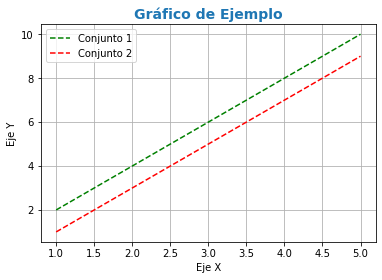

In [11]:
import matplotlib.pyplot as plt
import statistics

def graficar_datos(titulo, etiqueta_x, etiqueta_y, *args):
    """
    Grafica datos dados los parámetros.

    Parameters:
        titulo (str): Título de la gráfica.
        etiqueta_x (str): Etiqueta del eje x.
        etiqueta_y (str): Etiqueta del eje y.
        *args: Cada argumento adicional debe ser una tupla en el formato (datos_x, datos_y, leyenda).
    """
    fig, ax = plt.subplots()

    for datos_x, datos_y, leyenda, estilo in args:
        ax.plot(datos_x, datos_y, estilo, label=leyenda)

    ax.set_title(titulo, fontdict={'fontsize': 14, 'fontweight': 'bold', 'color': 'tab:blue'})
    ax.set_xlabel(etiqueta_x)
    ax.set_ylabel(etiqueta_y)
    ax.legend()

    # Agregar rejilla
    ax.grid(True)

    plt.show()

# Ejemplo de uso
datos_x = [1, 2, 3, 4, 5]
datos_y_1 = [2, 4, 6, 8, 10]
datos_y_2 = [1, 3, 5, 7, 9]
leyenda_1 = "Conjunto 1"
leyenda_2 = "Conjunto 2"

graficar_datos("Gráfico de Ejemplo", "Eje X", "Eje Y", (datos_x, datos_y_1, leyenda_1, '--g'), (datos_x, datos_y_2, leyenda_2, '--r'))


  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

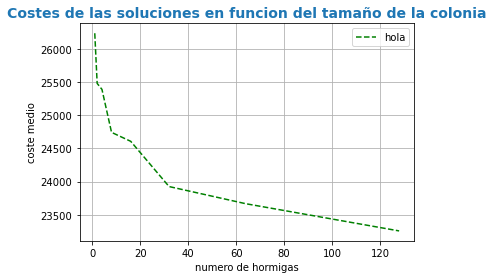

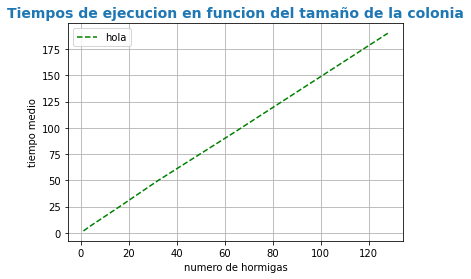

In [89]:
import time

numero_hormigas=[1,2,4,8,16,32,64,128]
sols=[]
costes=[]
tiempos=[]
for i in numero_hormigas:
    c=[]
    t=[]
    for k in range(5):
        start_time = time.time()
        sol = colonia_hormigas(g2, 500, 300, 20, i)
        t.append(time.time() - start_time)
        c.append(sol[1])
    costes.append(statistics.mean(c))
    tiempos.append(statistics.mean(t))

graficar_datos("Costes de las soluciones en funcion del tamaño de la colonia","numero de hormigas", "coste medio",(numero_hormigas, costes, "hola","--g"))
graficar_datos("Tiempos de ejecucion en funcion del tamaño de la colonia","numero de hormigas", "tiempo medio",(numero_hormigas, tiempos, "hola","--g"))

❓ **Pregunta 3**. Ahora realiza un estudio similar variando la probabilidad de explotación q<sub>0</sub> en el rango 0, ..., 0.95 en pasos de 0.05~0.10. ¿Qué valor recomendarías para este parámetro? ¿Por qué?

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

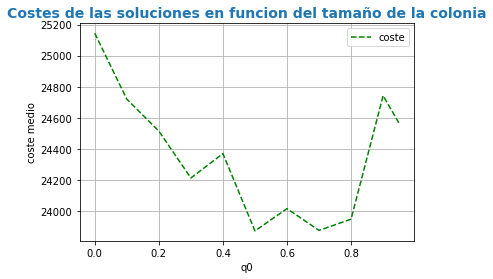

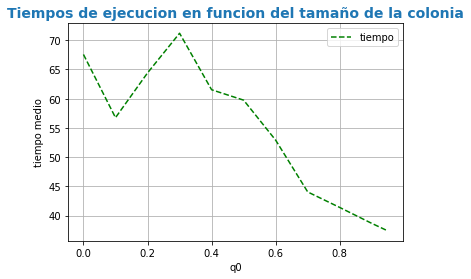

In [103]:
q0_valores = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.95]
sols=[]
costes=[]
tiempos=[]
for i in q0_valores:
    c=[]
    t=[]
    for k in range(10):
        start_time = time.time()
        sol = colonia_hormigas(g2, 500, 300, 20, 32, q0=i)
        t.append(time.time() - start_time)
        c.append(sol[1])
    costes.append(statistics.mean(c))
    tiempos.append(statistics.mean(t))

graficar_datos("Costes de las soluciones en funcion del tamaño de la colonia","q0", "coste medio",(q0_valores, costes, "coste","--g"))
graficar_datos("Tiempos de ejecucion en funcion del tamaño de la colonia","q0", "tiempo medio",(q0_valores, tiempos, "tiempo","--g"))

❓ **Pregunta 4**. Estudia la influencia de pistas de feromonas e información heurística: α=1; β=2, ..., 5. ¿Qué valor de α y β recomendarías? ¿Por qué?

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

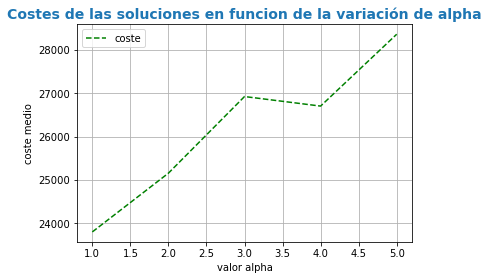

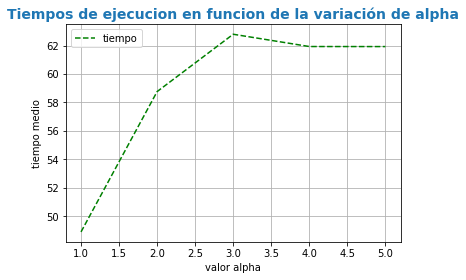

In [104]:
#variacion de alpha
alpha = [1,2,3,4,5]
sols=[]
costes=[]
tiempos=[]
for i in alpha:
    c=[]
    t=[]
    for k in range(10):
        start_time = time.time()
        sol = colonia_hormigas(g2, 500, 300, 20, 32, alpha=i)
        t.append(time.time() - start_time)
        c.append(sol[1])
    costes.append(statistics.mean(c))
    tiempos.append(statistics.mean(t))

graficar_datos("Costes de las soluciones en funcion de la variación de alpha","valor alpha", "coste medio",(alpha, costes, "coste","--g"))
graficar_datos("Tiempos de ejecucion en funcion de la variación de alpha","valor alpha", "tiempo medio",(alpha, tiempos, "tiempo","--g"))

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

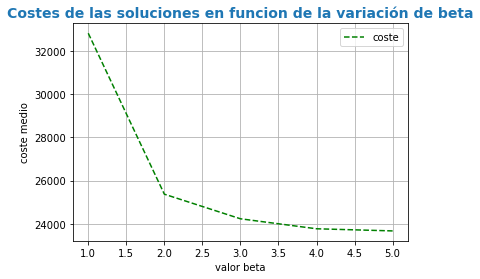

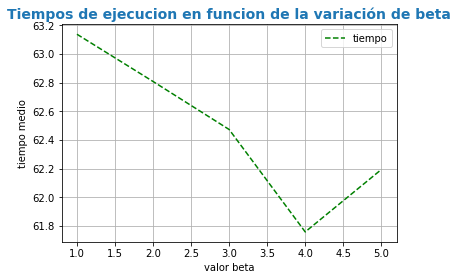

In [105]:
#variacion de beta
beta = [1,2,3,4,5]
sols=[]
costes=[]
tiempos=[]
for i in beta:
    c=[]
    t=[]
    for k in range(10):
        start_time = time.time()
        sol = colonia_hormigas(g2, 500, 300, 20, 32, beta=i)
        t.append(time.time() - start_time)
        c.append(sol[1])
    costes.append(statistics.mean(c))
    tiempos.append(statistics.mean(t))

graficar_datos("Costes de las soluciones en funcion de la variación de beta","valor beta", "coste medio",(beta, costes, "coste","--g"))
graficar_datos("Tiempos de ejecucion en funcion de la variación de beta","valor beta", "tiempo medio",(beta, tiempos, "tiempo","--g"))

❓ **Pregunta 5**. Finalmente, argumenta de manera crítica las diferencias y similitudes con la metaheurísticas vistas hasta el momento en las interactivas/prácticas anteriores. Discute críticamente acerca de las bondades y limitaciones de las técnicas. Por ejemplo: ¿Eres capaz de resolver instancias de diferente tamaño? ¿Con cuál estás obteniendo mejores soluciones? ¿Cuál parece tener más limitaciones en términos de tiempo de ejecución necesario? ¿Te quedarías con una de las Metaheurísticas en vista de los resultados obtenidos? ¿Cuál/es y por qué?

Ejecuciones:   0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

  0%|          | 0/500 [00:00<?, ?it/s]

COSTES POR EJECUCION


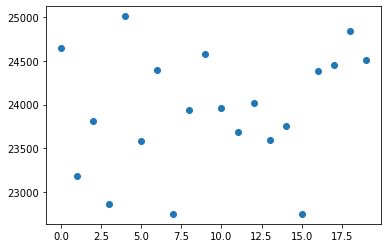

Media de coste_soluciones: 23935.47458303952
Desviación típica de coste_soluciones: 677.5226764151668


In [16]:
import matplotlib.pyplot as plt
import statistics

costes=[]
for i in tqdm(range(20), desc='Ejecuciones'):
    sol=colonia_hormigas(g2, 500, 300, 20, 32, q0=0.8, alpha=1, beta=4)
    costes.append(sol[1])
print("COSTES POR EJECUCION")
fig, ax = plt.subplots()
ax.scatter([x for x in range (0,len(costes))], costes)
plt.show()
print("Media de coste_soluciones:", statistics.mean(costes))
print("Desviación típica de coste_soluciones:", statistics.stdev(costes))

In [17]:
print(costes)

[24642.937935966384, 23189.506019071425, 23807.133310954934, 22865.769997992815, 25007.229078083983, 23589.26025299219, 24390.244535517886, 22752.045763057766, 23940.13340034913, 24579.987281677833, 23966.007692895597, 23687.060541126986, 24013.141535439085, 23599.829729316116, 23750.94083033242, 22753.444216617678, 24379.1982130188, 24452.228608941918, 24833.21959418441, 24510.173123253044]



#### Respuestas y evaluación

Recordatorio: No olvides escribir tu nombre y apellidos en la segunda celda de este documento.
La respuestas a las preguntas deben venir acompañadas de las implementaciones necesarias para su respuesta.

*P4.1: Implementación básica* (5 puntos)

La implementación básica se evaluará mediante un cuestionario automático de evaluación. Este lo realizarás en la primera sesión tras la entrega, y se centrará en la resolución por tu parte de diversas cuestiones prácticas relacionadas con la implementación realizada, pudiendo ser necesaria la ejecución, adaptación y modificación de la misma.

Pregunta 1. 

Independientemente del cuestionario automático de evaluación, considera siempre que las preguntas planteadas en el notebook deben ser respondidas también. Esas preguntas generales están diseñadas para formarte, y te servián para razonar y reflexionar sobre el tema, así como también para fomentar una discusión constructiva con los docentes en caso de dudas.

*P4.2: Laboratorio* (5 puntos)

El informe a elaborar no debe exceder la longitud máxima de 1200 palabras.

Aclaraciones: La evaluación de esta parte se llevará a cabo en términos de la completitud y correctitud del laboratorio implementado, así como de la calidad del propio informe, que debe ser conciso y preciso, pudiendo acompañarse de gráficas y tablas que faciliten y fundamenten la explicación e argumentación. Es muy importante explicar de manera clara, precisa y fundamentada. Se reservará hasta un punto que se asignará en términos de la calidad de la mejor solución obtenida entre el conjunto de las prácticas entregadas (es por ello que no debes olvidar marcar en tu informe muy claramente cuál ha sido tu mejor solución y con qué configuración/versión).

Pregunta 2

En estas 2 gráficas podemos observar los resultados tras ejecutar 5 veces cada numero de hormigas.Podemos observar como a partir de 32 hormigas, el coste sigue mejorando pero a un ritmo mucho menor, la mejora disminuye en una medida menor. Por otro lado los tiempos siguen una tendencia lineal. Es por esto que si buscasemos resultados óptimos eligiríamos el mayor numero de hormigas posible, como podía ser 120, pero en este caso, que queremos buscar un equilibrio, y es por eso que como a partir de 32 la mejora disminuye, y los tiempos, aunque lineales, al tratarse del doble de hormigas, se multiplican por 2 los tiempos y no resulta eficiente. **Es por eso que nos quedamos con las 32 hormigas como valor óptimo.**

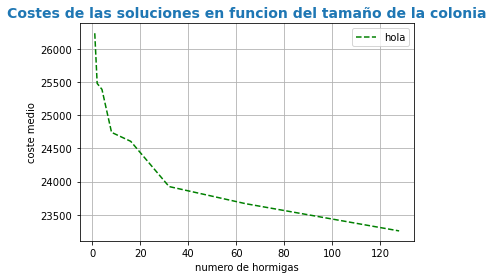
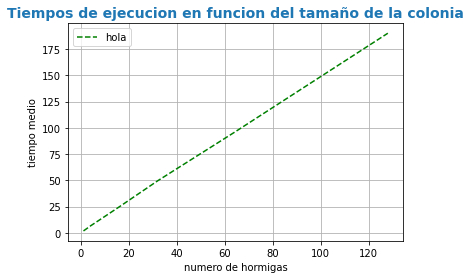


Pregunta 3

Hicimos pruebas con 5 repeticiones y no daba resultados muy útiles, así que lo repetimos para 10 iteraciones.  Observamos como hay una tendencia a que cuanto mayor sea el valor de q0, menos tiempo consume. Por otro lado, los resultados óptimos de coste lso obtenemos con 0.5 y 0.8, pero al tener un tiempo mucho menor 0.8 pues nos quedamos con este valor. En conclusión, **el valor para q0 óptimo es 0.8.**

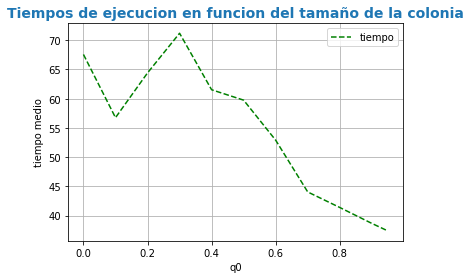
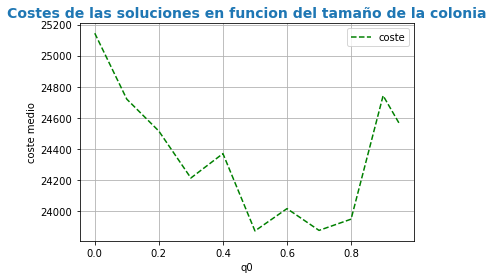

Pregunta 4

Podemos observar claramente como los tiempos y el coste empeoran según aumenta el valor de alpha, es por ello que queda como **valor óptimo de alpha 1.**

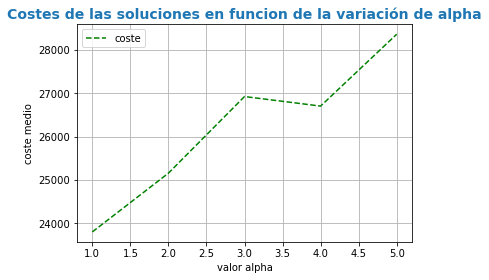
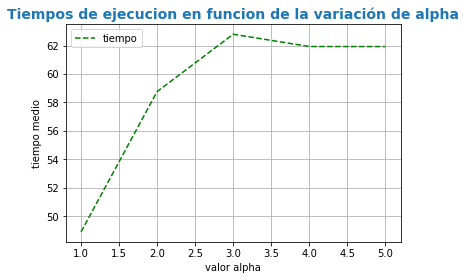

Podemos observar como cuanto mayor es el valor de beta disminuyen los costes. De la misma manera en tiempos va disminuyendo hasta llegar a 4 que a continuación crece. Es por esto que seleccionamos como **mejor valor para beta el 4.**
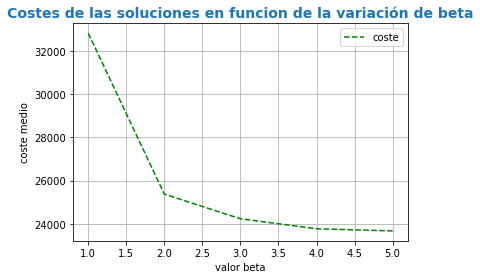
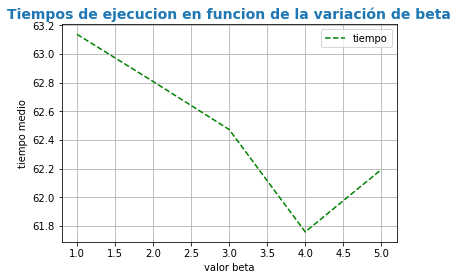

Pregunta 5

Para comparar los diferentes algoritmos entre sí, nos fijaremos primero en el coste y tiempo de los resultados obtenidos para los algoritmos ya optimizados:

    -Temple simulado:       373.54s , 37424.16
    -Búsqueda Tabú:         728.71s , 28450.42
    -Algoritmo genético:    389.63s , 35753.13
    -Algortimo de hormigas:  41.03s , 23935.47
    
Con estos datos podemos observar como en tiempo la mejor opción con mucha diferencia es el elgoritmo de hormigas, tanto en tiempo como en coste. La segunda mejor opción en coste es busqueda tabú pero podemos observar su gran limitación es el tiempo, que vuelve inutilizable este algoritmo para el problema. Luego temple simulado y el algoritmo genético, tienen costes peores, pero mucho mejores tiempos que tabú, permiten el uso de estos algoritmos por tiempo, pero tienen mucho peor coste que hormigas.

Es por lo expuesto anteriormente, que claramente el mejor algoritmo en resultados y tiempos es el algoritmo de hormigas.
    